/ssd/users/kevin/conda/test_SNPmanifold/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


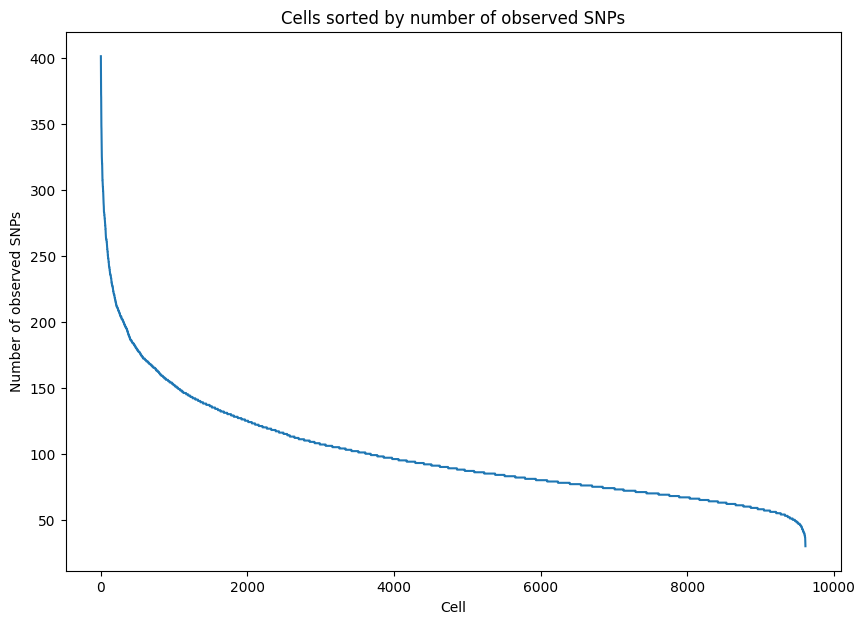

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


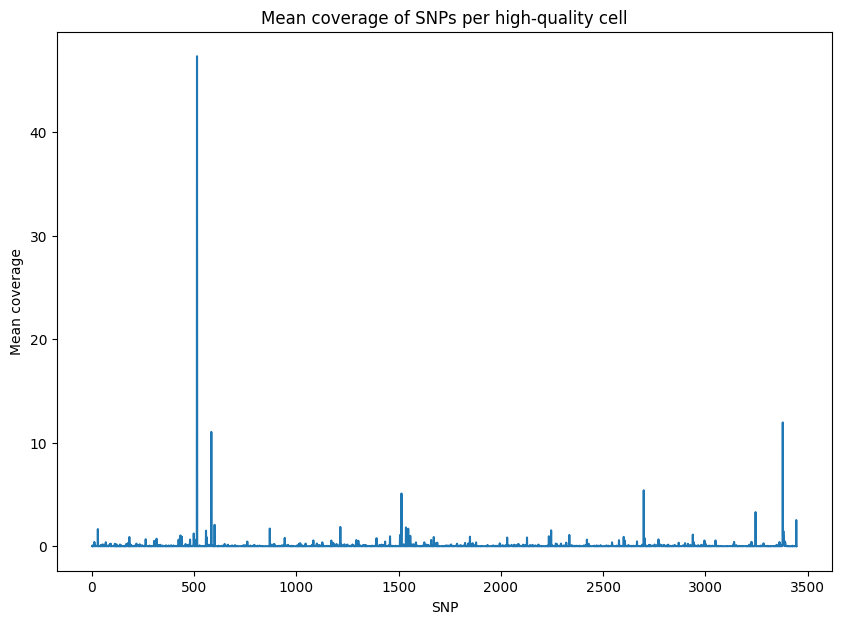

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


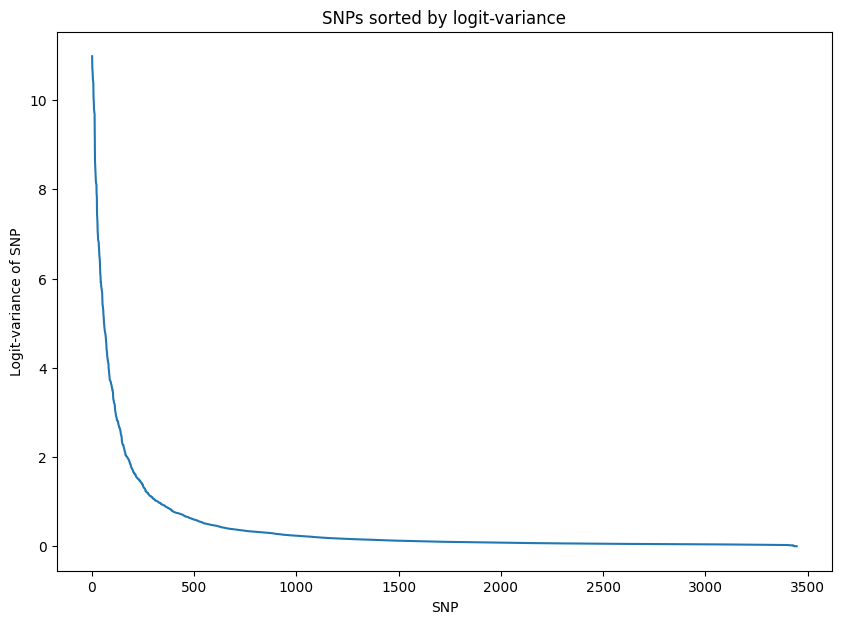

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.100257
Epoch[20/2000], Cost: 0.914415
Epoch[30/2000], Cost: 0.807683
Epoch[40/2000], Cost: 0.732866
Epoch[50/2000], Cost: 0.677650
Epoch[60/2000], Cost: 0.635915
Epoch[70/2000], Cost: 0.601618
Epoch[80/2000], Cost: 0.574287
Epoch[90/2000], Cost: 0.550701
Epoch[100/2000], Cost: 0.530390
Epoch[200/2000], Cost: 0.417994
Epoch[300/2000], Cost: 0.375534
Epoch[400/2000], Cost: 0.357062
Epoch[500/2000], Cost: 0.348121
Epoch[600/2000], Cost: 0.343457
Epoch[700/2000], Cost: 0.340722
Epoch[800/2000], Cost: 0.339105
Epoch[900/2000], Cost: 0.338097
Epoch[1000/2000], Cost: 0.337420
Epoch[1100/2000], Cost: 0.336996
Epoch[1200/2000], Cost: 0.336697
Epoch[1300/2000], Cost: 0.336425
Epoch[1400/2000], Cost: 0.336264
Epoch[1500/2000], Cost: 0.336145
Epoch[1600/200

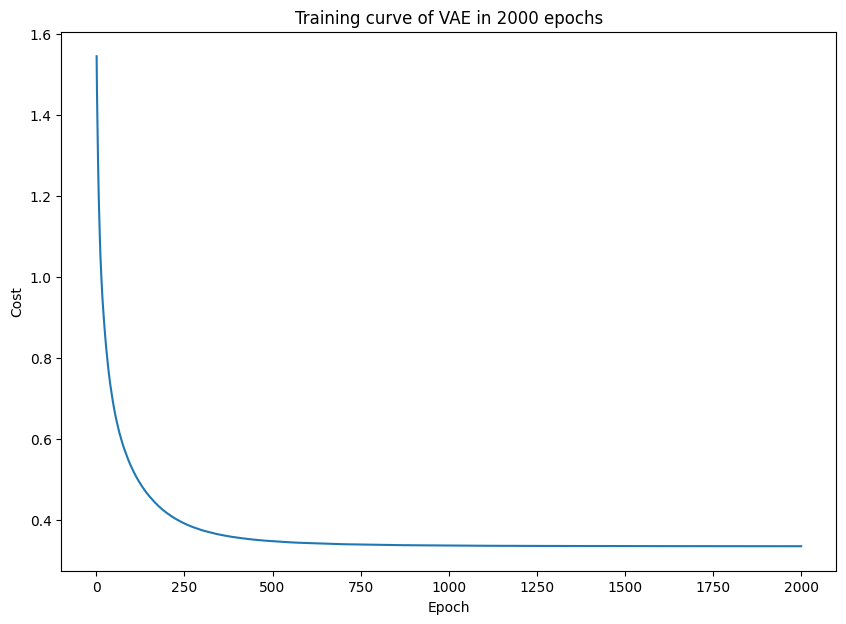

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


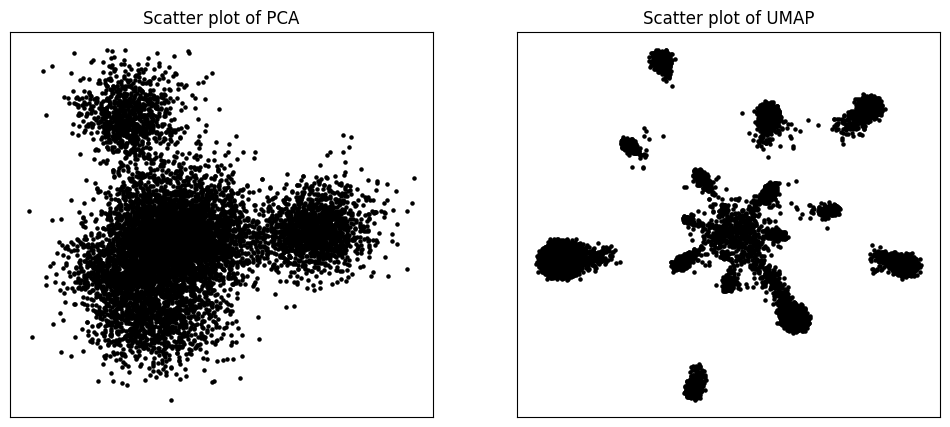

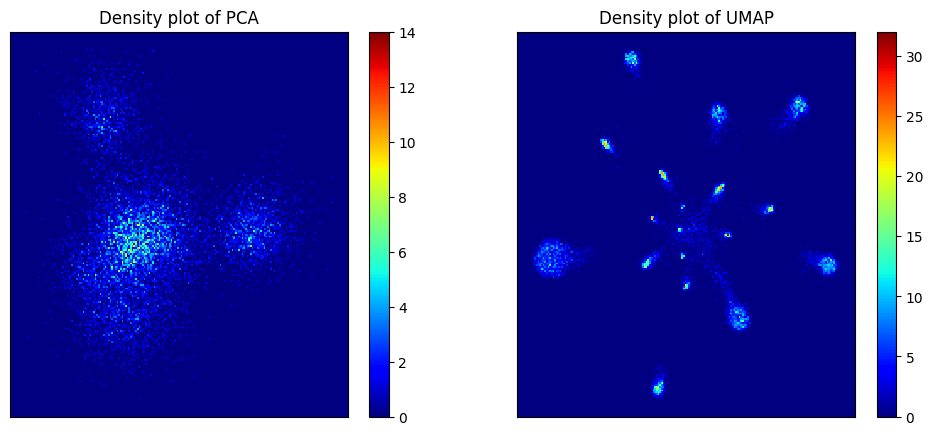

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


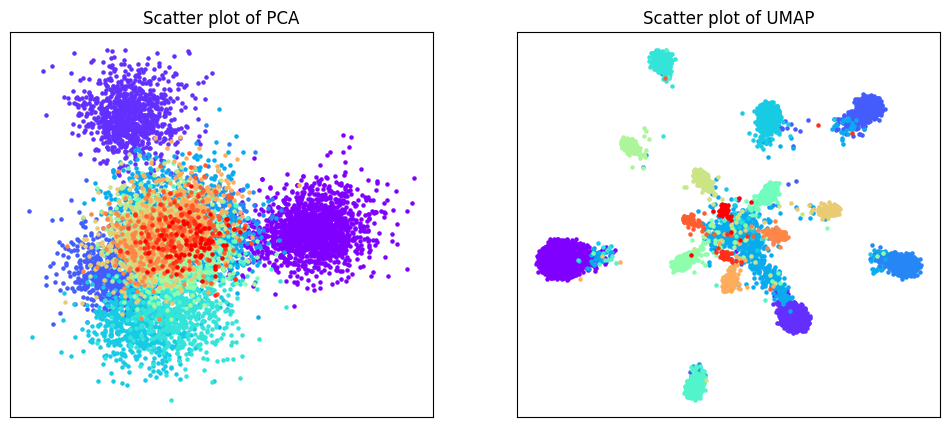

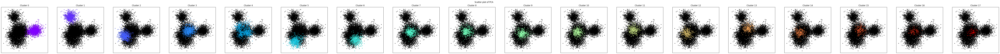

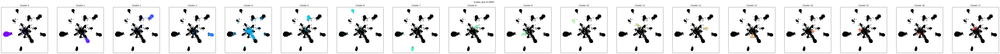

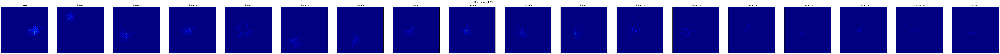

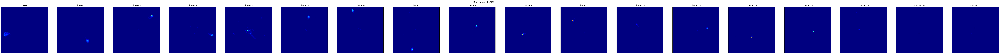

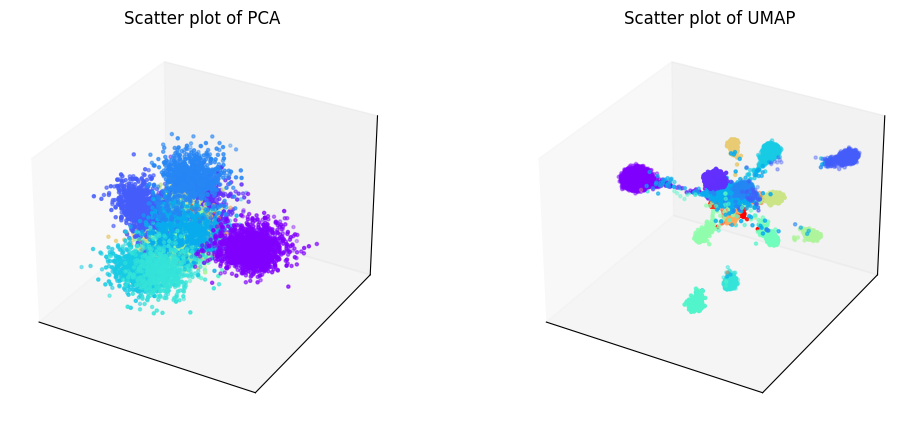

Phylogenetic tree in latent space will be shown below.


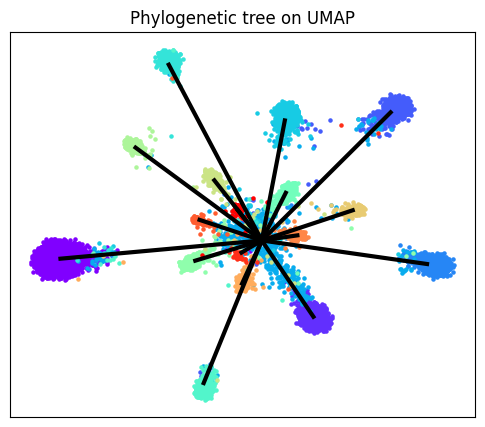

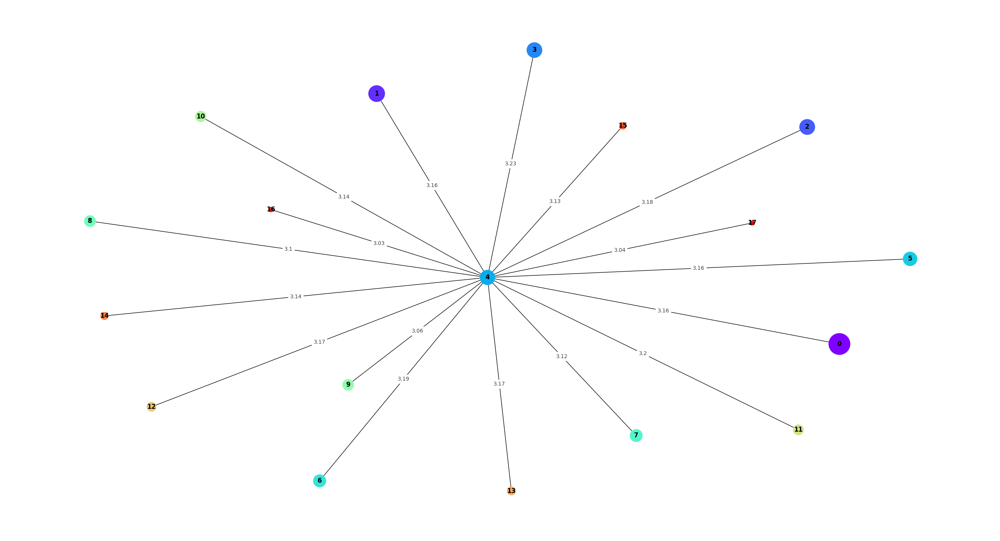

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


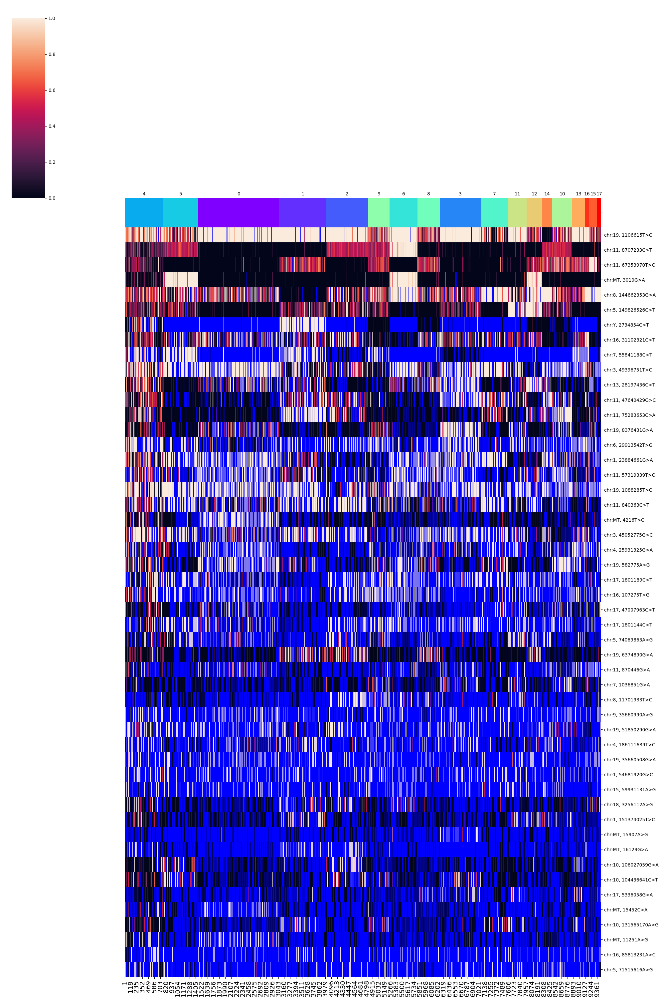

SNPs sorted by lowest p-value will be shown below


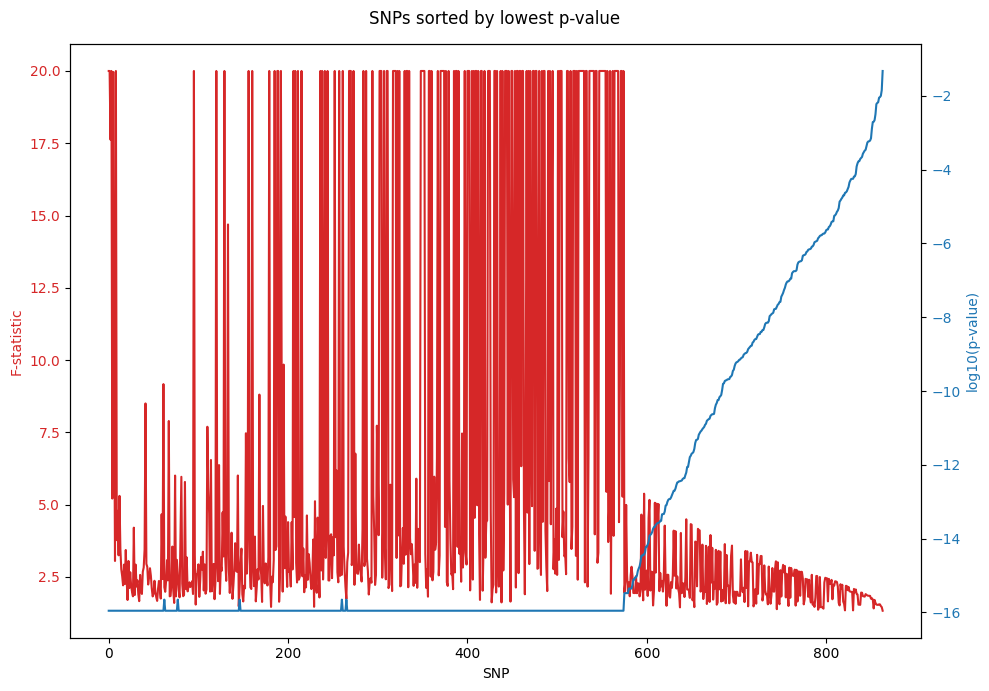

In [1]:
import torch
torch.set_default_device('cuda')
torch.cuda.set_device('cuda:7')

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

normalized_layer1 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
normalized_layer1.filtering()
normalized_layer1.training()
normalized_layer1.clustering(algorithm = "leiden_full")
normalized_layer1.phylogeny()

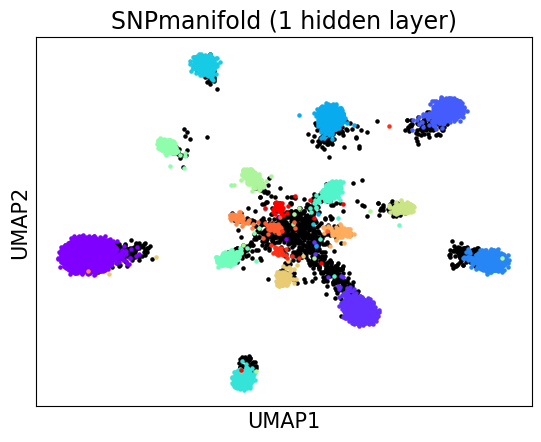

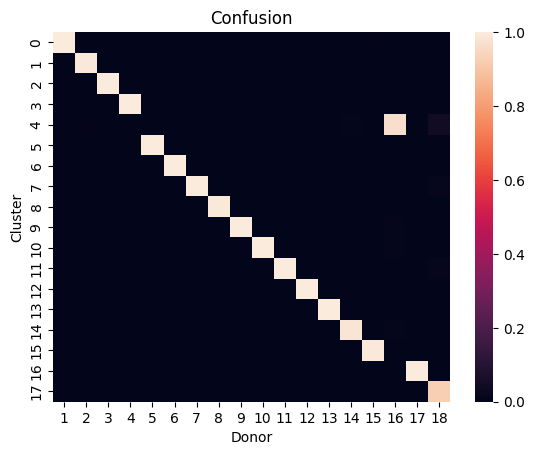

accuracy: 99.0940686215139
silhouette score: 0.8442838635092821


In [2]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(normalized_layer1.embedding_2d[donors[18], 0], normalized_layer1.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(normalized_layer1.embedding_2d[donors[w], 0], normalized_layer1.embedding_2d[donors[w], 1], s = 5, color = normalized_layer1.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = normalized_layer1.assigned_label
    
matrix = np.zeros((18, 18))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(normalized_layer1.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


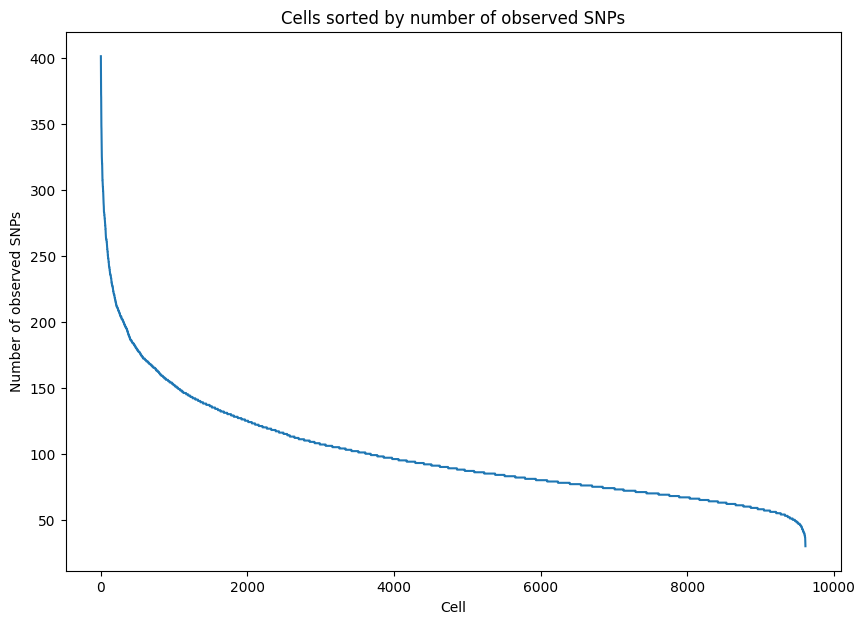

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


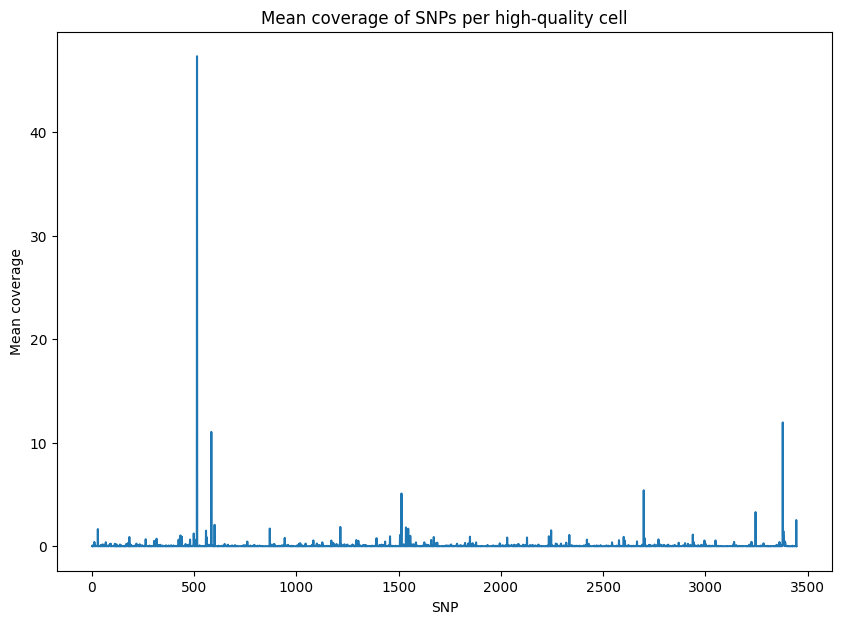

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


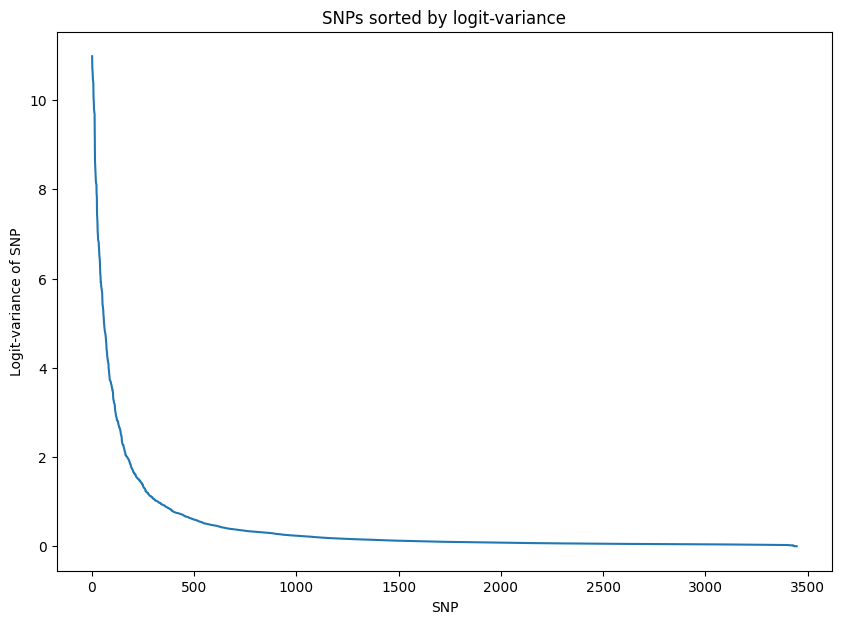

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.080307
Epoch[20/2000], Cost: 0.921577
Epoch[30/2000], Cost: 0.790238
Epoch[40/2000], Cost: 0.716470
Epoch[50/2000], Cost: 0.667611
Epoch[60/2000], Cost: 0.632010
Epoch[70/2000], Cost: 0.602595
Epoch[80/2000], Cost: 0.576659
Epoch[90/2000], Cost: 0.554035
Epoch[100/2000], Cost: 0.534082
Epoch[200/2000], Cost: 0.420984
Epoch[300/2000], Cost: 0.377011
Epoch[400/2000], Cost: 0.358200
Epoch[500/2000], Cost: 0.345454
Epoch[600/2000], Cost: 0.339897
Epoch[700/2000], Cost: 0.339008
Epoch[800/2000], Cost: 0.334133
Epoch[900/2000], Cost: 0.333015
Epoch[1000/2000], Cost: 0.333593
Epoch[1100/2000], Cost: 0.331476
Epoch[1200/2000], Cost: 0.331258
Epoch[1300/2000], Cost: 0.330702
Epoch[1400/2000], Cost: 0.330764
Epoch[1500/2000], Cost: 0.330403
Epoch[1600/200

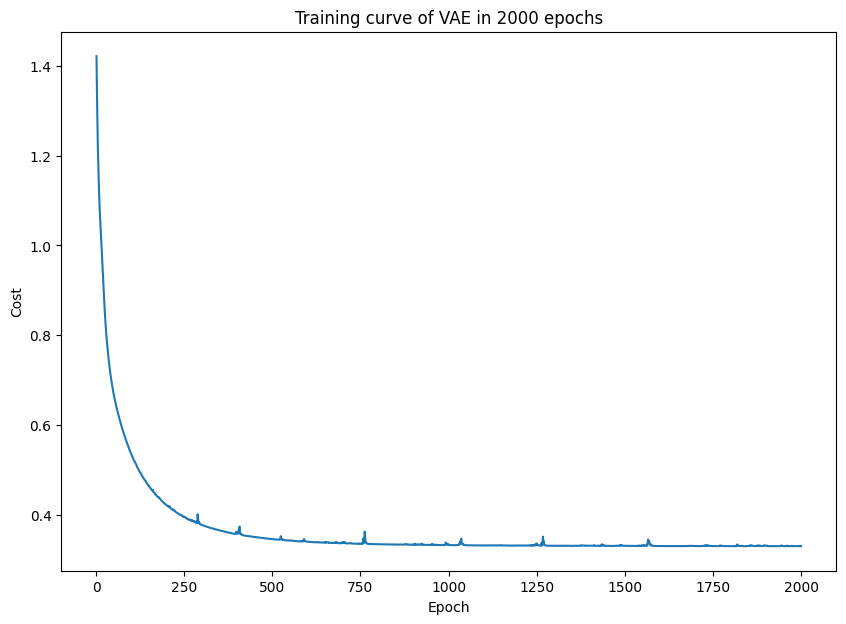

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


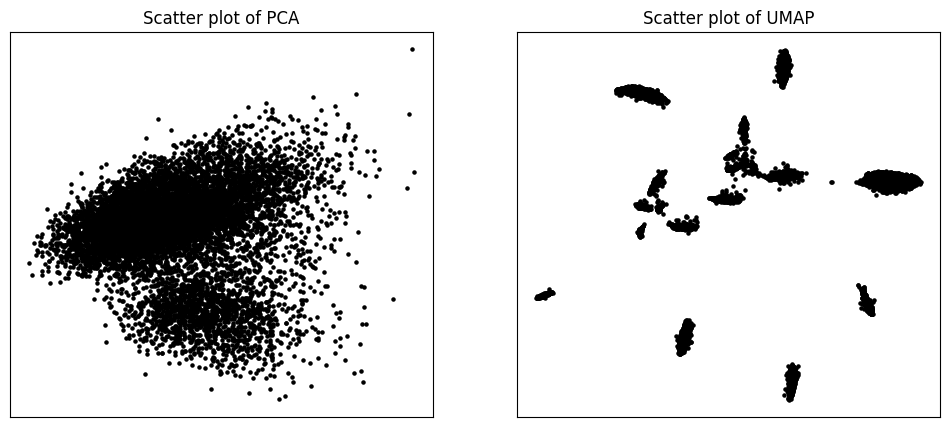

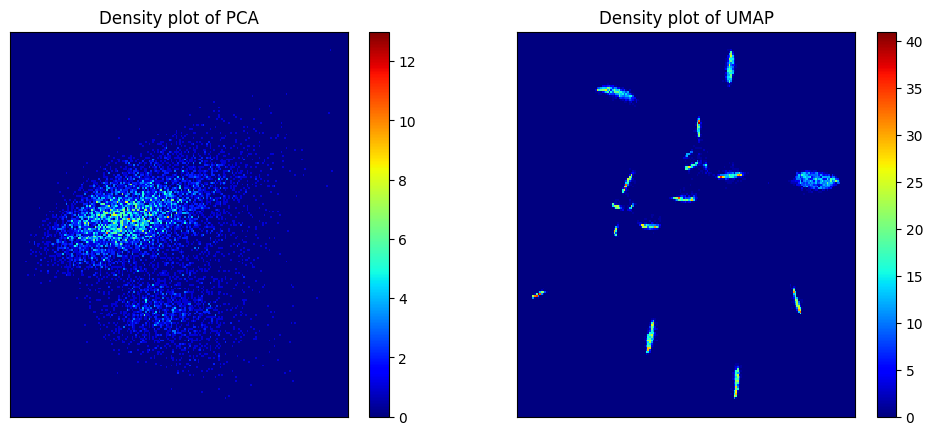

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


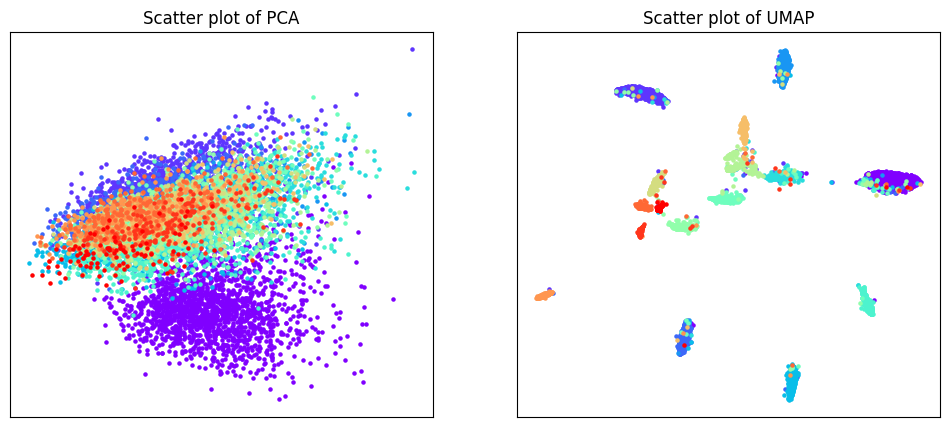

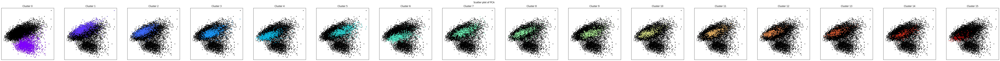

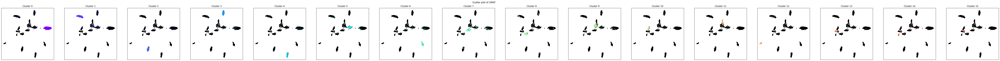

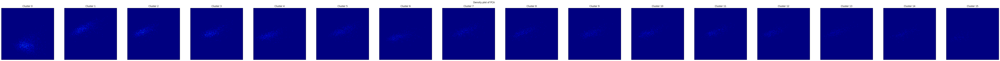

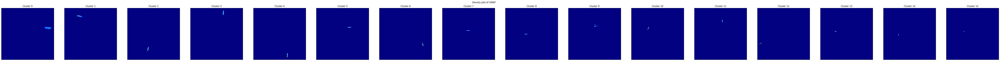

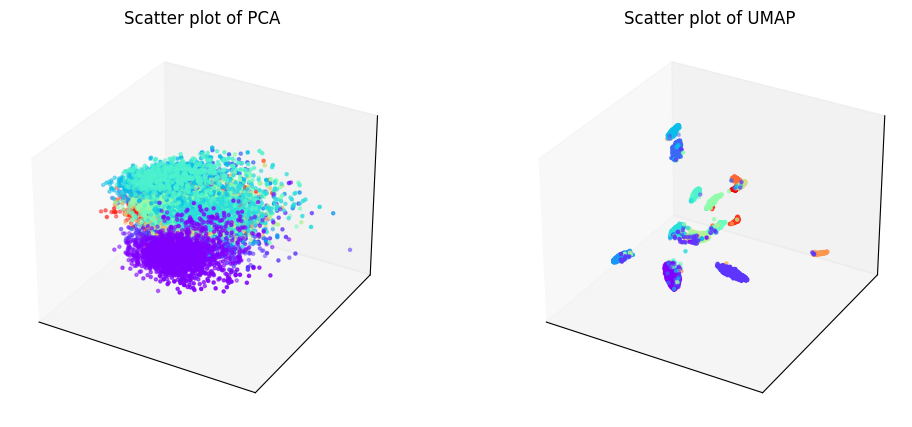

Phylogenetic tree in latent space will be shown below.


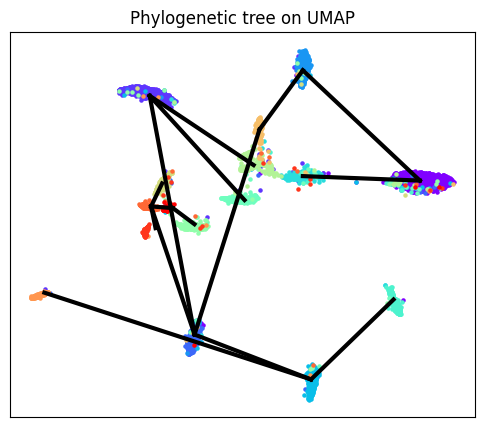

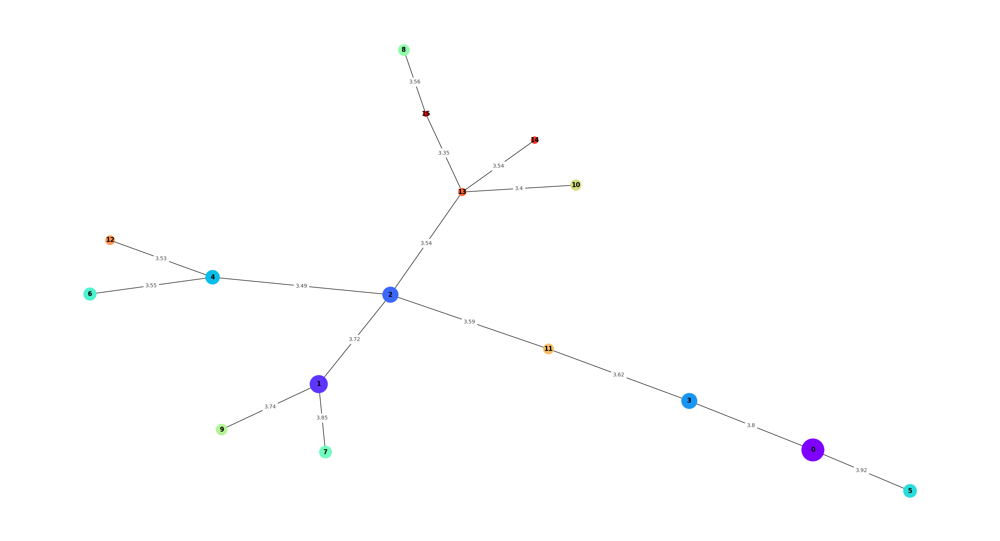

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


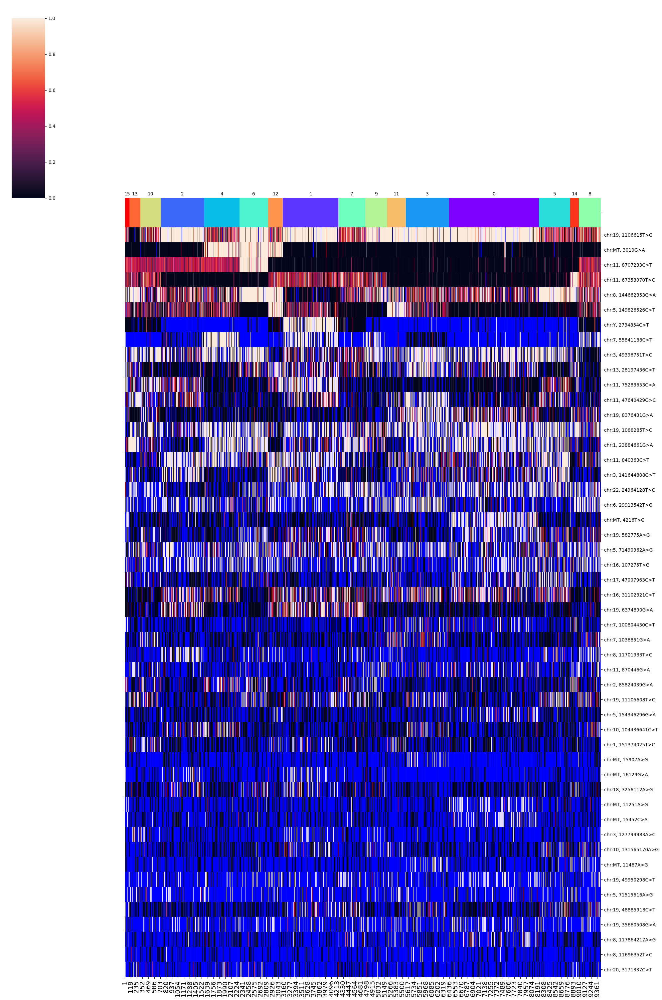

SNPs sorted by lowest p-value will be shown below


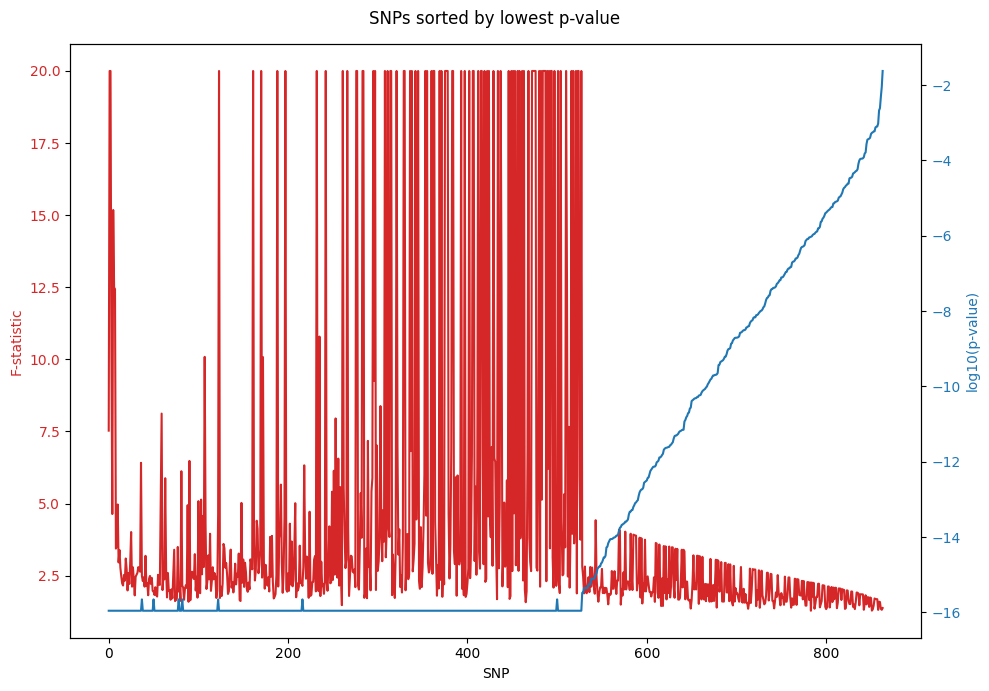

In [3]:
del normalized_layer1

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-layer3_updated.ipynb

unnormalized_layer3 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18", SNPread = "unnormalized")
unnormalized_layer3.filtering()
unnormalized_layer3.training()
unnormalized_layer3.clustering(algorithm = "leiden_full")
unnormalized_layer3.phylogeny()

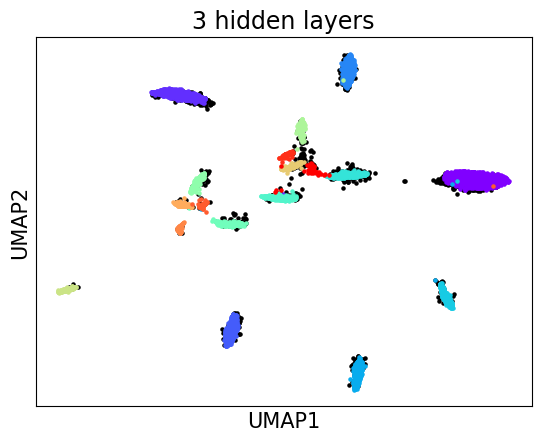

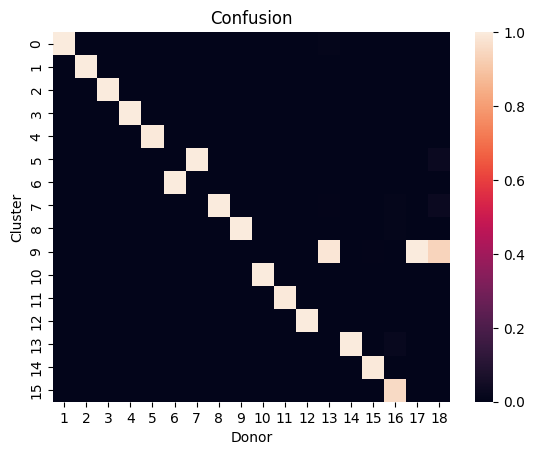

accuracy: 99.17562551756602
silhouette score: 0.8186045527413344


In [4]:
unnormalized_layer3_embedding_2d = unnormalized_layer3.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[unnormalized_layer3.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[unnormalized_layer3.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(unnormalized_layer3.embedding_2d[donors[18], 0], unnormalized_layer3.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(unnormalized_layer3.embedding_2d[donors[w], 0], unnormalized_layer3.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("3 hidden layers", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = unnormalized_layer3.assigned_label
    
matrix = np.zeros((18, unnormalized_layer3.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(unnormalized_layer3.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(unnormalized_layer3.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized_layer3.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


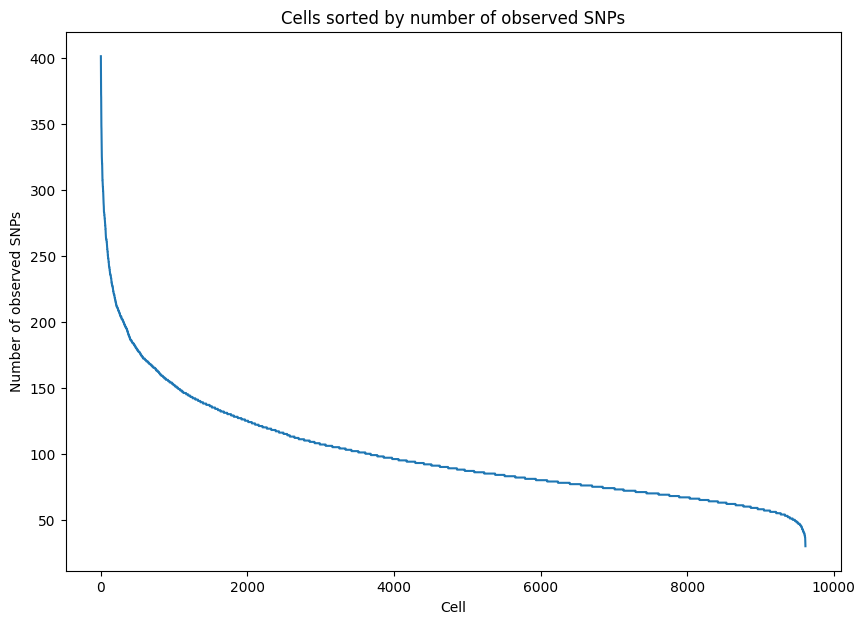

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


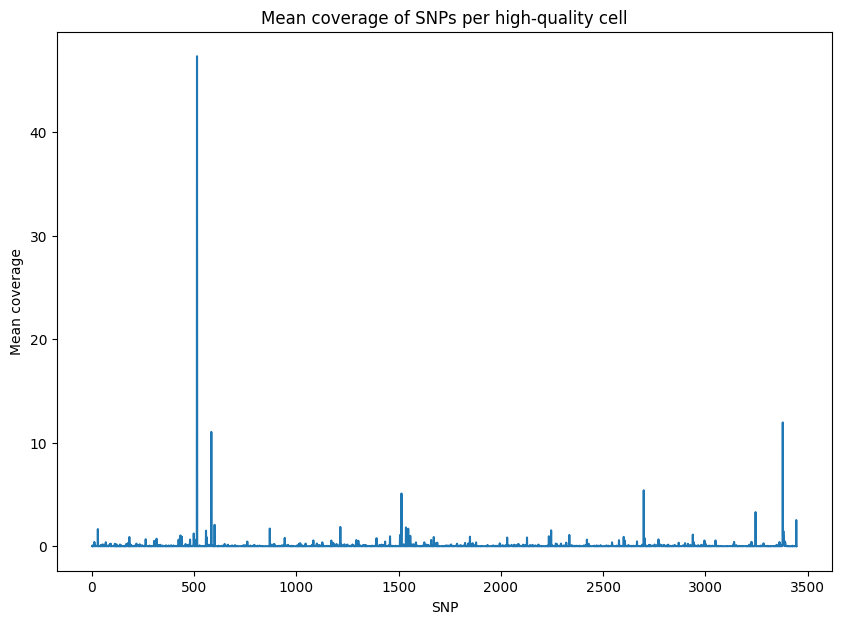

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


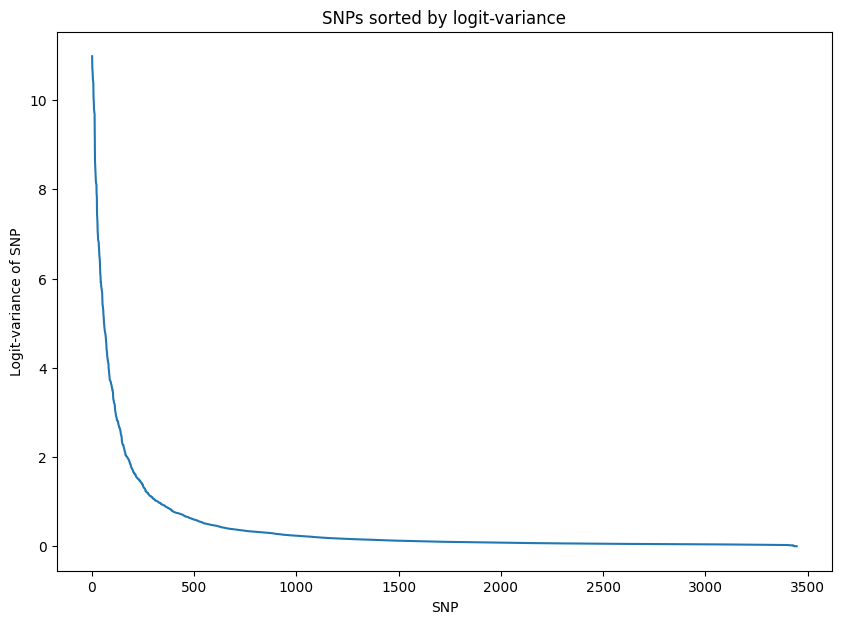

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.124320
Epoch[20/2000], Cost: 0.985029
Epoch[30/2000], Cost: 0.843699
Epoch[40/2000], Cost: 0.758137
Epoch[50/2000], Cost: 0.716320
Epoch[60/2000], Cost: 0.688502
Epoch[70/2000], Cost: 0.665524
Epoch[80/2000], Cost: 0.648037
Epoch[90/2000], Cost: 0.634399
Epoch[100/2000], Cost: 0.623012
Epoch[200/2000], Cost: 0.525025
Epoch[300/2000], Cost: 0.455428
Epoch[400/2000], Cost: 0.410908
Epoch[500/2000], Cost: 0.377855
Epoch[600/2000], Cost: 0.359278
Epoch[700/2000], Cost: 0.347339
Epoch[800/2000], Cost: 0.339792
Epoch[900/2000], Cost: 0.336570
Epoch[1000/2000], Cost: 0.334302
Epoch[1100/2000], Cost: 0.334274
Epoch[1200/2000], Cost: 0.333451
Epoch[1300/2000], Cost: 0.331993
Epoch[1400/2000], Cost: 0.337150
Epoch[1500/2000], Cost: 0.330966
Epoch[1600/200

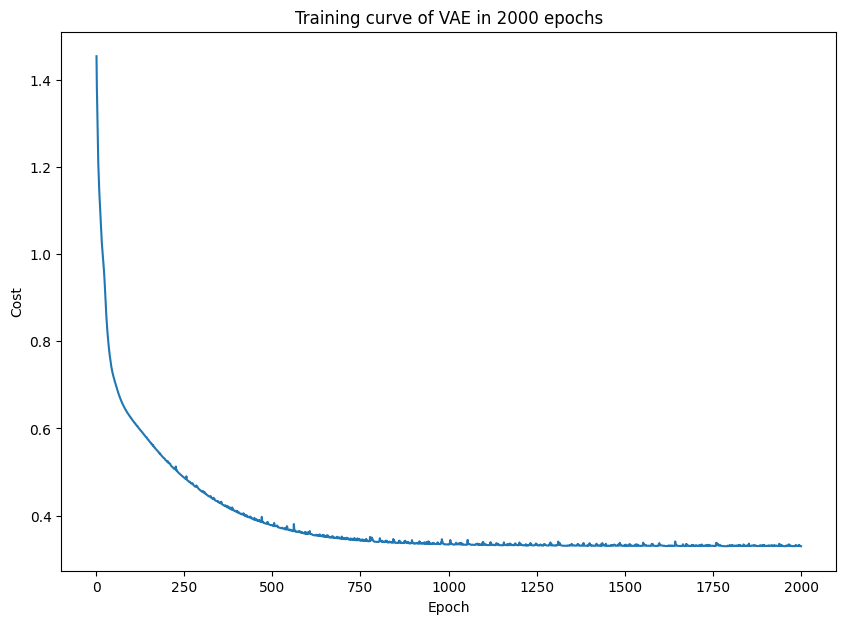

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


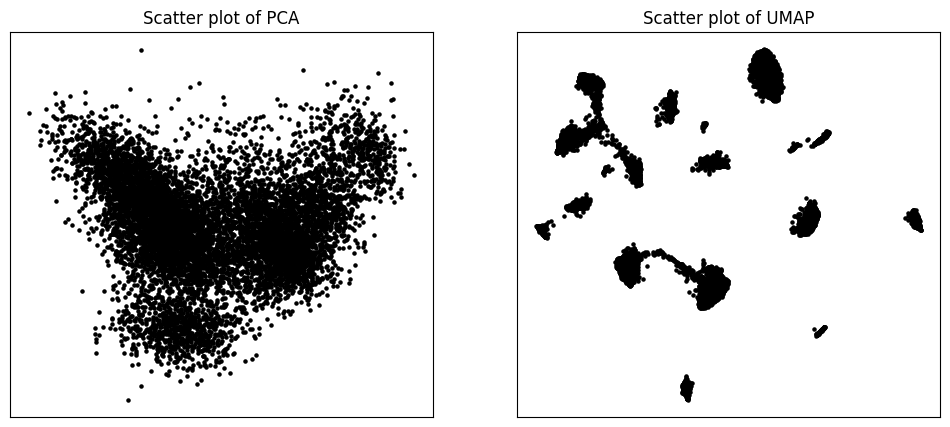

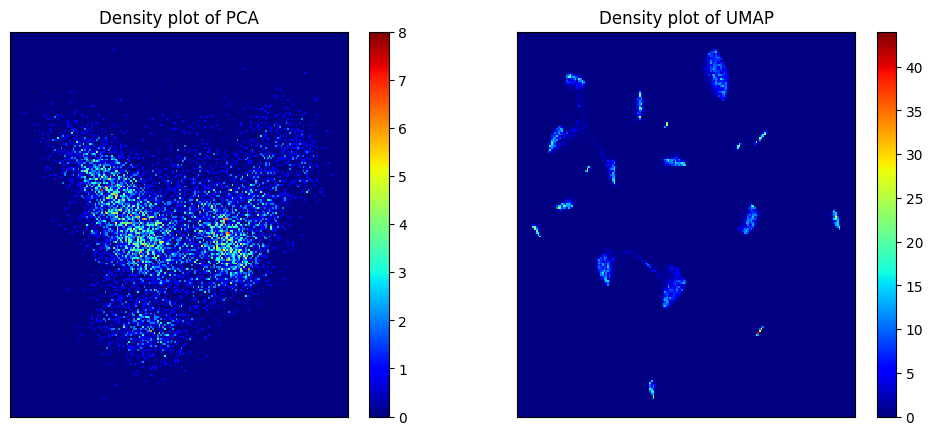

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


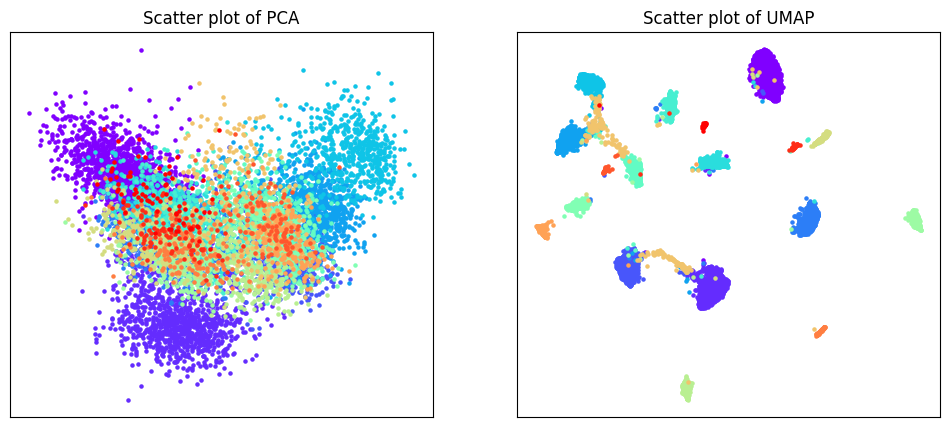

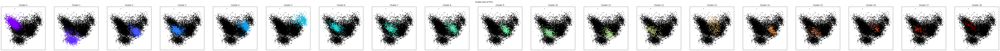

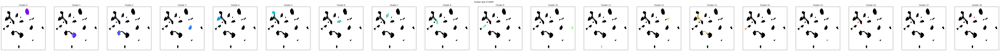

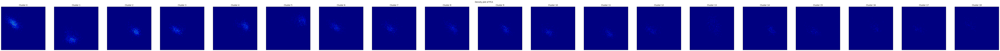

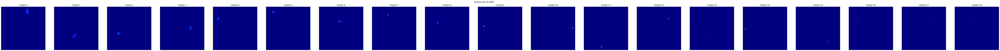

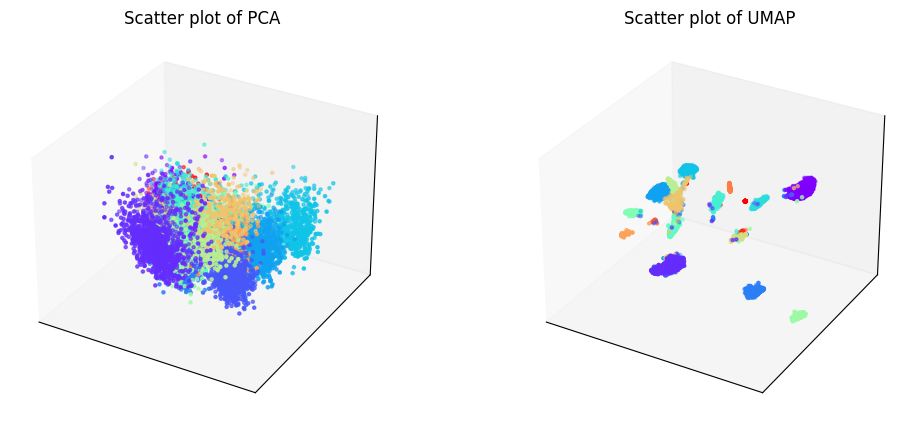

Phylogenetic tree in latent space will be shown below.


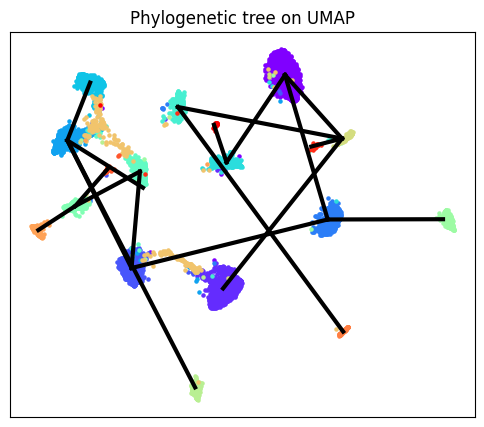

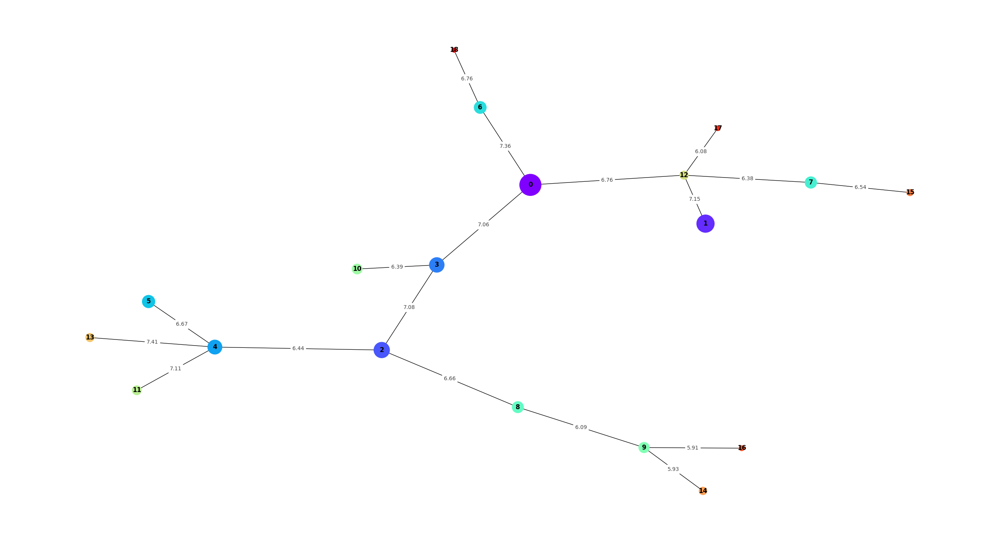

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


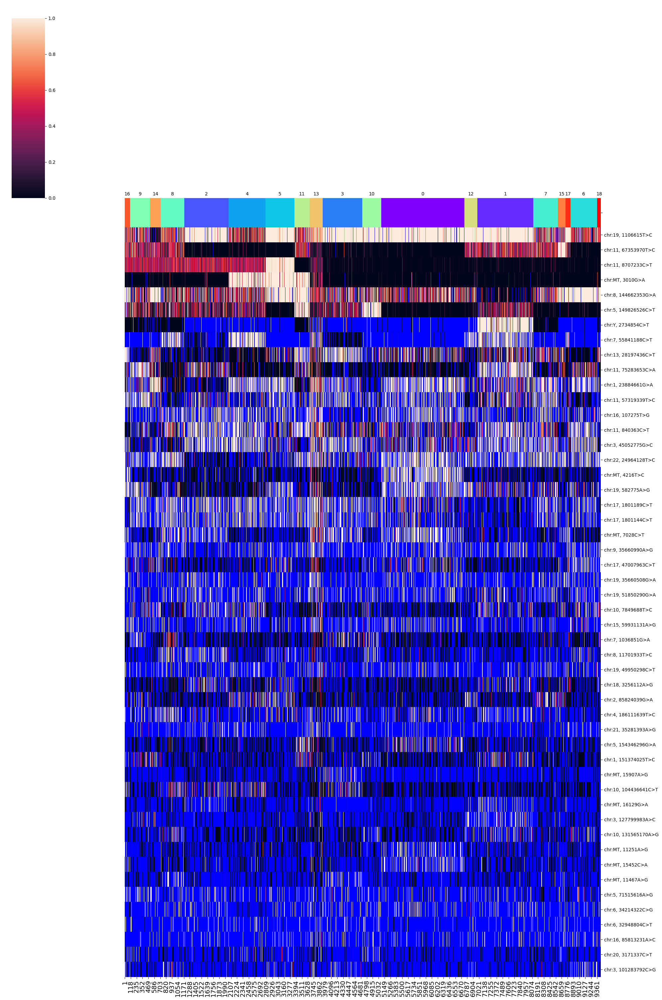

SNPs sorted by lowest p-value will be shown below


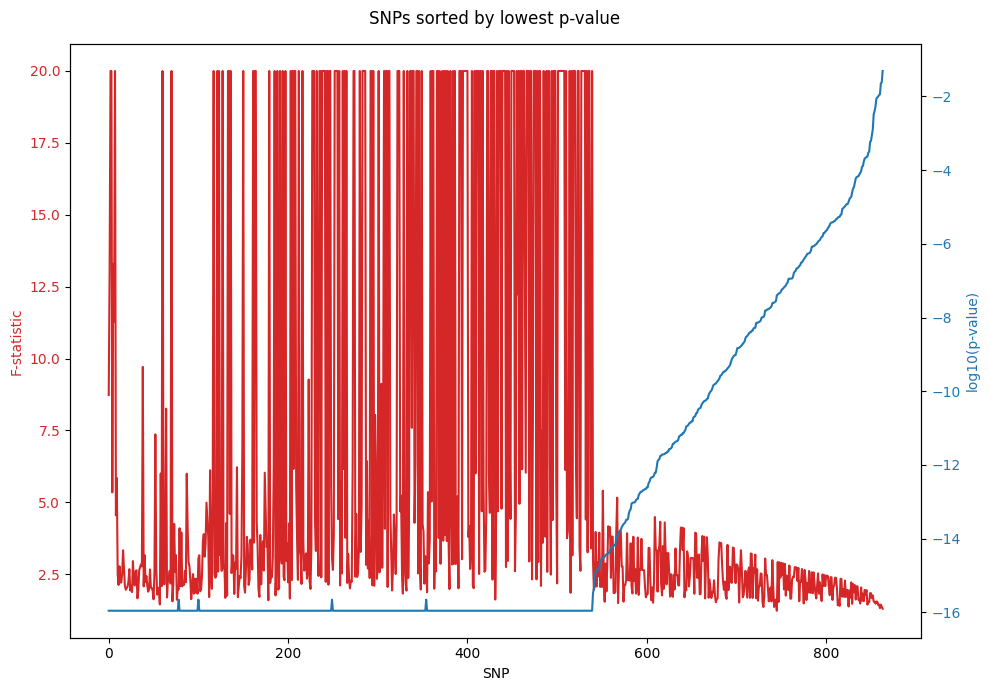

In [5]:
del unnormalized_layer3

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-layer5_updated.ipynb

unnormalized_layer5 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18", SNPread = "unnormalized")
unnormalized_layer5.filtering()
unnormalized_layer5.training()
unnormalized_layer5.clustering(algorithm = "leiden_full")
unnormalized_layer5.phylogeny()

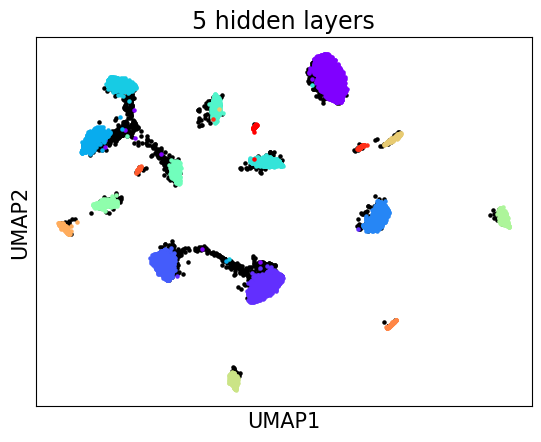

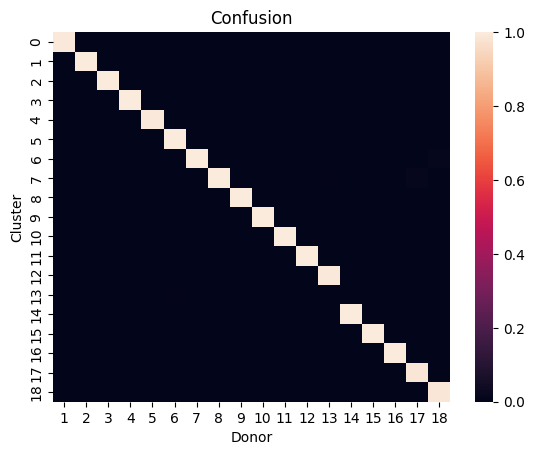

accuracy: 99.69653483332279
silhouette score: 0.8470981852477216


In [6]:
unnormalized_layer5_embedding_2d = unnormalized_layer5.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[unnormalized_layer5.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[unnormalized_layer5.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(unnormalized_layer5.embedding_2d[donors[18], 0], unnormalized_layer5.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(unnormalized_layer5.embedding_2d[donors[w], 0], unnormalized_layer5.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("5 hidden layers", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = unnormalized_layer5.assigned_label
    
matrix = np.zeros((18, unnormalized_layer5.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(unnormalized_layer5.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(unnormalized_layer5.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized_layer5.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


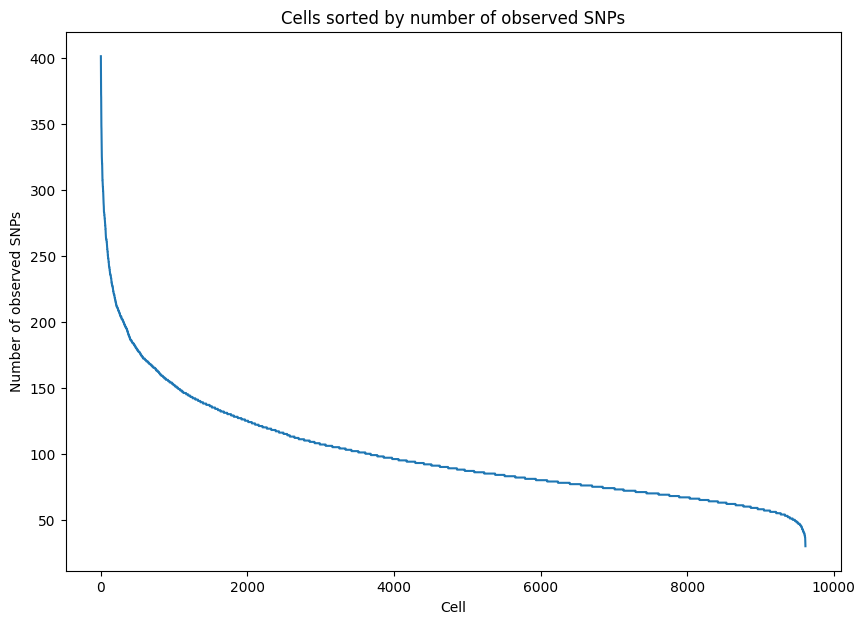

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


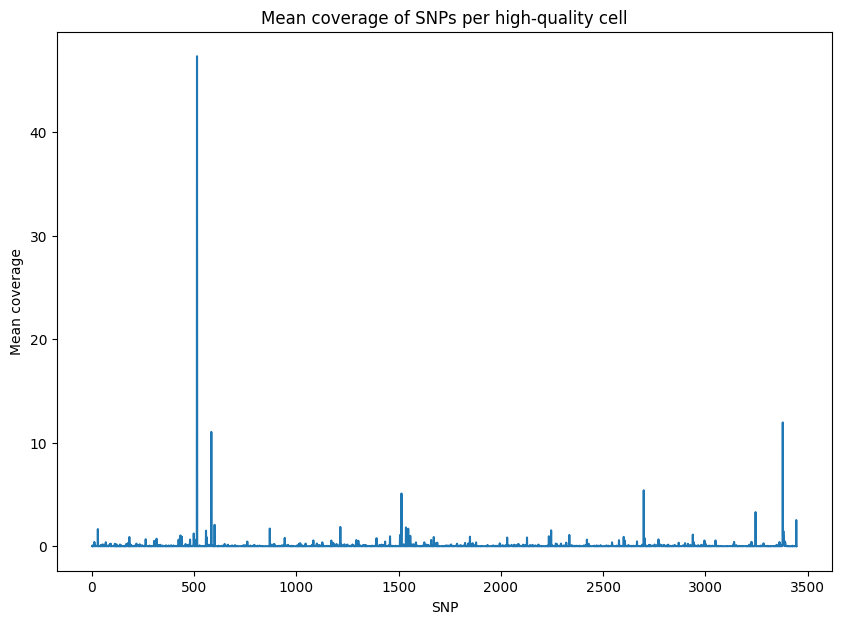

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


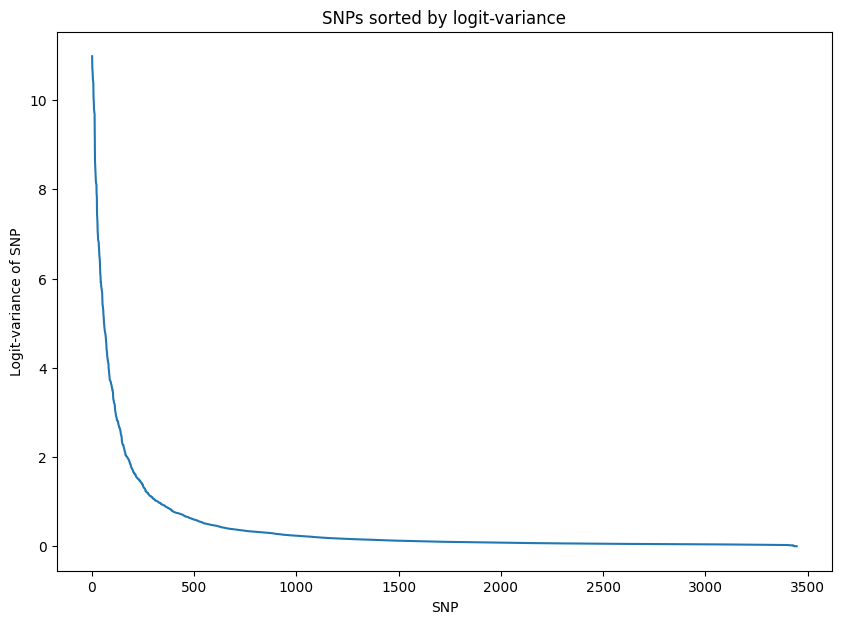

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.376607
Epoch[20/2000], Cost: 1.223060
Epoch[30/2000], Cost: 1.119455
Epoch[40/2000], Cost: 1.046241
Epoch[50/2000], Cost: 0.990886
Epoch[60/2000], Cost: 0.947130
Epoch[70/2000], Cost: 0.913307
Epoch[80/2000], Cost: 0.886538
Epoch[90/2000], Cost: 0.864858
Epoch[100/2000], Cost: 0.847579
Epoch[200/2000], Cost: 0.763883
Epoch[300/2000], Cost: 0.718807
Epoch[400/2000], Cost: 0.689607
Epoch[500/2000], Cost: 0.673737
Epoch[600/2000], Cost: 0.663716
Epoch[700/2000], Cost: 0.656588
Epoch[800/2000], Cost: 0.650701
Epoch[900/2000], Cost: 0.645589
Epoch[1000/2000], Cost: 0.640723
Epoch[1100/2000], Cost: 0.636373
Epoch[1200/2000], Cost: 0.632592
Epoch[1300/2000], Cost: 0.628610
Epoch[1400/2000], Cost: 0.625201
Epoch[1500/2000], Cost: 0.621948
Epoch[1600/200

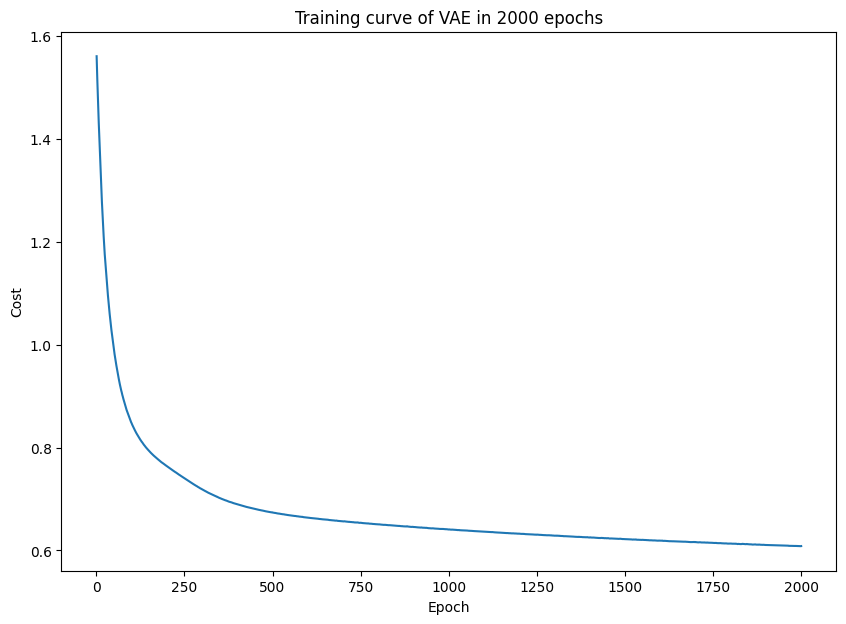

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


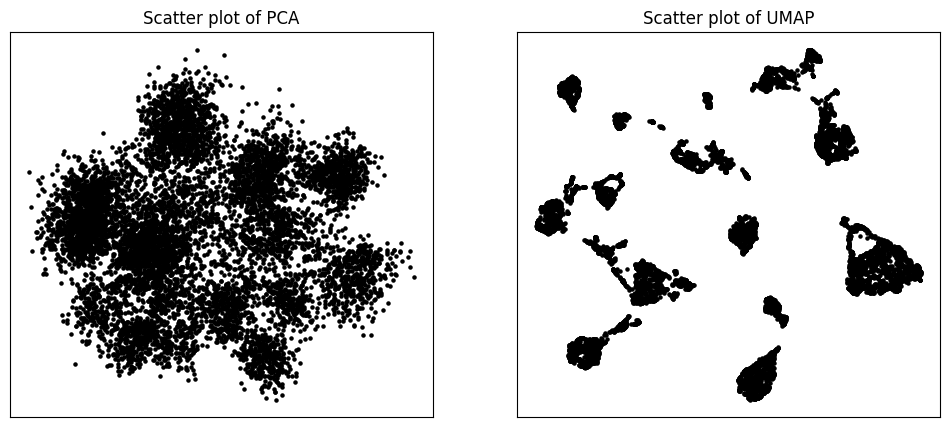

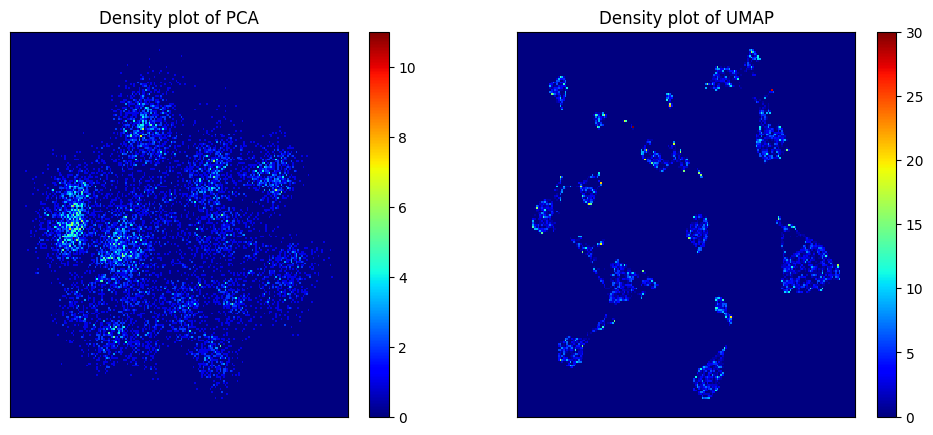

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


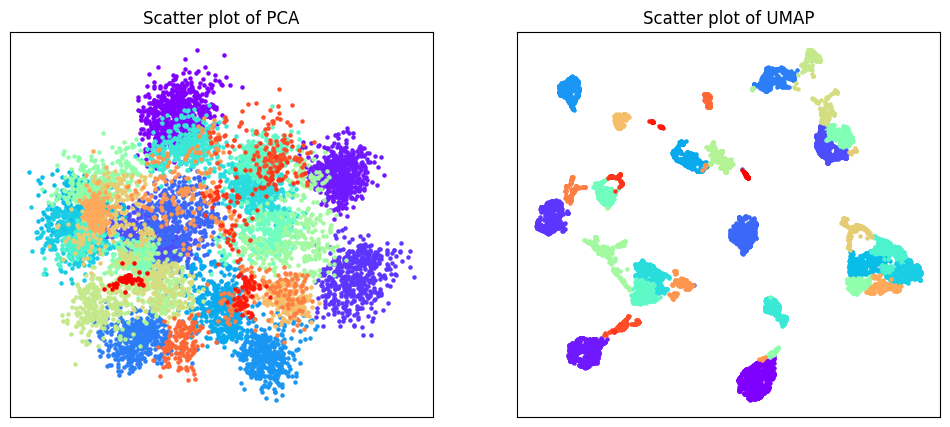

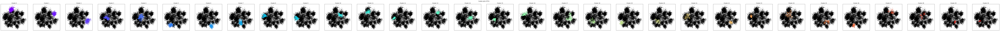

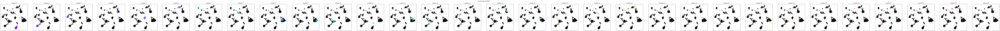

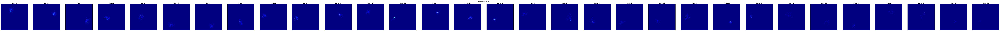

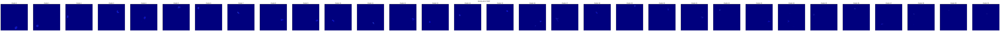

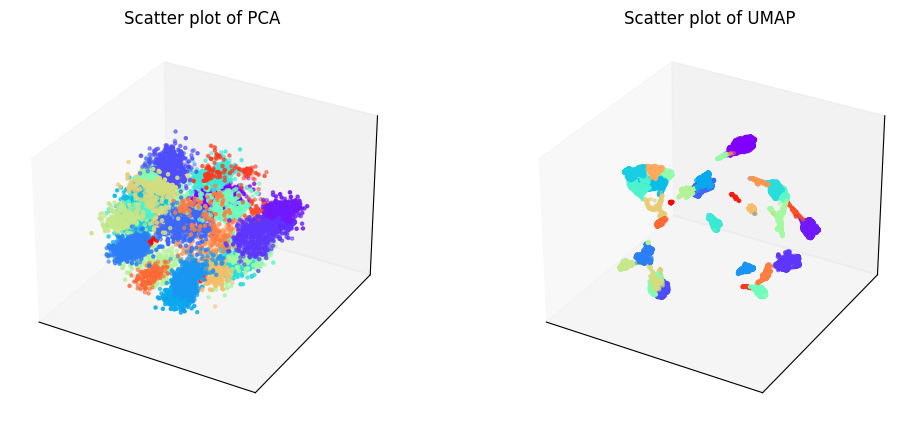

Phylogenetic tree in latent space will be shown below.


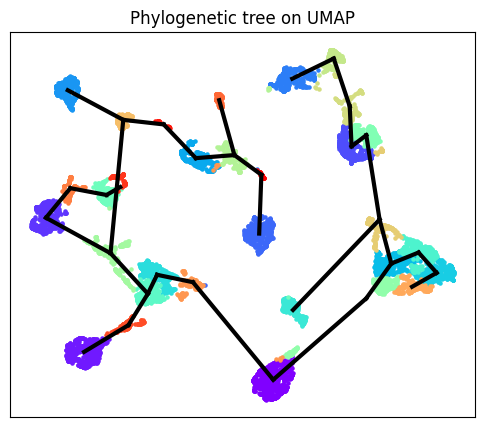

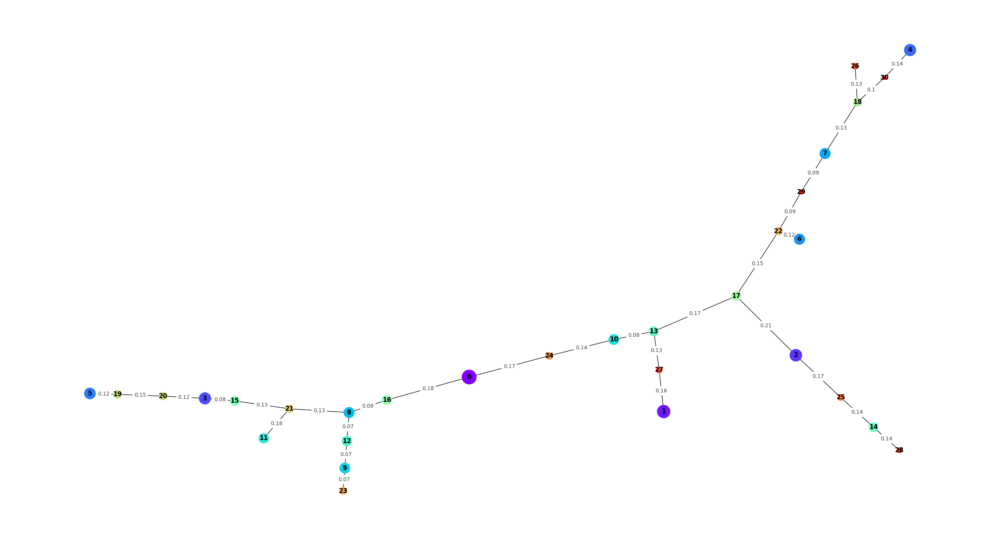

ValueError: could not broadcast input array from shape (3,) into shape (432,)

In [7]:
del unnormalized_layer5

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-bmVAE_updated.ipynb

bmVAE = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18", SNPread = "unnormalized")
bmVAE.filtering()
bmVAE.training(beta = 0.0001)
bmVAE.clustering(algorithm = "leiden_full")
bmVAE.phylogeny()

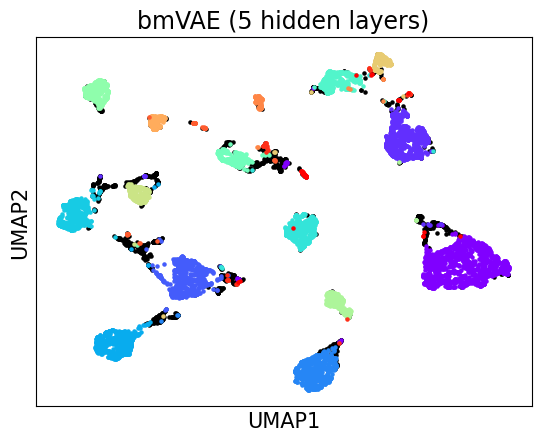

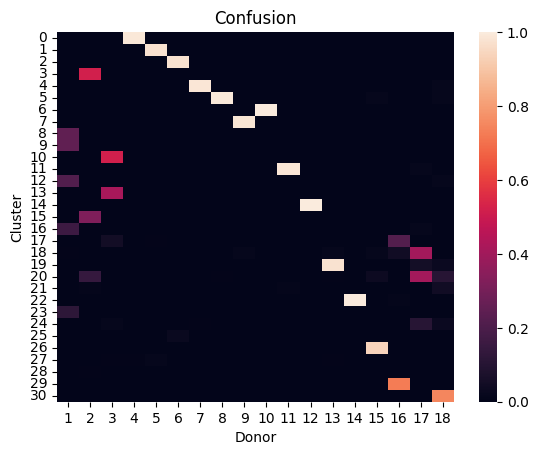

accuracy: 83.08763454698035
silhouette score: 0.7407168922456411


In [8]:
bmVAE_embedding_2d = bmVAE.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[bmVAE.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[bmVAE.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(bmVAE.embedding_2d[donors[18], 0], bmVAE.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(bmVAE.embedding_2d[donors[w], 0], bmVAE.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("bmVAE (5 hidden layers)", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = bmVAE.assigned_label
    
matrix = np.zeros((18, bmVAE.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(bmVAE.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(bmVAE.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(bmVAE.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


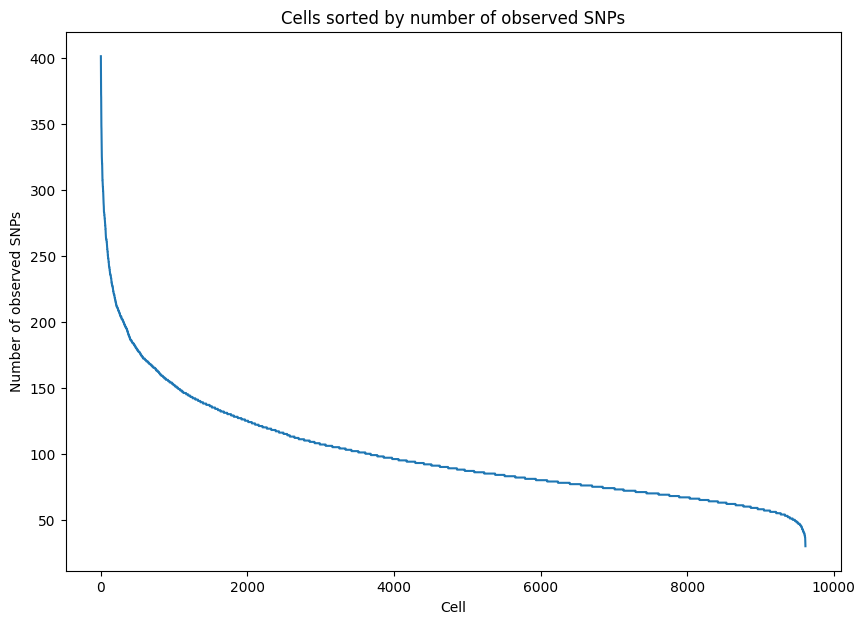

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


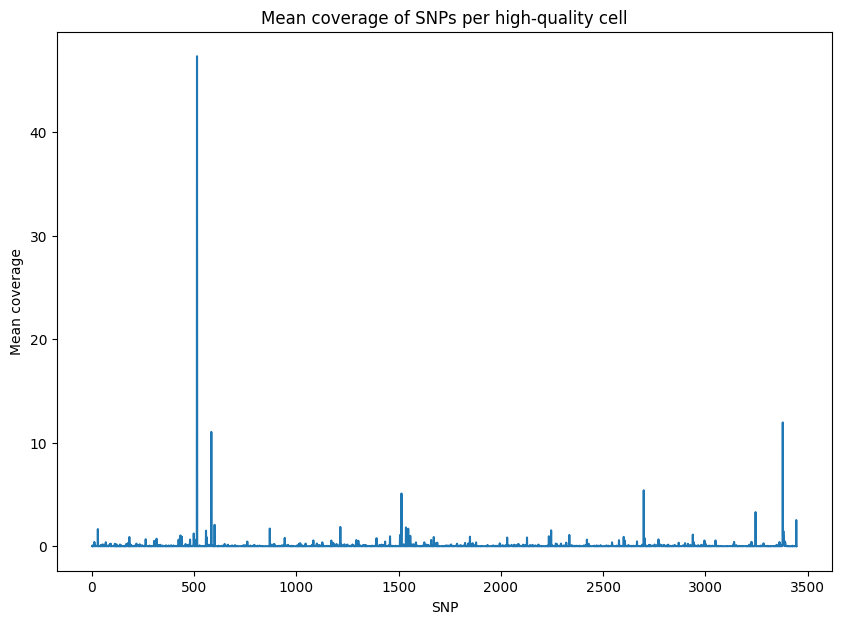

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


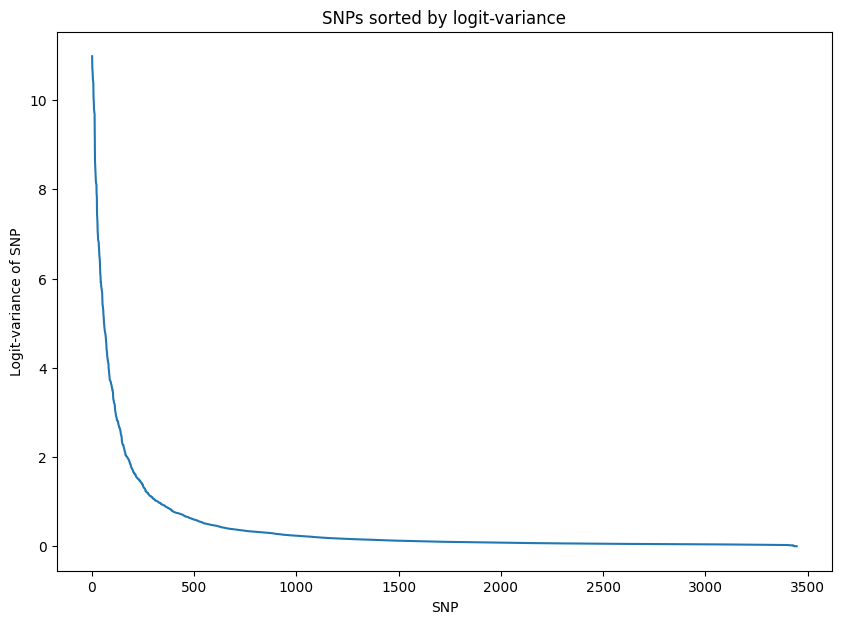

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.407990
Epoch[20/2000], Cost: 1.231494
Epoch[30/2000], Cost: 1.125080
Epoch[40/2000], Cost: 1.049849
Epoch[50/2000], Cost: 0.991279
Epoch[60/2000], Cost: 0.946411
Epoch[70/2000], Cost: 0.910639
Epoch[80/2000], Cost: 0.880850
Epoch[90/2000], Cost: 0.856259
Epoch[100/2000], Cost: 0.835608
Epoch[200/2000], Cost: 0.735816
Epoch[300/2000], Cost: 0.698872
Epoch[400/2000], Cost: 0.677221
Epoch[500/2000], Cost: 0.663717
Epoch[600/2000], Cost: 0.654643
Epoch[700/2000], Cost: 0.646389
Epoch[800/2000], Cost: 0.640269
Epoch[900/2000], Cost: 0.633193
Epoch[1000/2000], Cost: 0.627005
Epoch[1100/2000], Cost: 0.621527
Epoch[1200/2000], Cost: 0.616719
Epoch[1300/2000], Cost: 0.611335
Epoch[1400/2000], Cost: 0.608154
Epoch[1500/2000], Cost: 0.602506
Epoch[1600/200

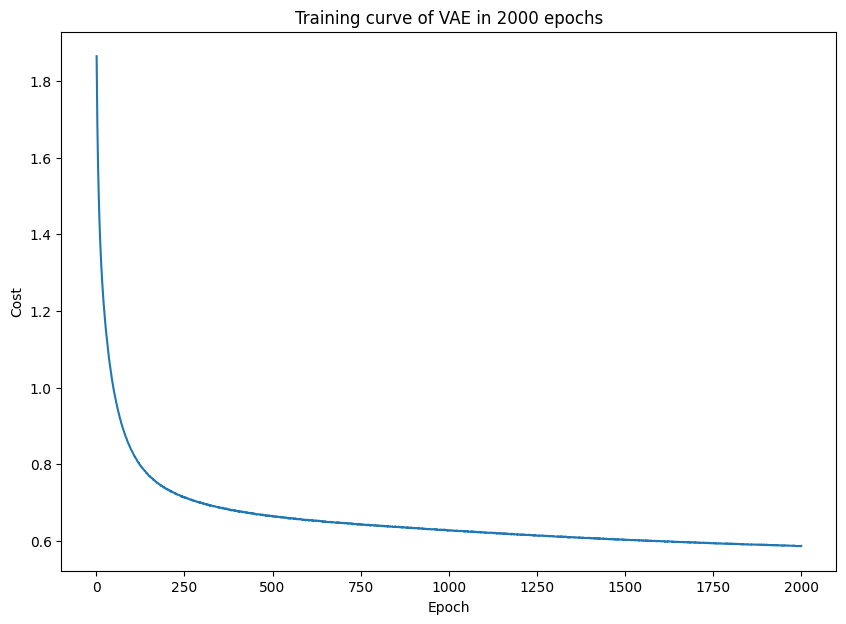

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


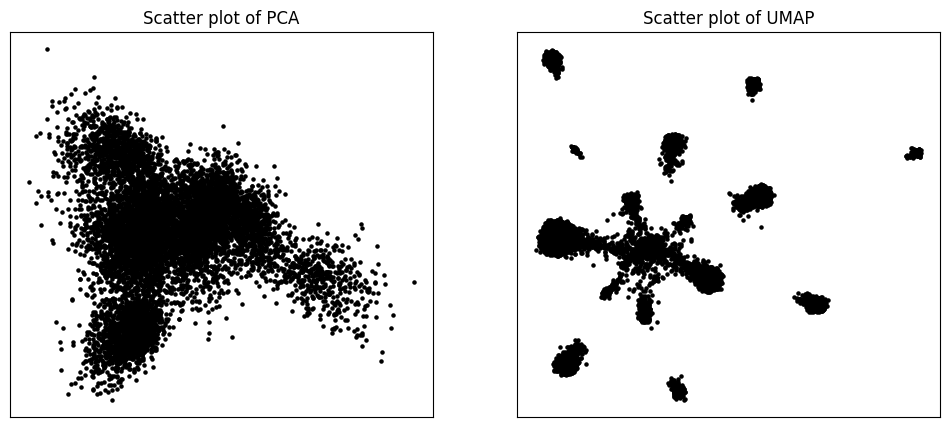

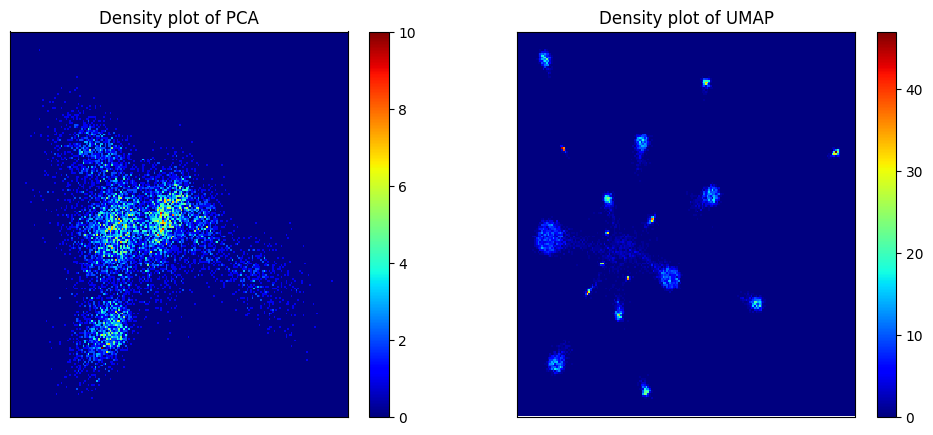

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


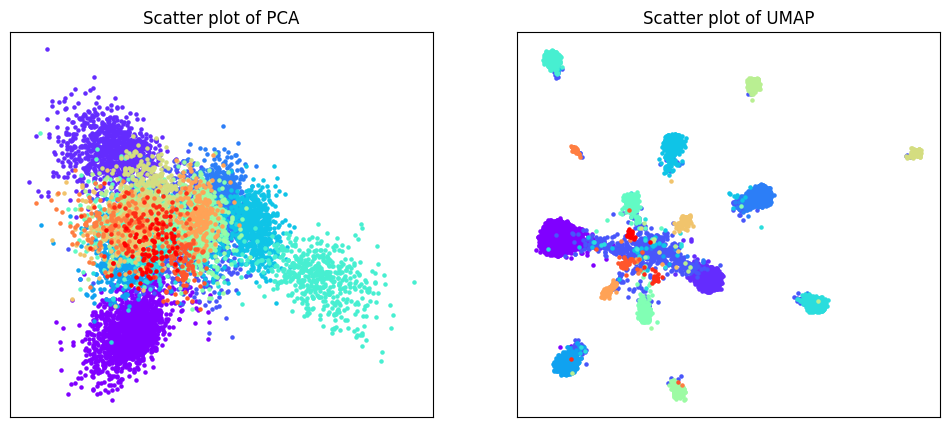

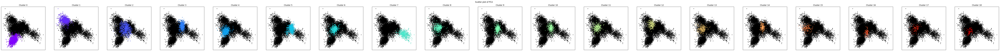

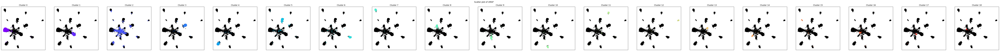

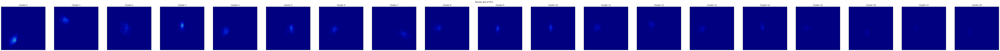

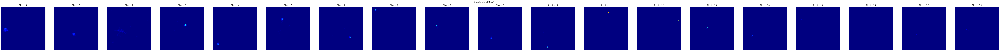

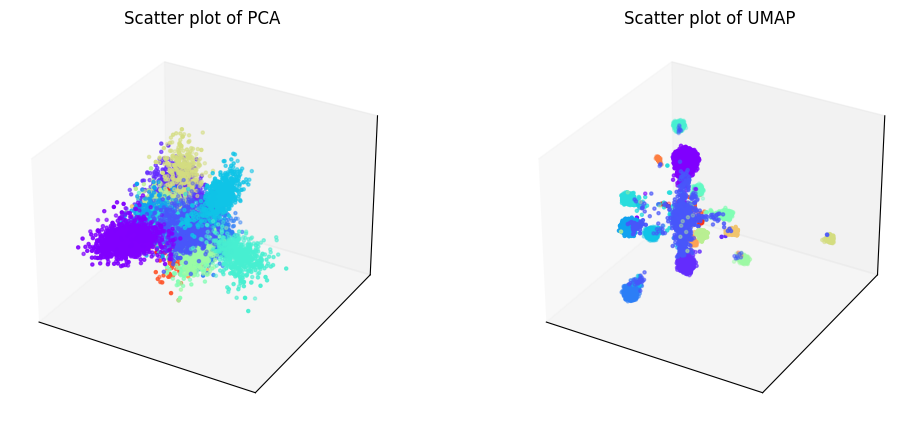

Phylogenetic tree in latent space will be shown below.


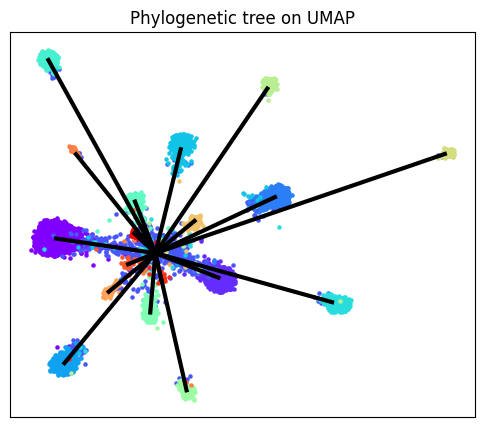

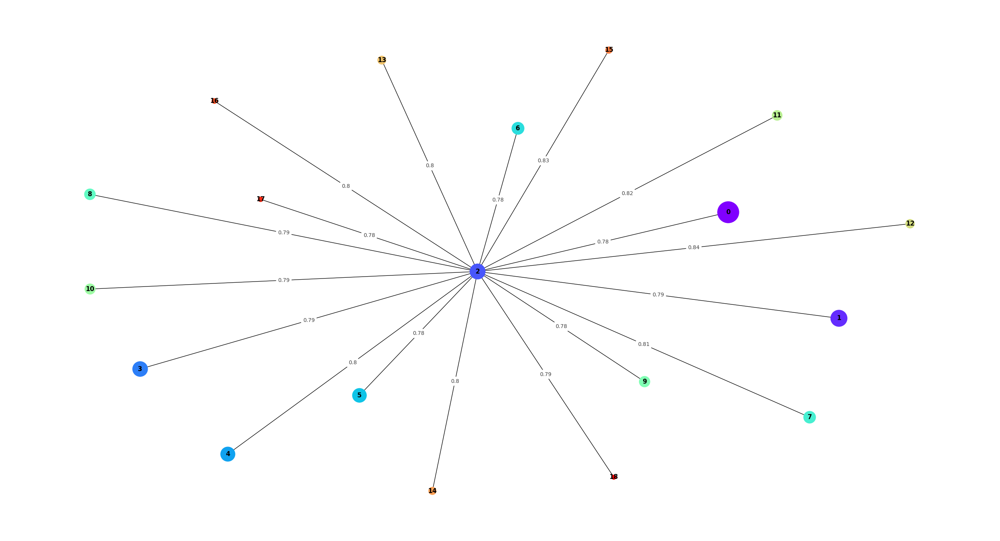

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


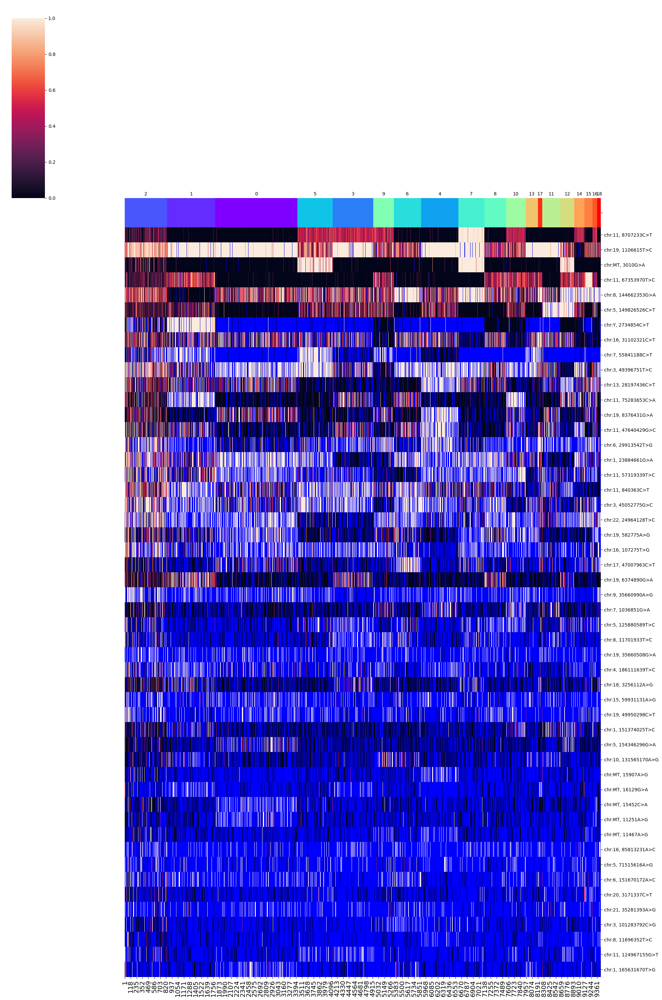

SNPs sorted by lowest p-value will be shown below


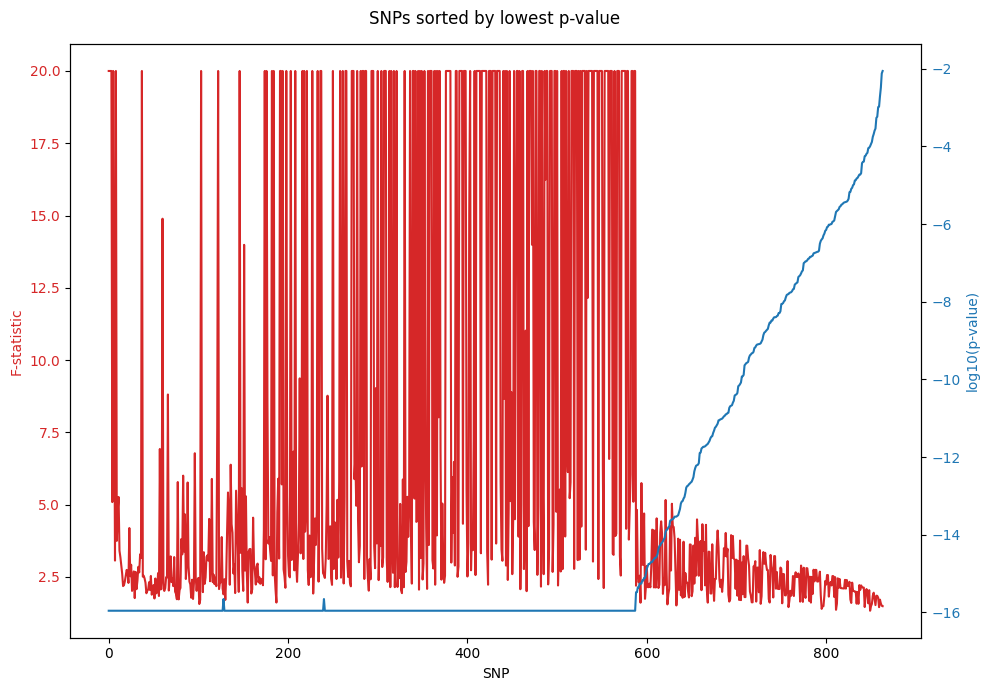

In [9]:
del bmVAE

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_05 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
b_05.filtering()
b_05.training(beta = 0.5)
b_05.clustering(algorithm = "leiden_full")
b_05.phylogeny()

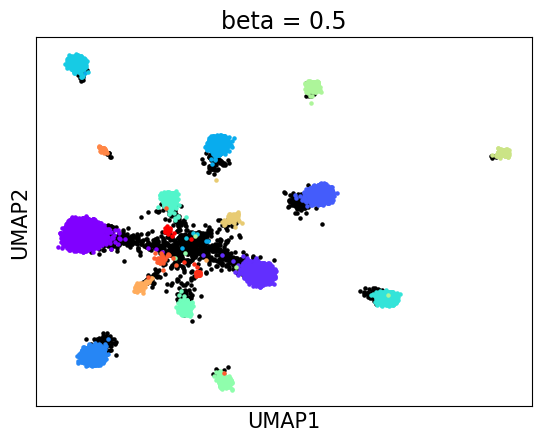

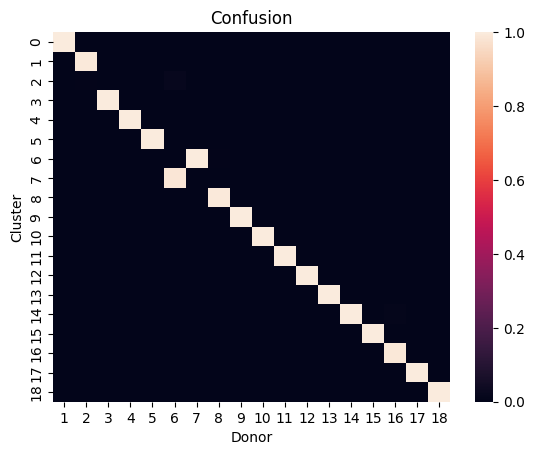

accuracy: 99.71922232639947
silhouette score: 0.8526393843741933


In [10]:
b_05_embedding_2d = b_05.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[b_05.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[b_05.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_05.embedding_2d[donors[18], 0], b_05.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(b_05.embedding_2d[donors[w], 0], b_05.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 0.5", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = b_05.assigned_label
    
matrix = np.zeros((18, b_05.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(b_05.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(b_05.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_05.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


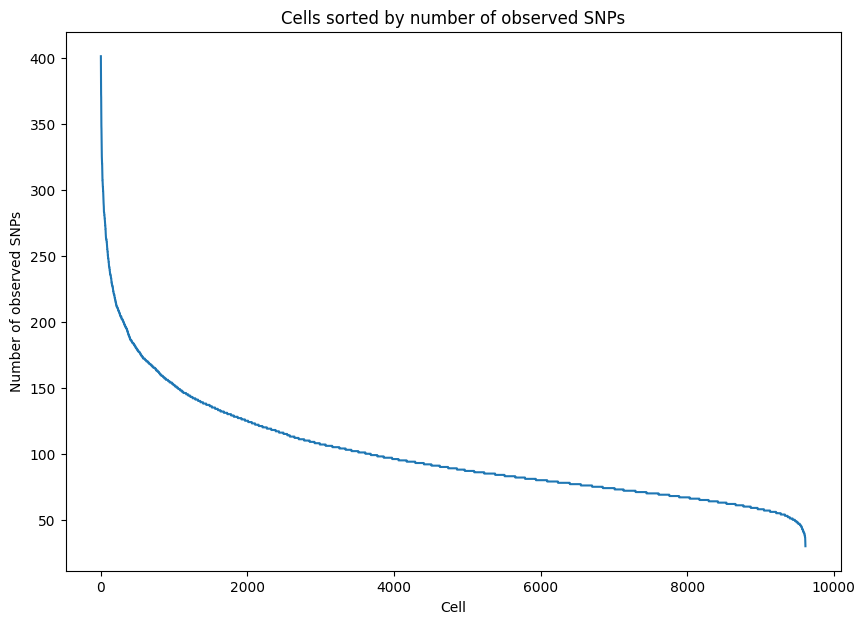

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


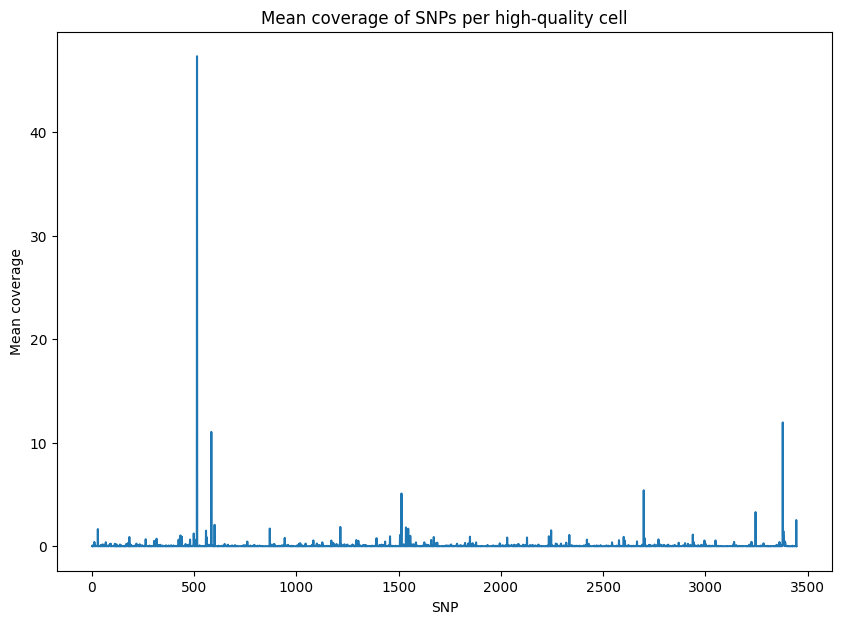

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


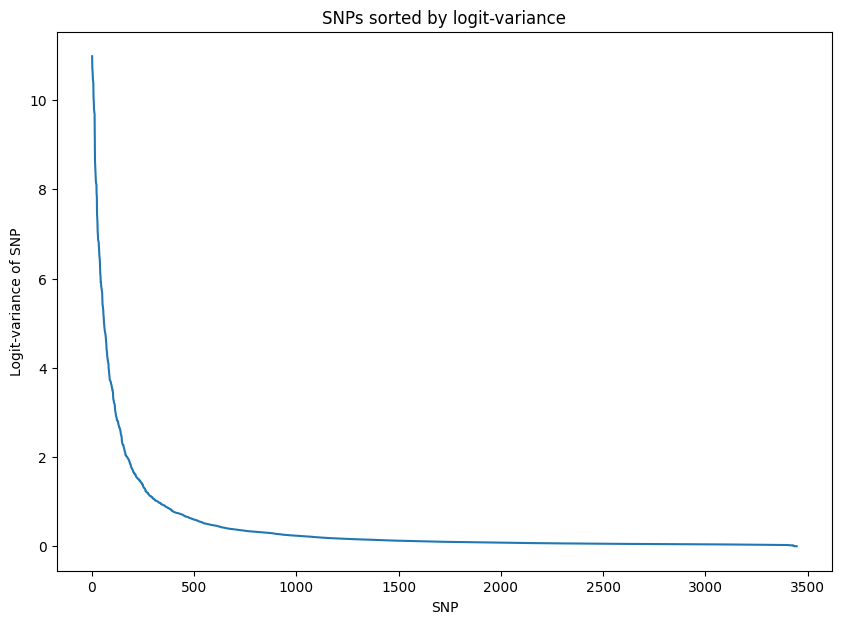

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.661142
Epoch[20/2000], Cost: 1.449192
Epoch[30/2000], Cost: 1.313162
Epoch[40/2000], Cost: 1.213377
Epoch[50/2000], Cost: 1.138319
Epoch[60/2000], Cost: 1.080532
Epoch[70/2000], Cost: 1.033202
Epoch[80/2000], Cost: 0.996644
Epoch[90/2000], Cost: 0.967285
Epoch[100/2000], Cost: 0.942943
Epoch[200/2000], Cost: 0.838927
Epoch[300/2000], Cost: 0.808564
Epoch[400/2000], Cost: 0.790842
Epoch[500/2000], Cost: 0.780725
Epoch[600/2000], Cost: 0.772567
Epoch[700/2000], Cost: 0.764563
Epoch[800/2000], Cost: 0.758788
Epoch[900/2000], Cost: 0.750468
Epoch[1000/2000], Cost: 0.746446
Epoch[1100/2000], Cost: 0.738343
Epoch[1200/2000], Cost: 0.733446
Epoch[1300/2000], Cost: 0.727751
Epoch[1400/2000], Cost: 0.720718
Epoch[1500/2000], Cost: 0.715473
Epoch[1600/200

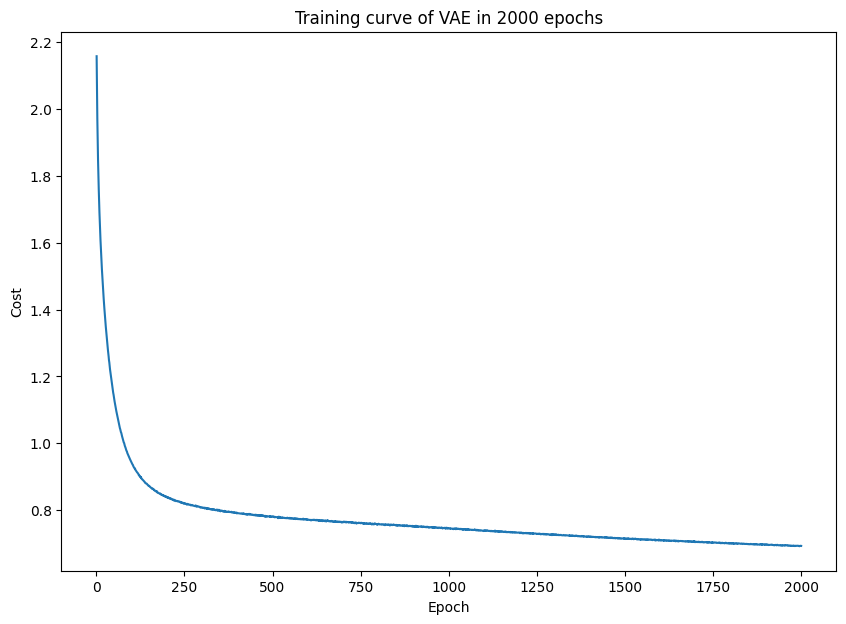

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


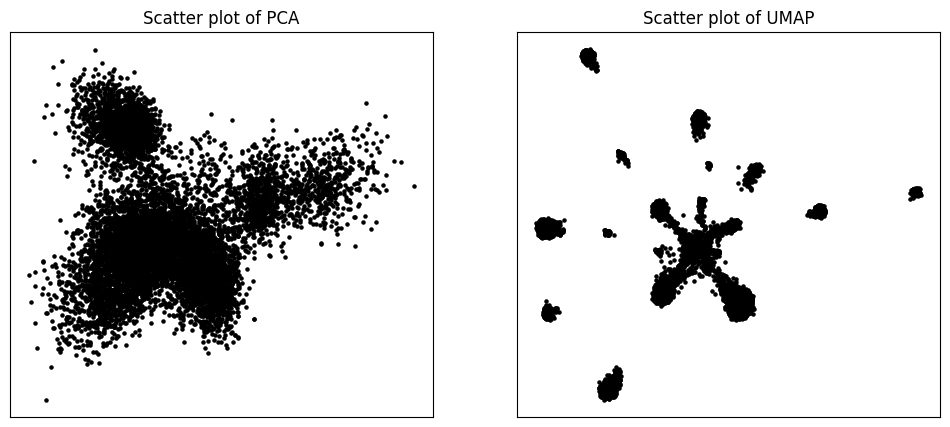

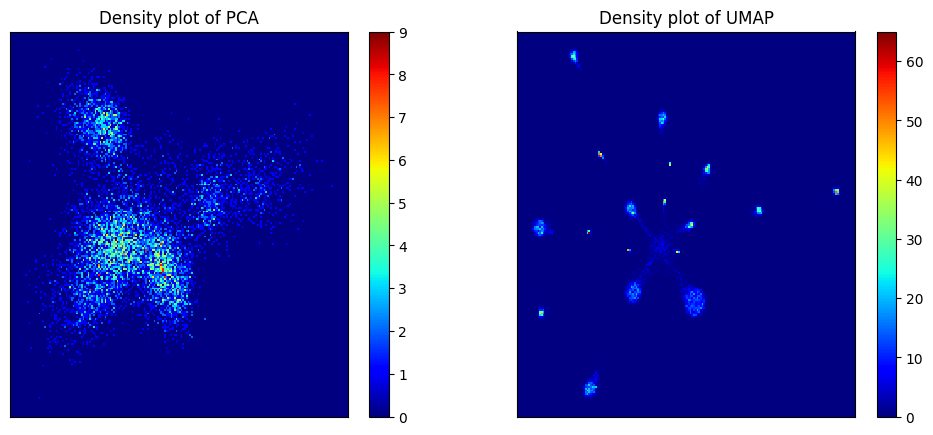

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


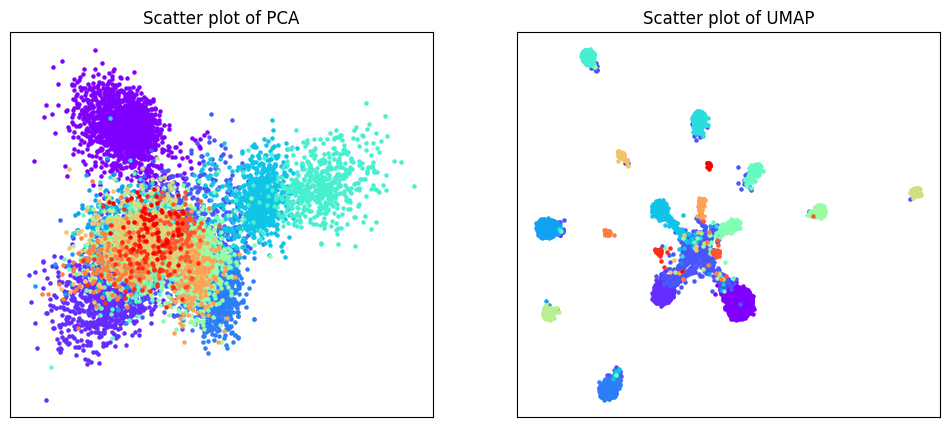

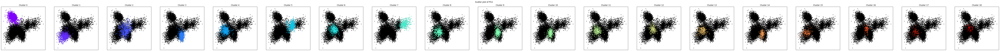

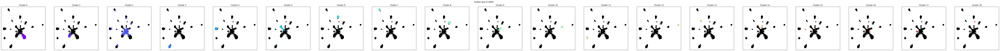

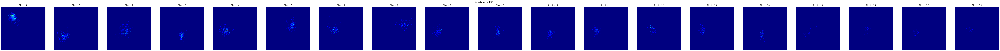

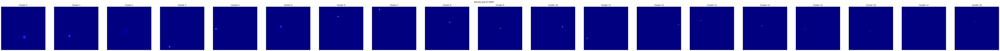

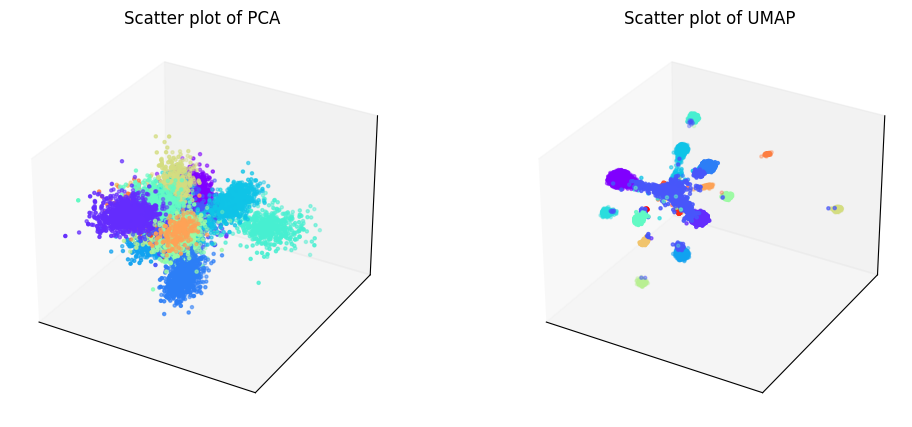

Phylogenetic tree in latent space will be shown below.


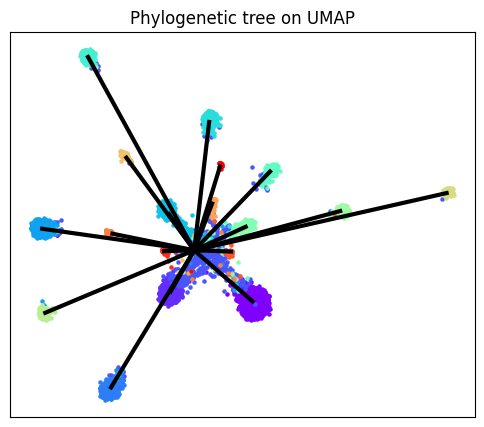

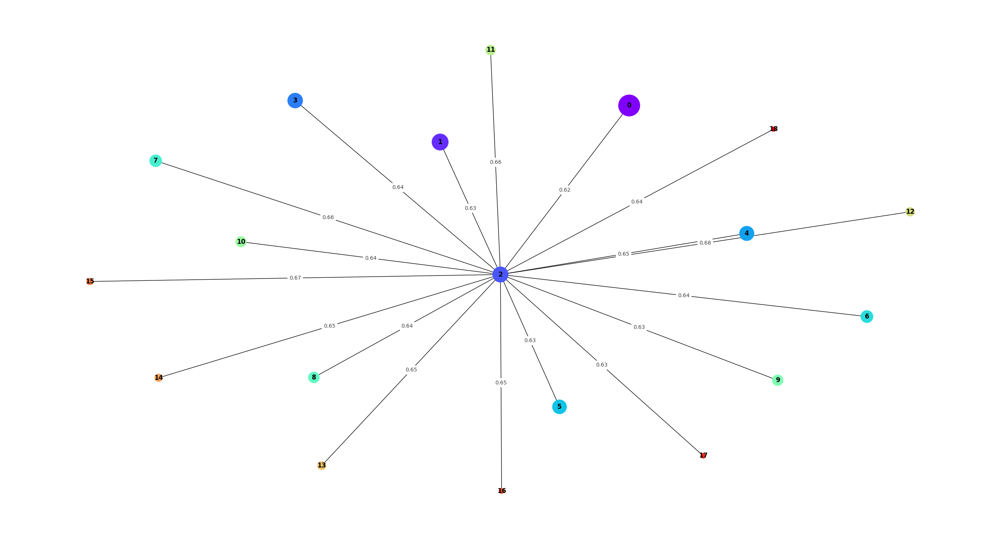

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


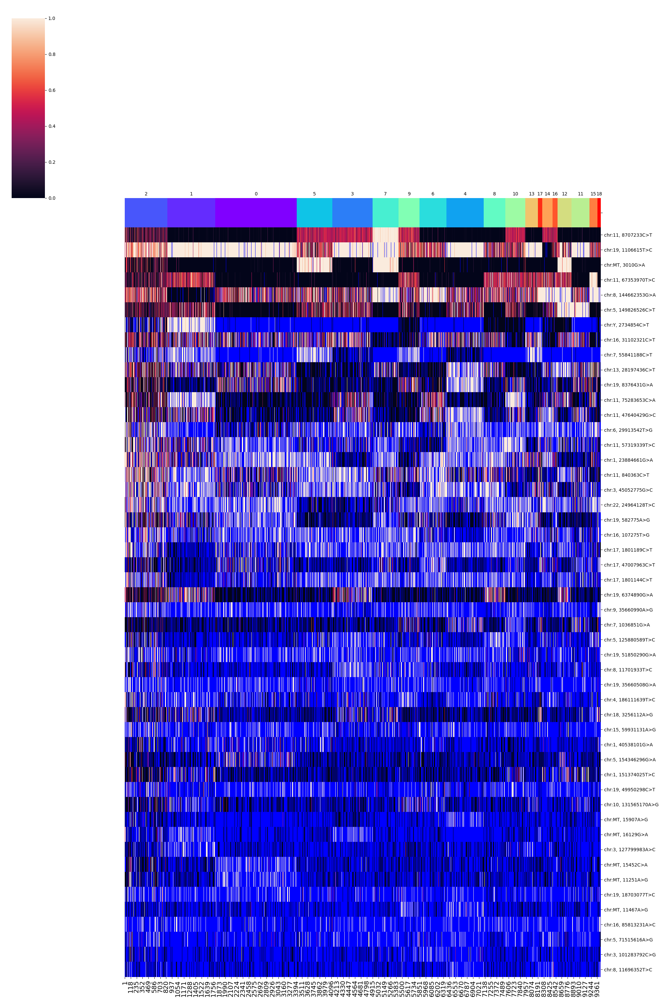

SNPs sorted by lowest p-value will be shown below


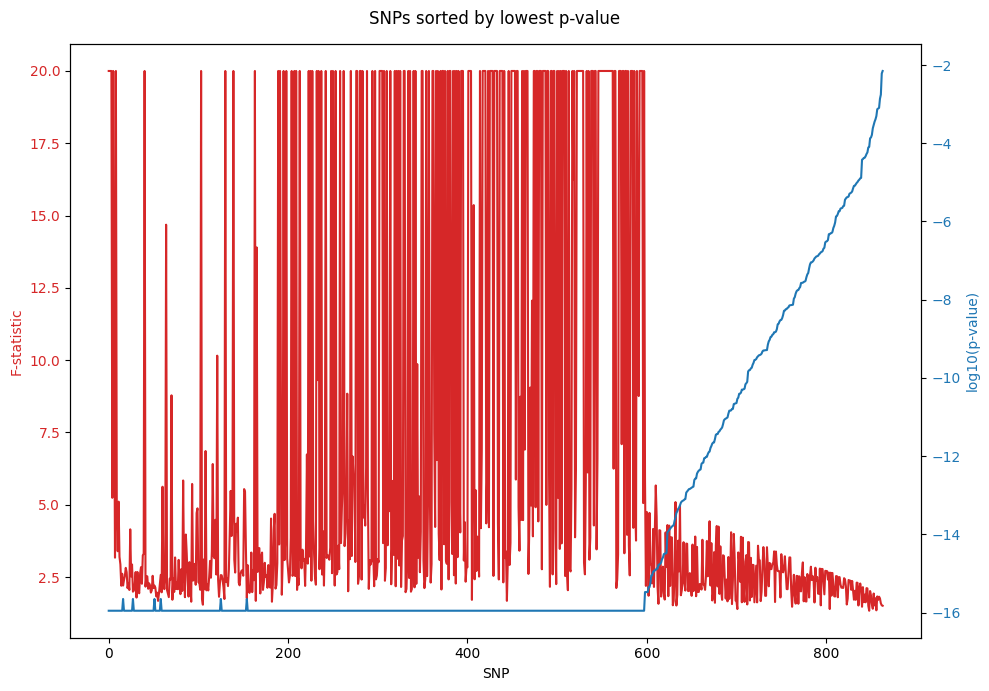

In [11]:
del b_05

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_10 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
b_10.filtering()
b_10.training(beta = 1)
b_10.clustering(algorithm = "leiden_full")
b_10.phylogeny()

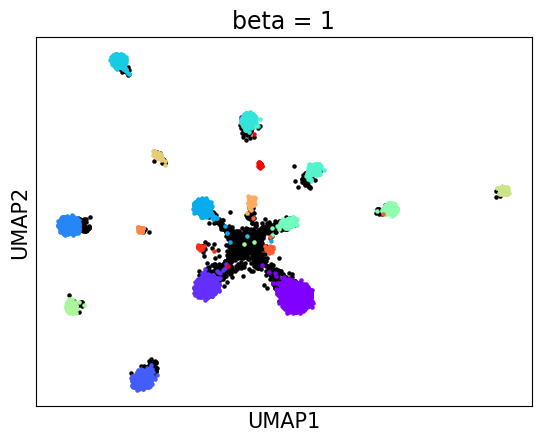

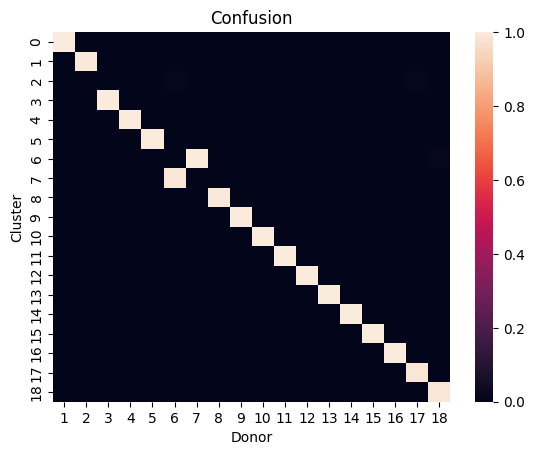

accuracy: 99.6672481971557
silhouette score: 0.8654750461148144


In [13]:
b_10_embedding_2d = b_10.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[b_10.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[b_10.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_10.embedding_2d[donors[18], 0], b_10.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(b_10.embedding_2d[donors[w], 0], b_10.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 1", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = b_10.assigned_label
    
matrix = np.zeros((18, b_10.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(b_10.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(b_10.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_10.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


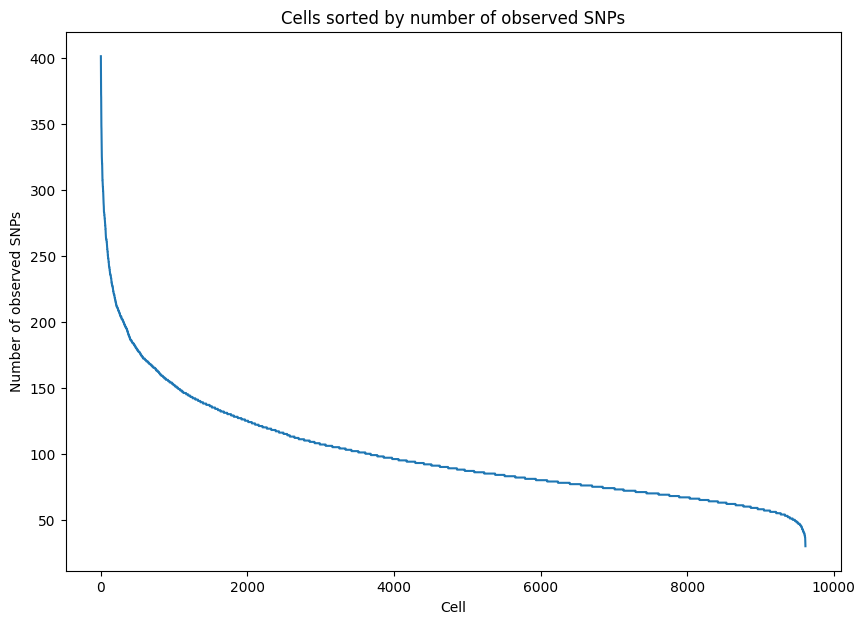

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


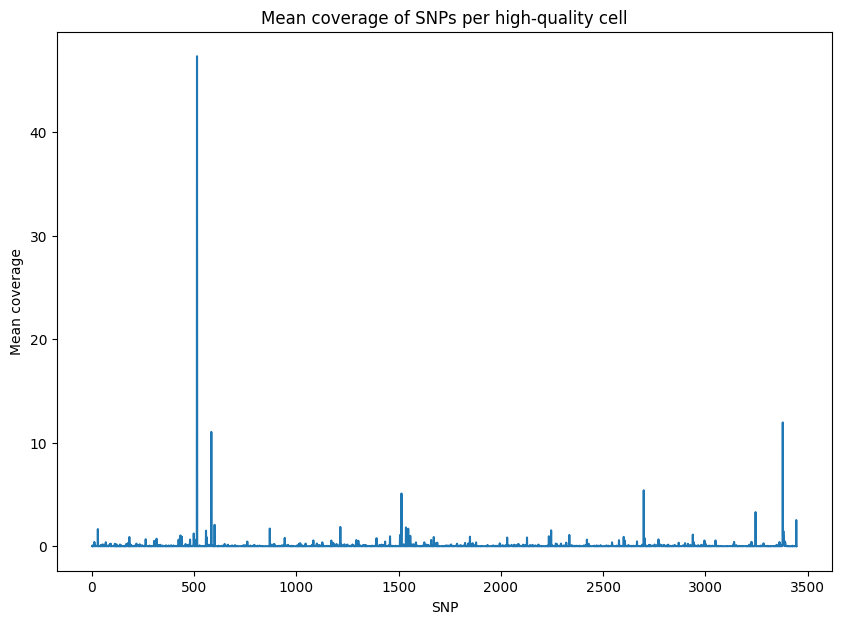

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


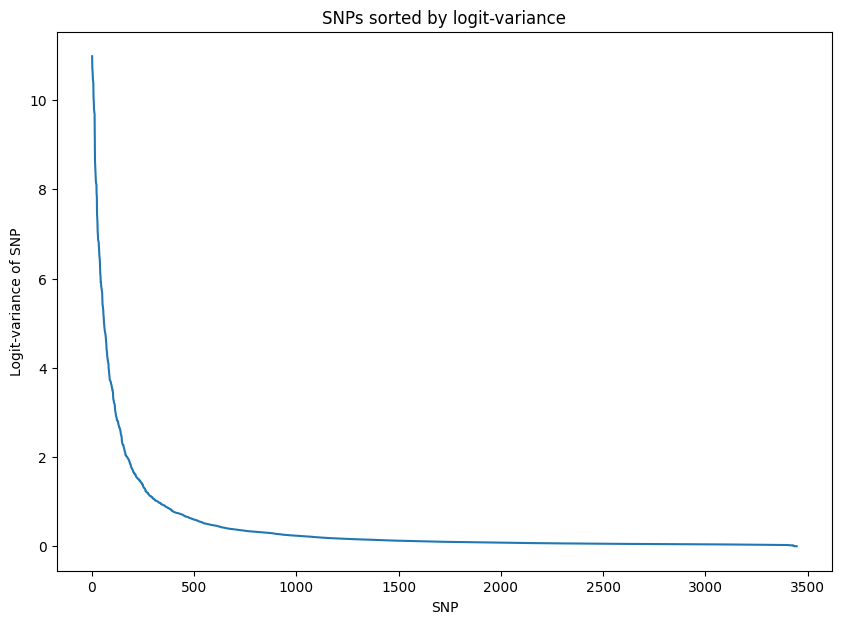

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.880411
Epoch[20/2000], Cost: 1.614563
Epoch[30/2000], Cost: 1.439508
Epoch[40/2000], Cost: 1.314399
Epoch[50/2000], Cost: 1.219020
Epoch[60/2000], Cost: 1.150422
Epoch[70/2000], Cost: 1.097088
Epoch[80/2000], Cost: 1.057728
Epoch[90/2000], Cost: 1.023610
Epoch[100/2000], Cost: 0.998971
Epoch[200/2000], Cost: 0.901902
Epoch[300/2000], Cost: 0.876745
Epoch[400/2000], Cost: 0.861385
Epoch[500/2000], Cost: 0.851765
Epoch[600/2000], Cost: 0.845587
Epoch[700/2000], Cost: 0.839132
Epoch[800/2000], Cost: 0.835325
Epoch[900/2000], Cost: 0.831250
Epoch[1000/2000], Cost: 0.822556
Epoch[1100/2000], Cost: 0.818237
Epoch[1200/2000], Cost: 0.811402
Epoch[1300/2000], Cost: 0.805550
Epoch[1400/2000], Cost: 0.798372
Epoch[1500/2000], Cost: 0.791896
Epoch[1600/200

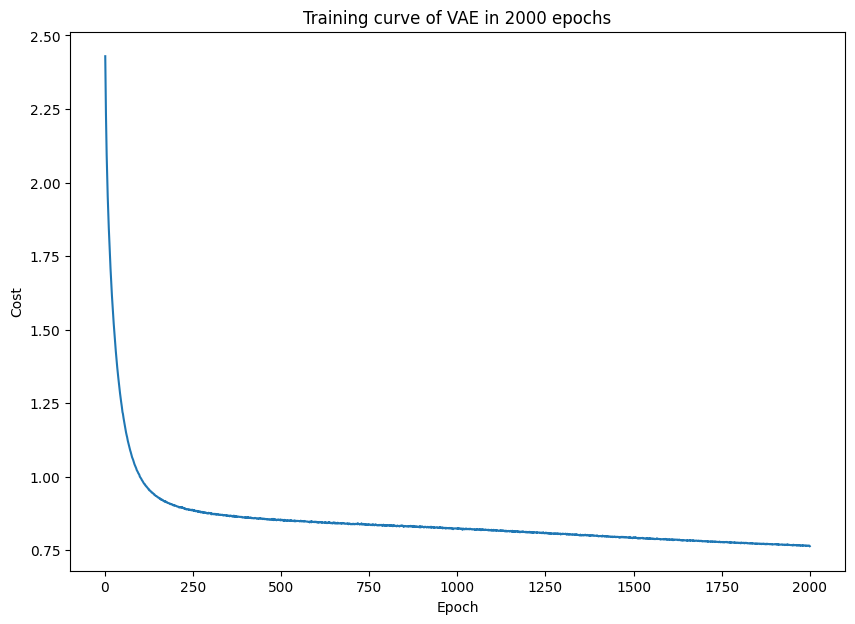

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


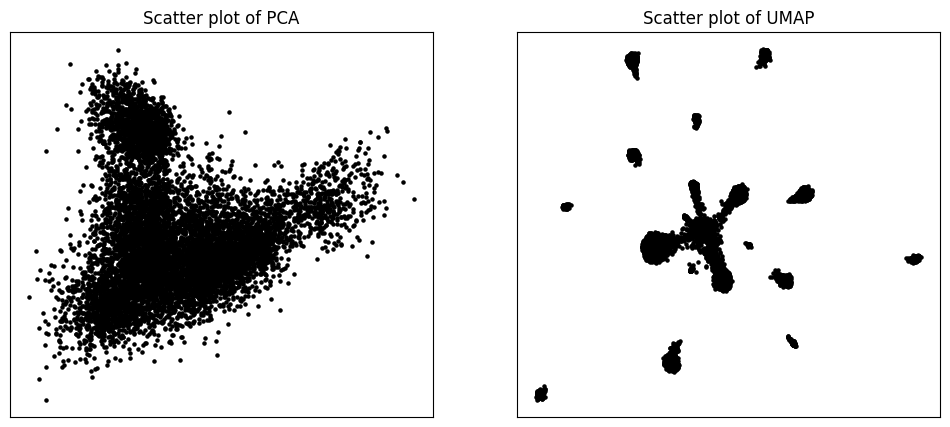

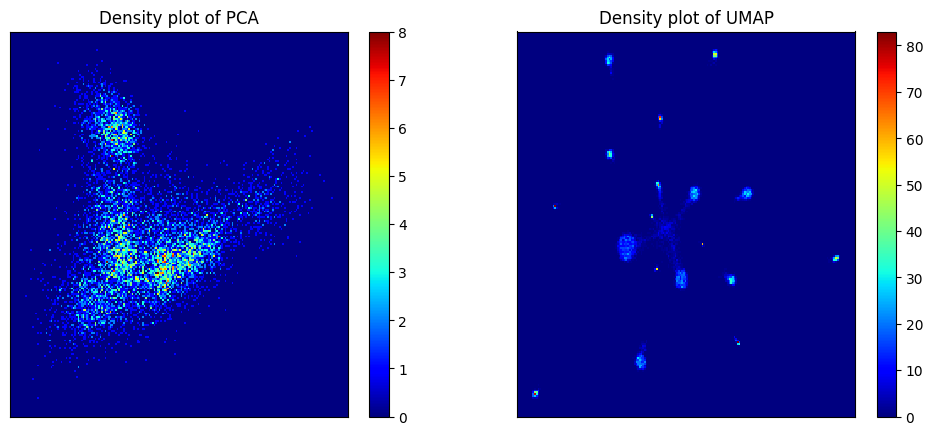

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


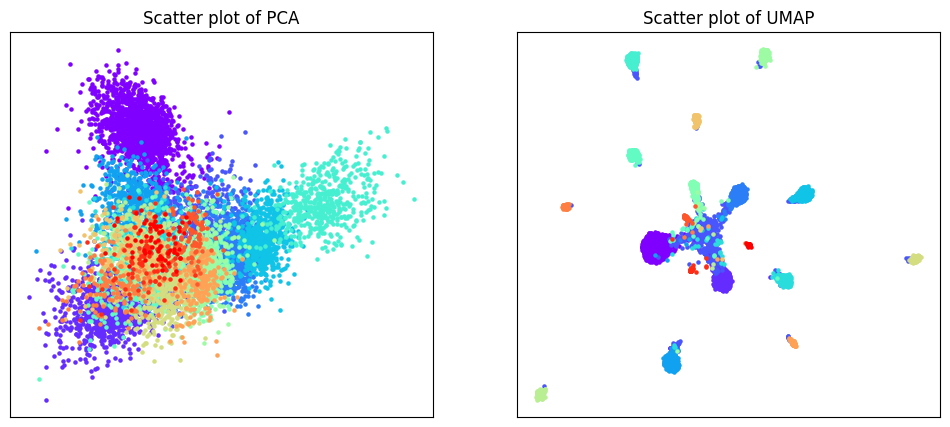

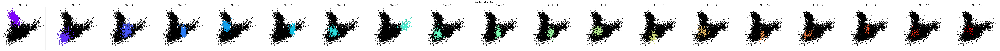

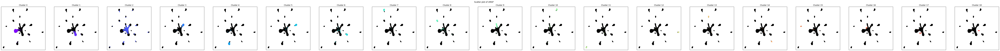

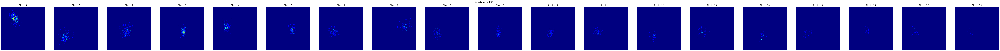

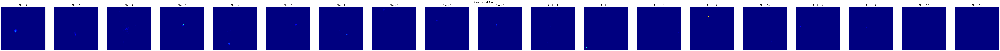

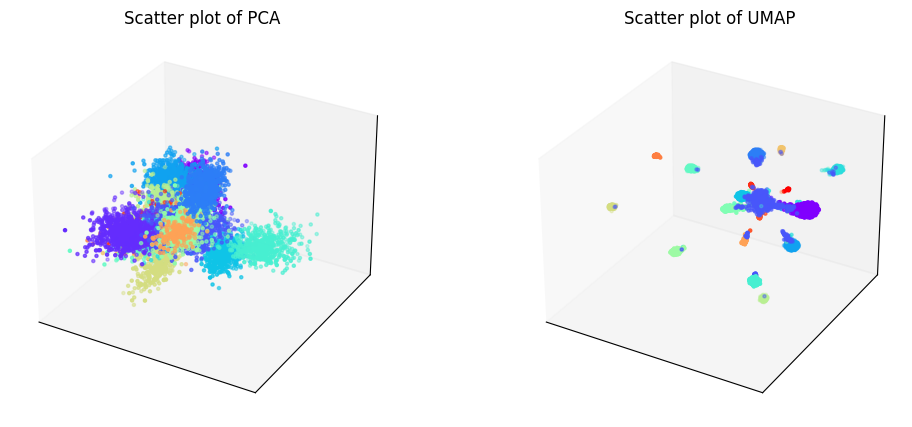

Phylogenetic tree in latent space will be shown below.


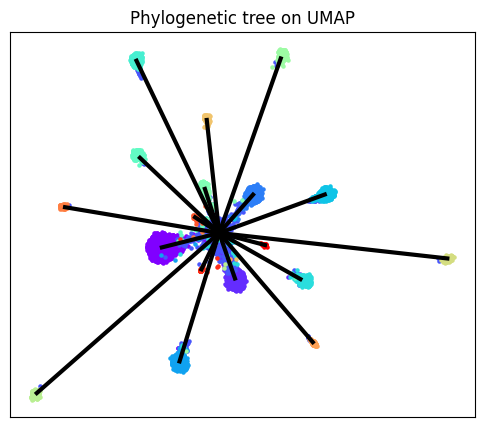

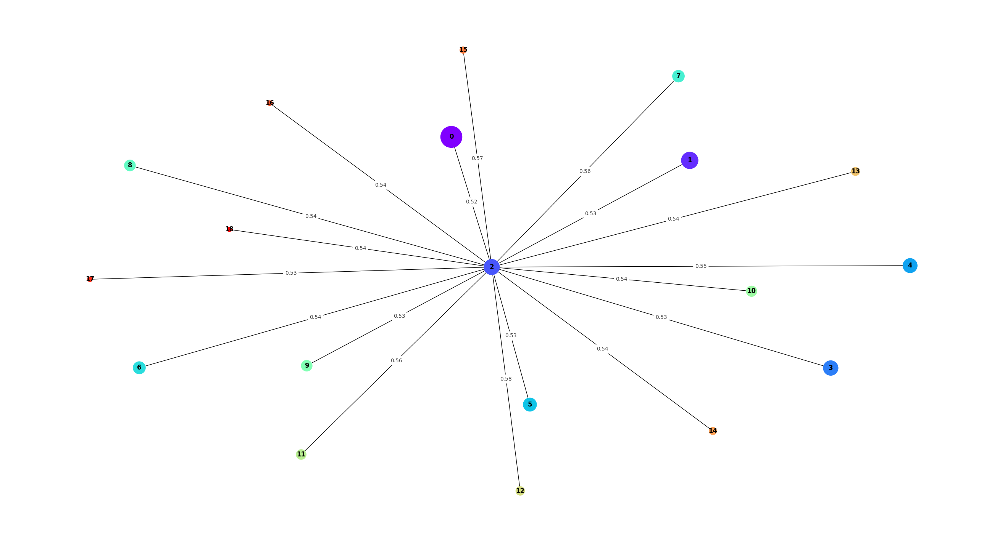

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


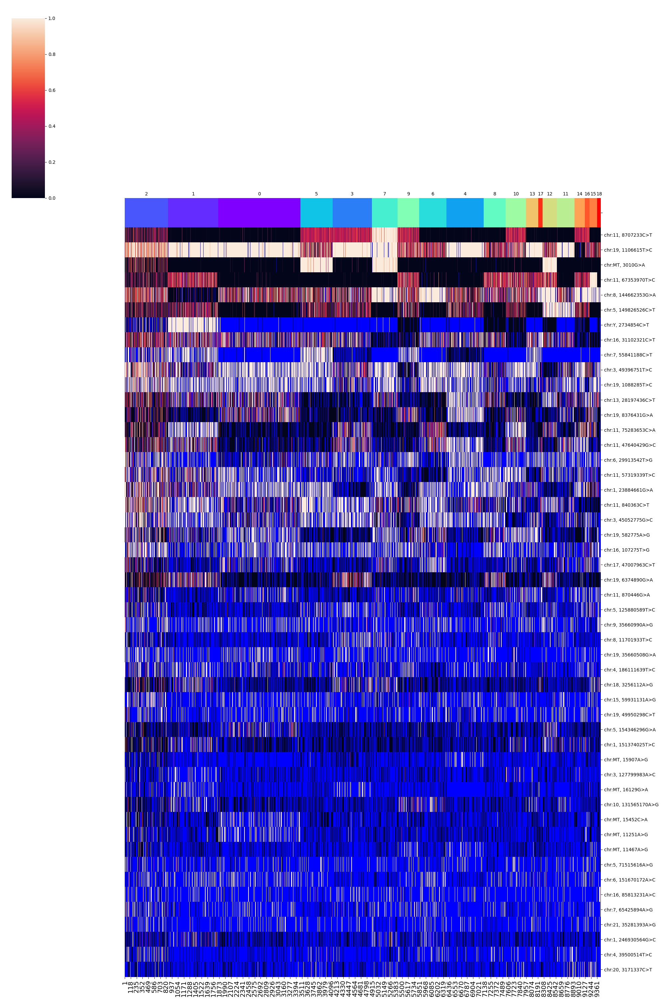

SNPs sorted by lowest p-value will be shown below


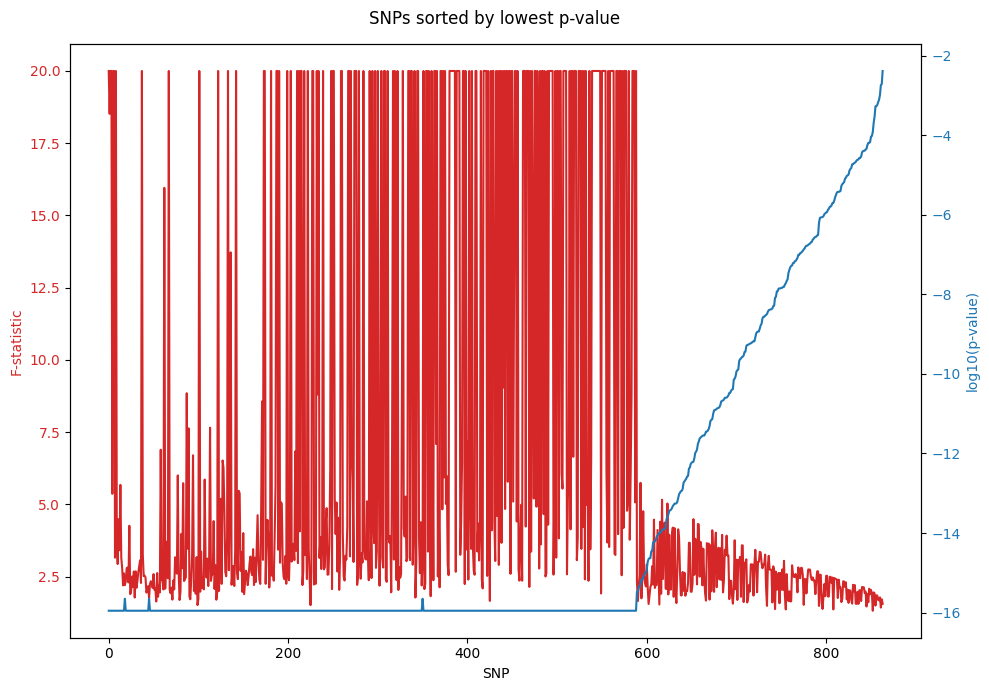

In [14]:
del b_10

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_15 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
b_15.filtering()
b_15.training(beta = 1.5)
b_15.clustering(algorithm = "leiden_full")
b_15.phylogeny()

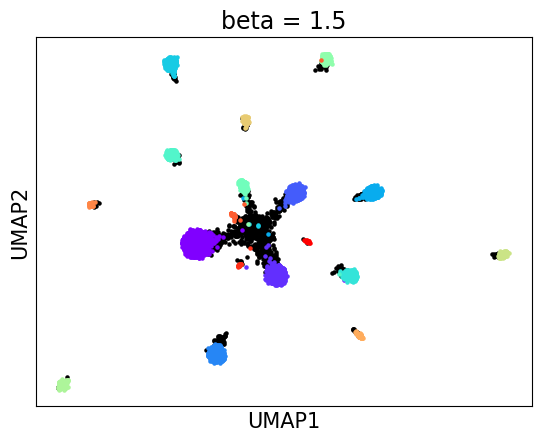

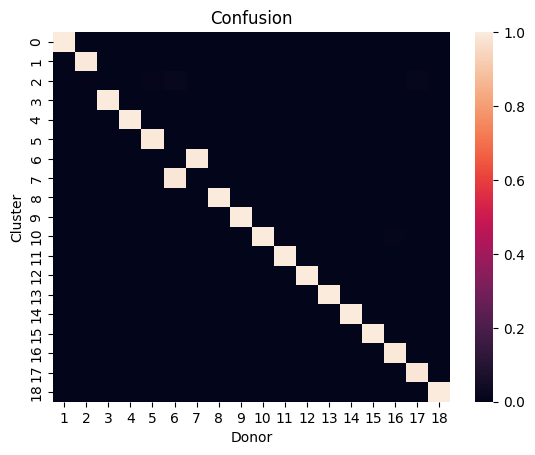

accuracy: 99.64718237977912
silhouette score: 0.8761775757490196


In [16]:
b_15_embedding_2d = b_15.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[b_15.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[b_15.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_15.embedding_2d[donors[18], 0], b_15.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(b_15.embedding_2d[donors[w], 0], b_15.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 1.5", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = b_15.assigned_label
    
matrix = np.zeros((18, b_15.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(b_15.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(b_15.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_15.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


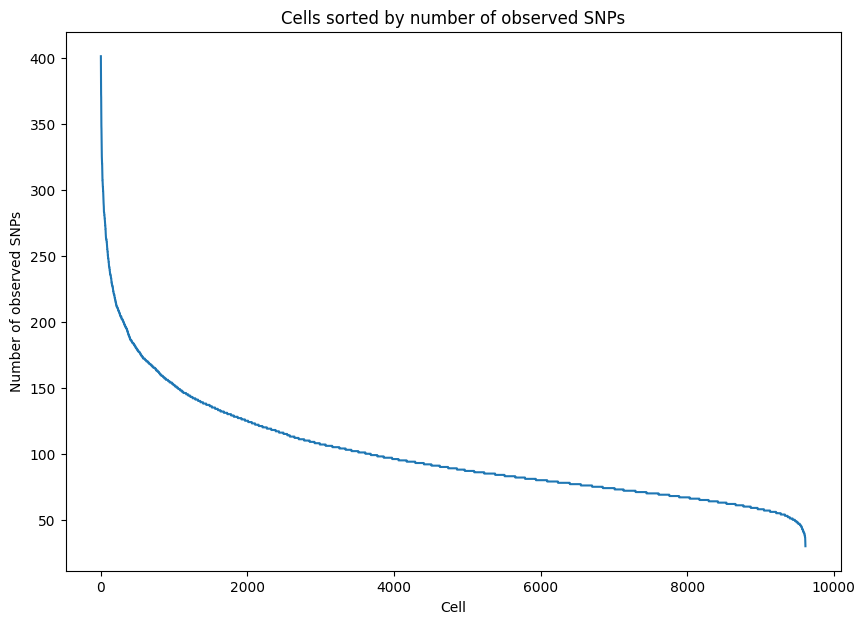

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


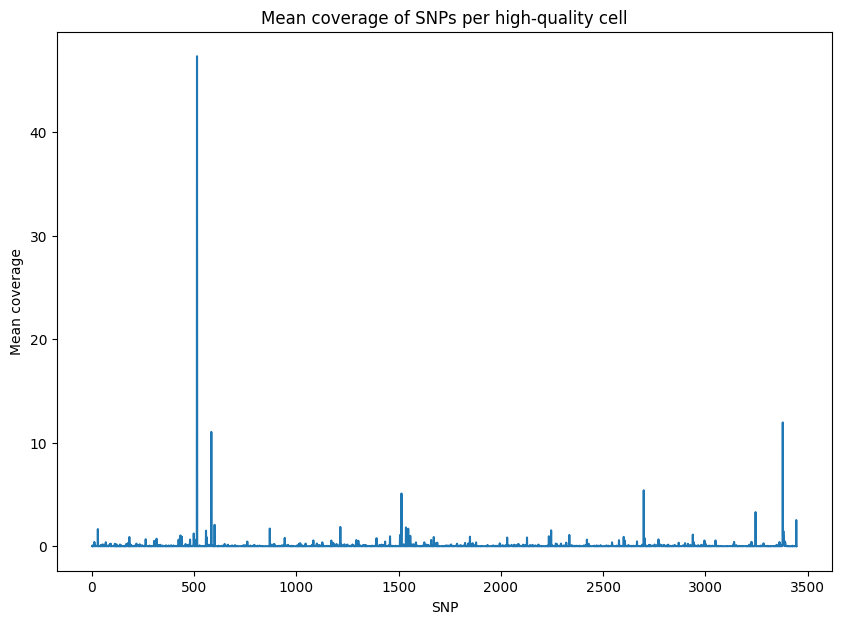

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


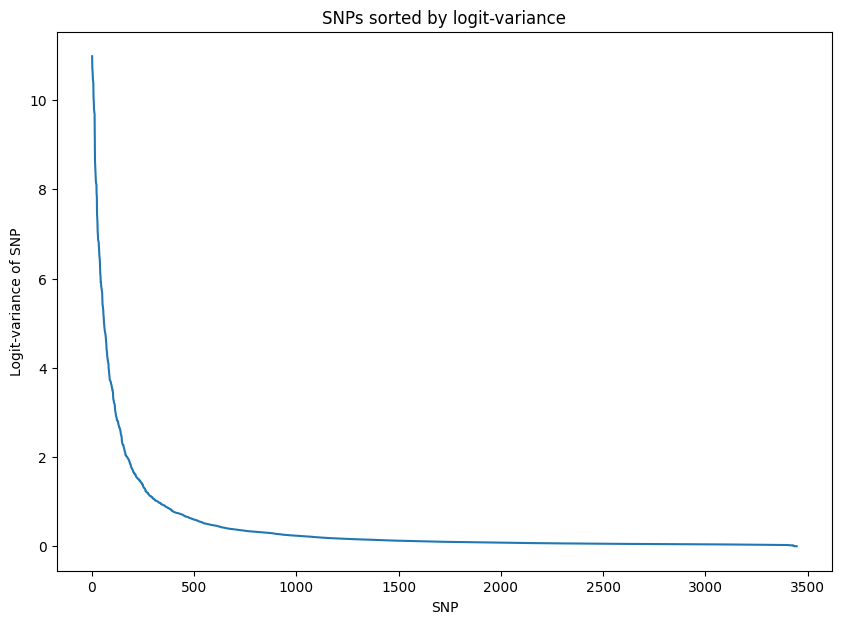

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 2.104322
Epoch[20/2000], Cost: 1.792210
Epoch[30/2000], Cost: 1.579908
Epoch[40/2000], Cost: 1.427279
Epoch[50/2000], Cost: 1.314199
Epoch[60/2000], Cost: 1.230051
Epoch[70/2000], Cost: 1.166308
Epoch[80/2000], Cost: 1.120250
Epoch[90/2000], Cost: 1.083249
Epoch[100/2000], Cost: 1.056120
Epoch[200/2000], Cost: 0.949109
Epoch[300/2000], Cost: 0.923464
Epoch[400/2000], Cost: 0.910703
Epoch[500/2000], Cost: 0.902680
Epoch[600/2000], Cost: 0.897007
Epoch[700/2000], Cost: 0.893046
Epoch[800/2000], Cost: 0.885651
Epoch[900/2000], Cost: 0.881910
Epoch[1000/2000], Cost: 0.877215
Epoch[1100/2000], Cost: 0.869622
Epoch[1200/2000], Cost: 0.863255
Epoch[1300/2000], Cost: 0.855938
Epoch[1400/2000], Cost: 0.848562
Epoch[1500/2000], Cost: 0.840254
Epoch[1600/200

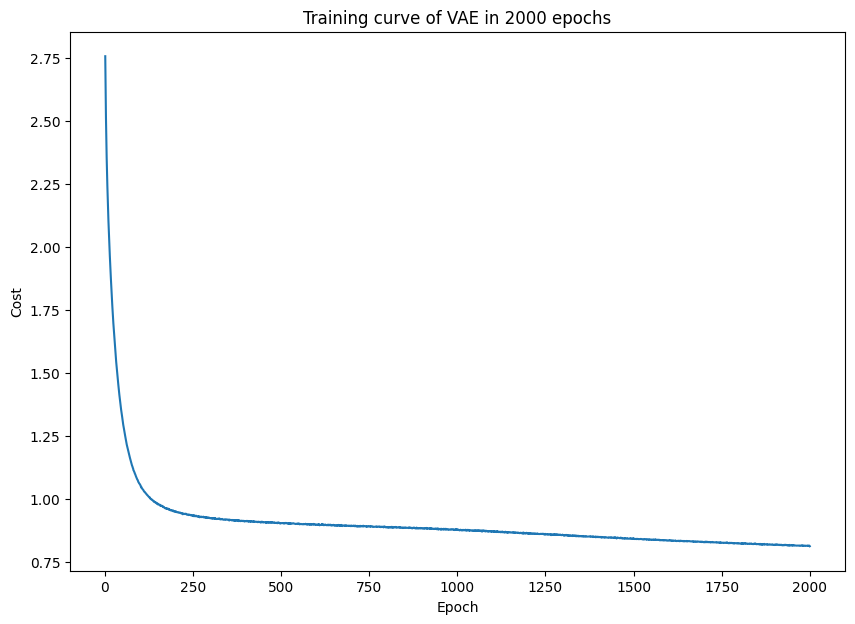

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


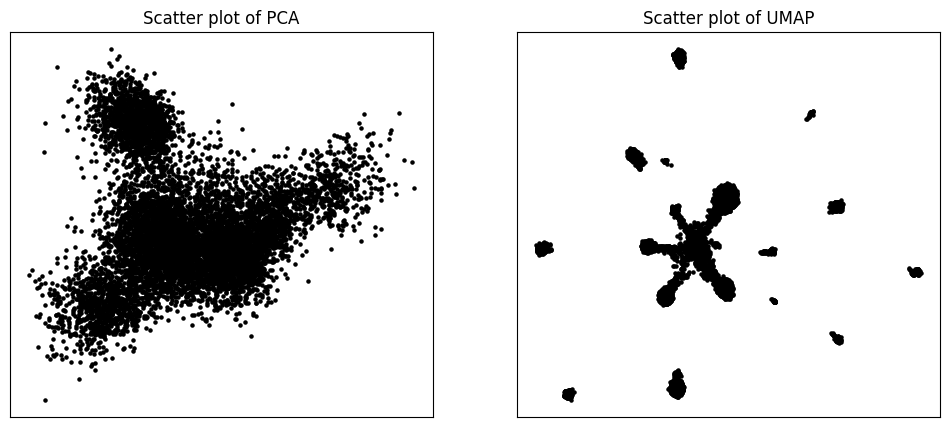

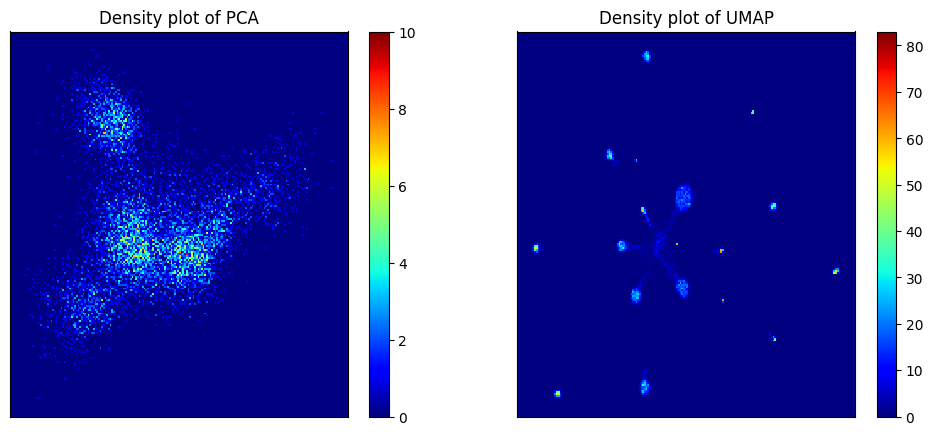

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


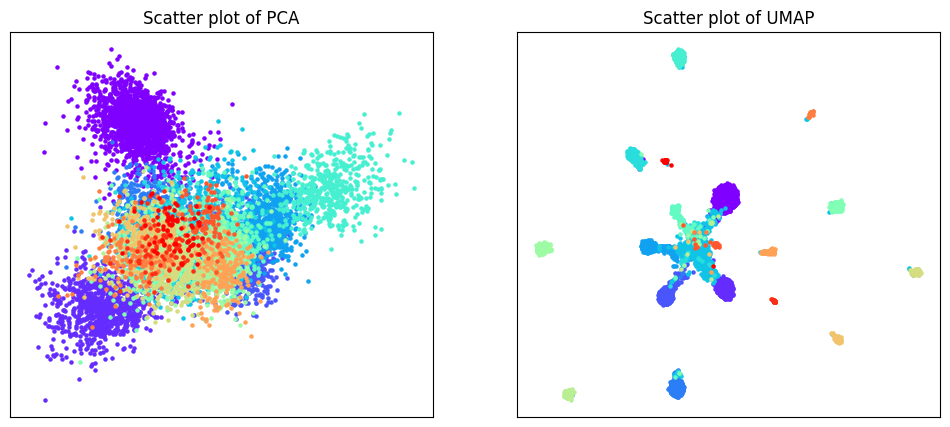

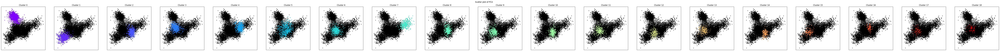

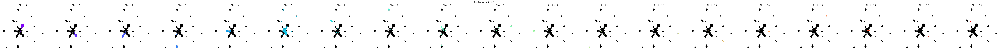

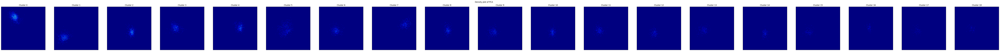

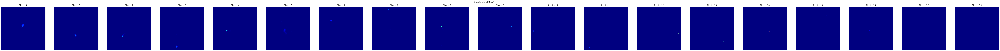

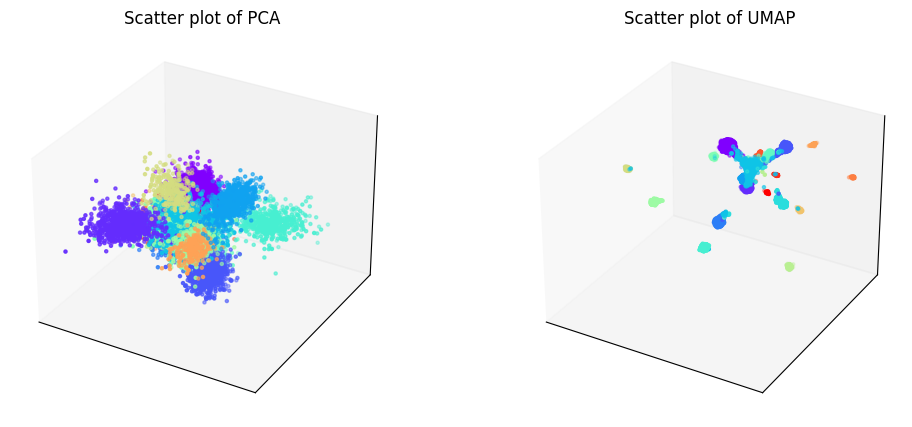

Phylogenetic tree in latent space will be shown below.


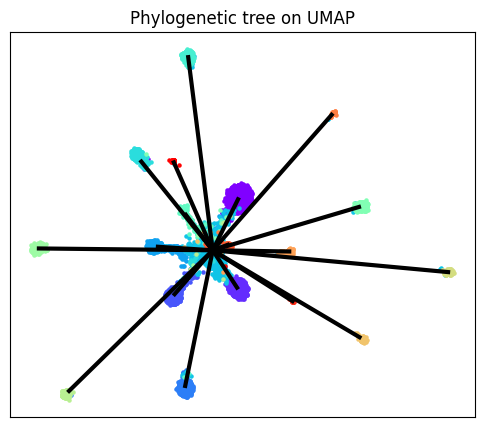

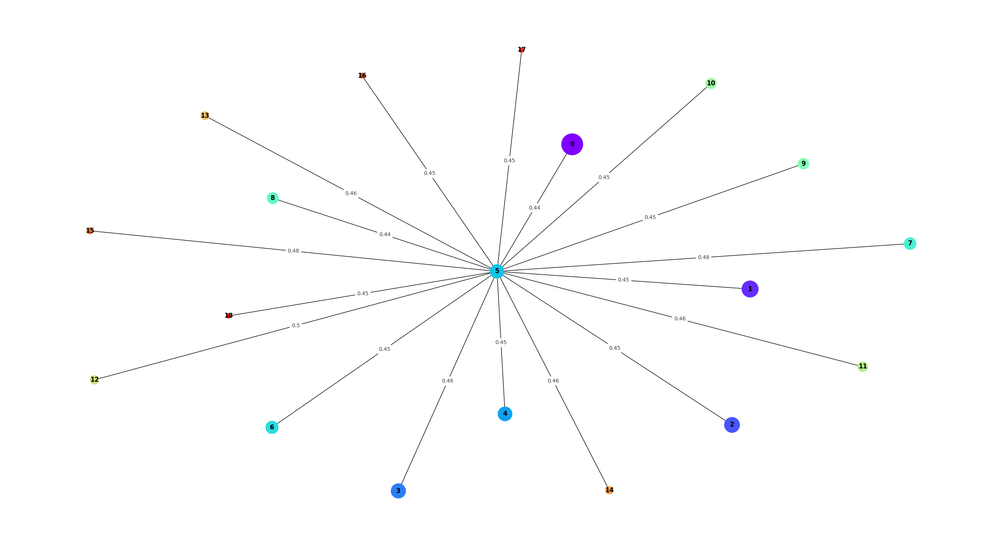

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


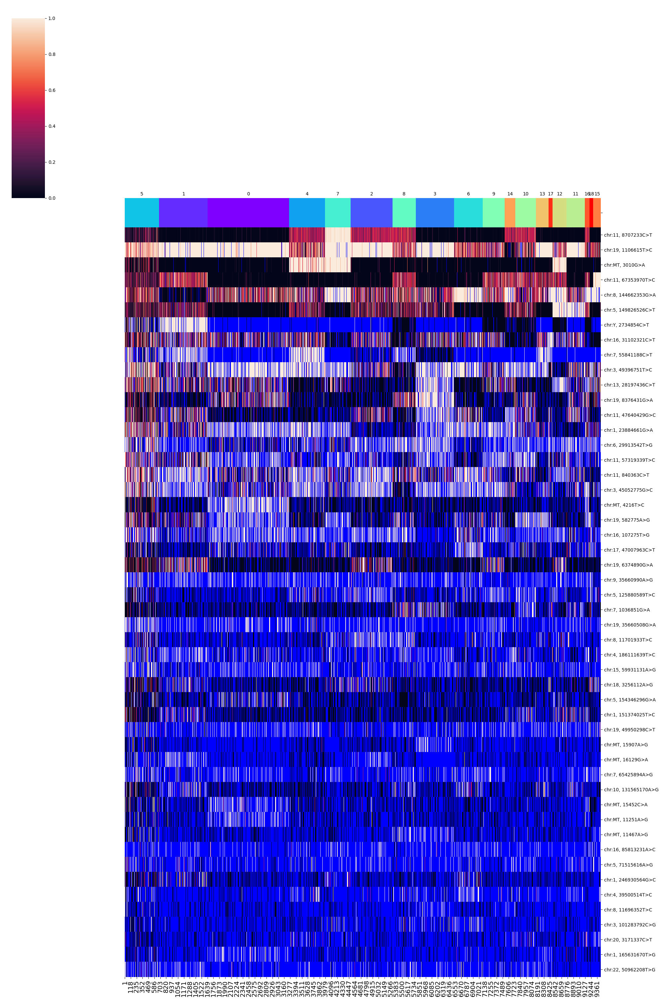

SNPs sorted by lowest p-value will be shown below


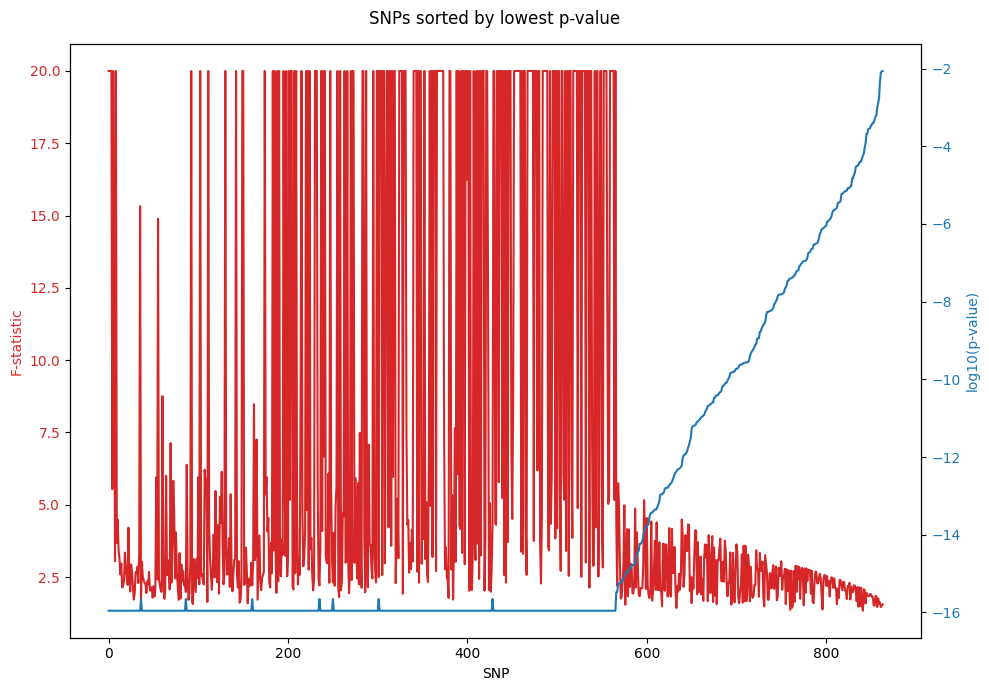

In [17]:
del b_15

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_20 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
b_20.filtering()
b_20.training(beta = 2)
b_20.clustering(algorithm = "leiden_full")
b_20.phylogeny()

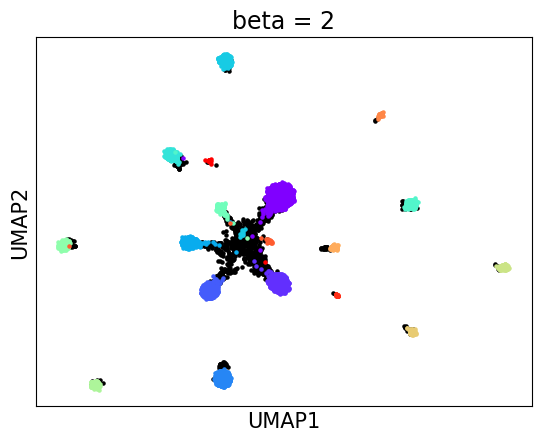

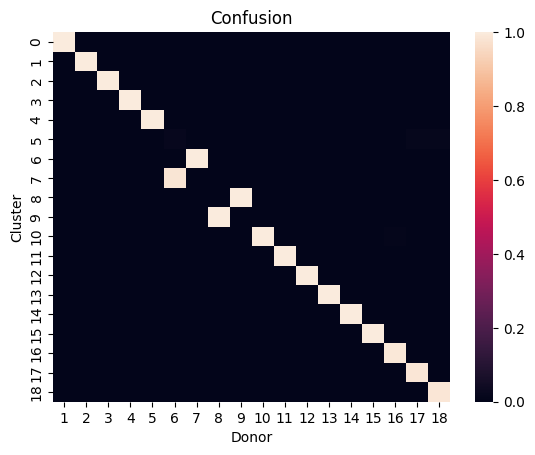

accuracy: 99.59259161140265
silhouette score: 0.8746173385916136


In [18]:
b_20_embedding_2d = b_20.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[b_20.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[b_20.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_20.embedding_2d[donors[18], 0], b_20.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(b_20.embedding_2d[donors[w], 0], b_20.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 2", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = b_20.assigned_label
    
matrix = np.zeros((18, b_20.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(b_20.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(b_20.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_20.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

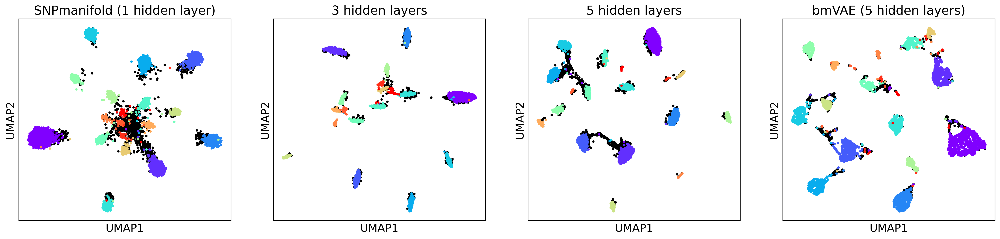

In [21]:
fig, axs = plt.subplots(1, 4, dpi = 300)
fig.set_size_inches(24, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[18], 0], normalized_layer1_embedding_2d[donors[18], 1], s = 5, color = "black")
    
for t in range(18):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

axs[1].scatter(unnormalized_layer3_embedding_2d[donors[18], 0], unnormalized_layer3_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[1].scatter(unnormalized_layer3_embedding_2d[donors[t], 0], unnormalized_layer3_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("3 hidden layers", fontsize = 17)

axs[2].scatter(unnormalized_layer5_embedding_2d[donors[18], 0], unnormalized_layer5_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[2].scatter(unnormalized_layer5_embedding_2d[donors[t], 0], unnormalized_layer5_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("5 hidden layers", fontsize = 17)

axs[3].scatter(bmVAE_embedding_2d[donors[18], 0], bmVAE_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[3].scatter(bmVAE_embedding_2d[donors[t], 0], bmVAE_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("bmVAE (5 hidden layers)", fontsize = 17)
    
plt.show()

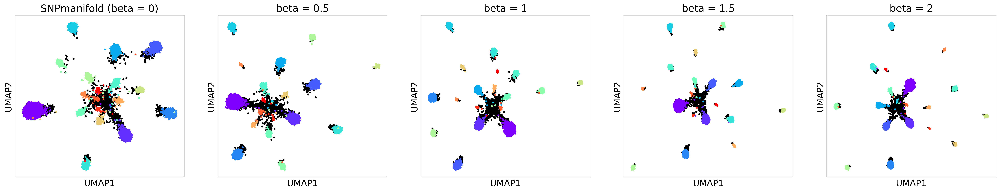

In [22]:
fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[18], 0], normalized_layer1_embedding_2d[donors[18], 1], s = 5, color = "black")
    
for t in range(18):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (beta = 0)", fontsize = 17)

axs[1].scatter(b_05_embedding_2d[donors[18], 0], b_05_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[1].scatter(b_05_embedding_2d[donors[t], 0], b_05_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("beta = 0.5", fontsize = 17)

axs[2].scatter(b_10_embedding_2d[donors[18], 0], b_10_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[2].scatter(b_10_embedding_2d[donors[t], 0], b_10_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("beta = 1", fontsize = 17)

axs[3].scatter(b_15_embedding_2d[donors[18], 0], b_15_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[3].scatter(b_15_embedding_2d[donors[t], 0], b_15_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("beta = 1.5", fontsize = 17)

axs[4].scatter(b_20_embedding_2d[donors[18], 0], b_20_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[4].scatter(b_20_embedding_2d[donors[t], 0], b_20_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)
axs[4].set_title("beta = 2", fontsize = 17)
    
plt.show()

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


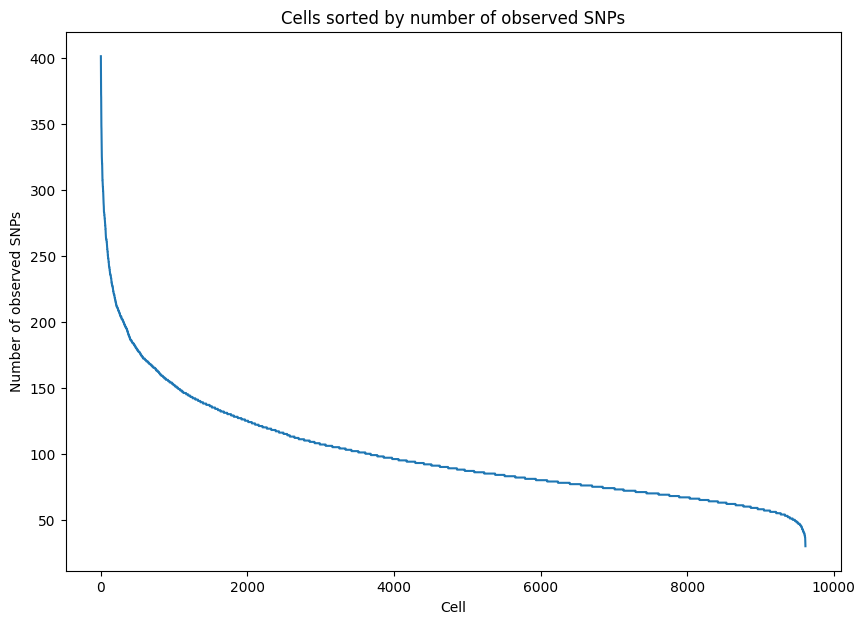

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


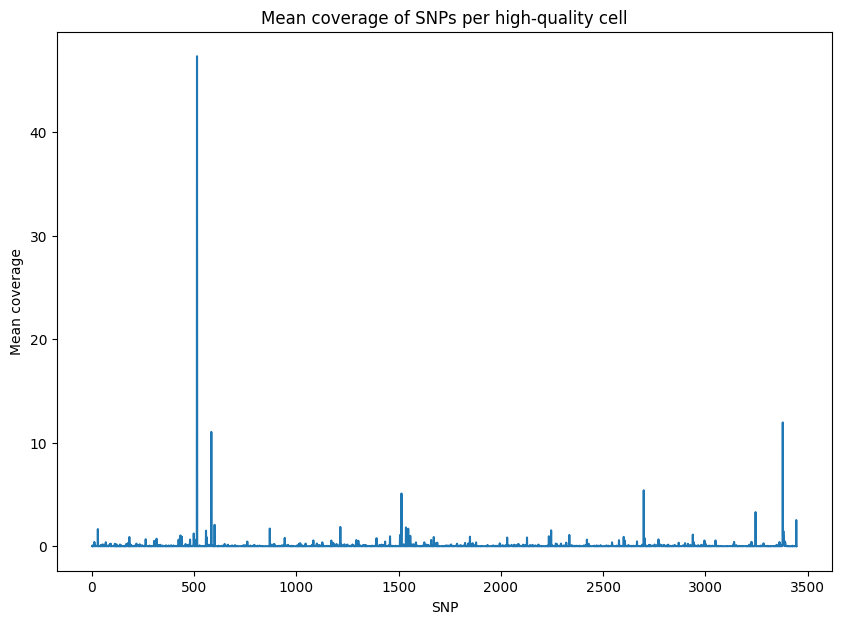

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


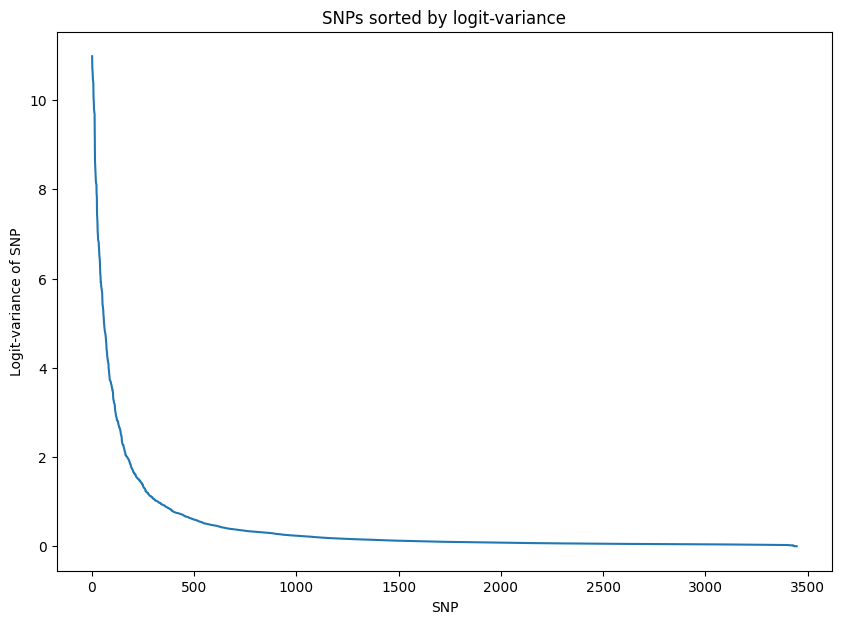

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.361700
Epoch[20/2000], Cost: 1.173116
Epoch[30/2000], Cost: 1.057304
Epoch[40/2000], Cost: 0.982689
Epoch[50/2000], Cost: 0.925836
Epoch[60/2000], Cost: 0.879481
Epoch[70/2000], Cost: 0.839922
Epoch[80/2000], Cost: 0.806284
Epoch[90/2000], Cost: 0.776851
Epoch[100/2000], Cost: 0.751392
Epoch[200/2000], Cost: 0.604073
Epoch[300/2000], Cost: 0.533738
Epoch[400/2000], Cost: 0.490894
Epoch[500/2000], Cost: 0.462451
Epoch[600/2000], Cost: 0.442533
Epoch[700/2000], Cost: 0.427997
Epoch[800/2000], Cost: 0.416907
Epoch[900/2000], Cost: 0.408211
Epoch[1000/2000], Cost: 0.401155
Epoch[1100/2000], Cost: 0.395361
Epoch[1200/2000], Cost: 0.390457
Epoch[1300/2000], Cost: 0.386272
Epoch[1400/2000], Cost: 0.382656
Epoch[1500/2000], Cost: 0.379475
Epoch[1600/200

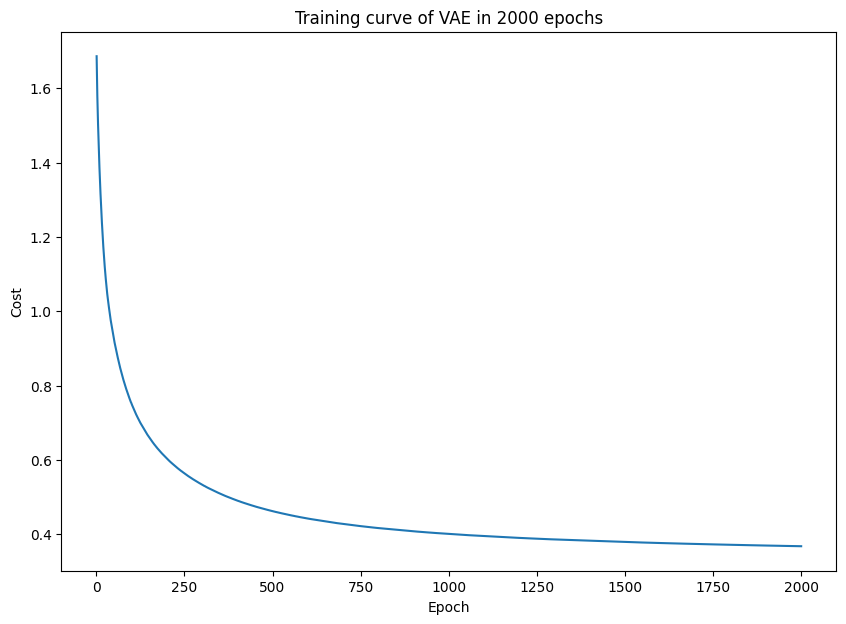

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


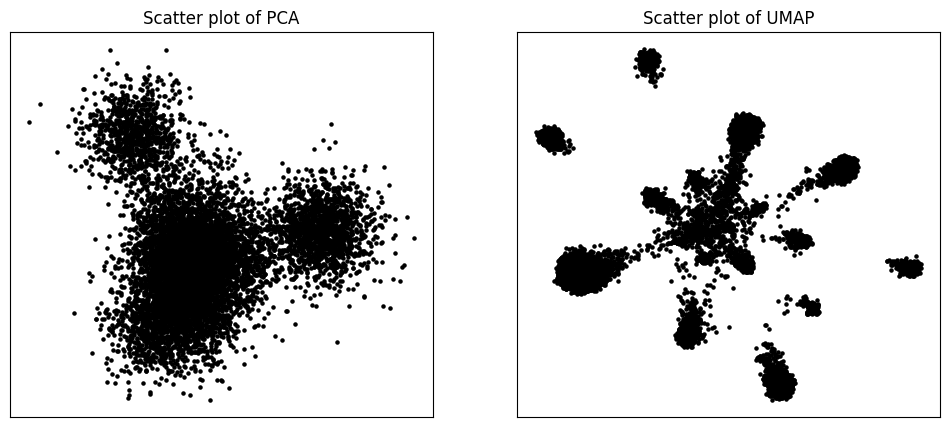

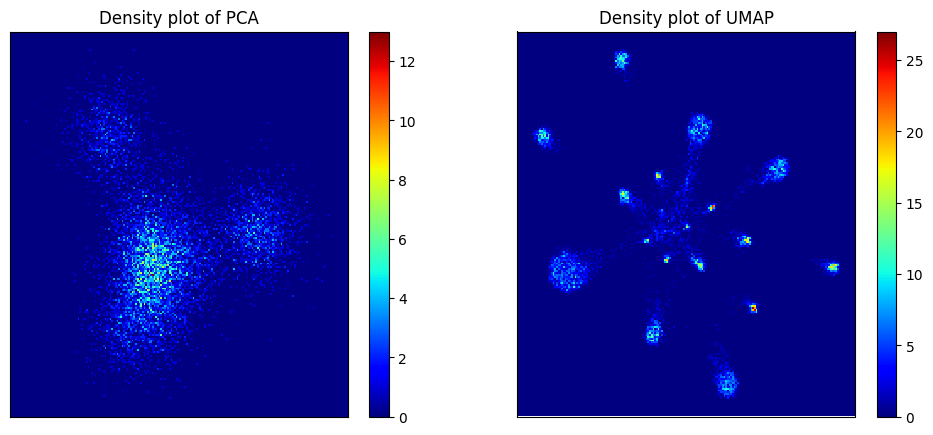

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


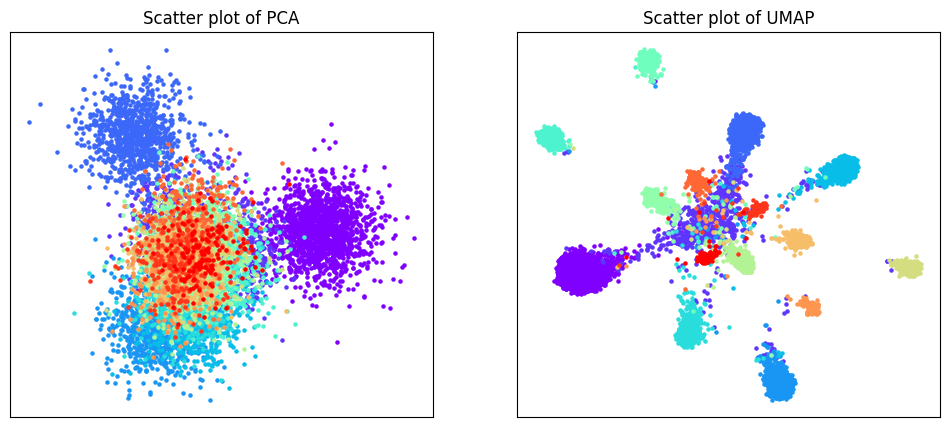

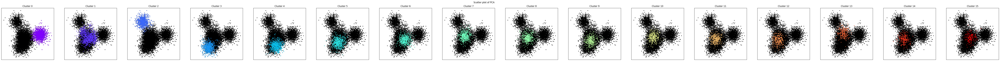

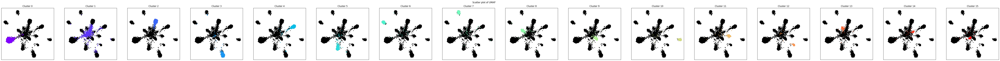

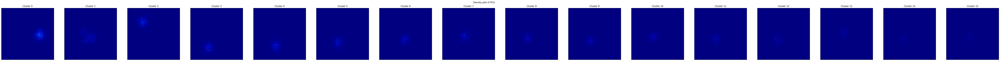

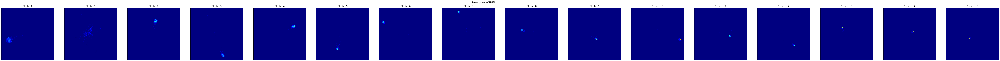

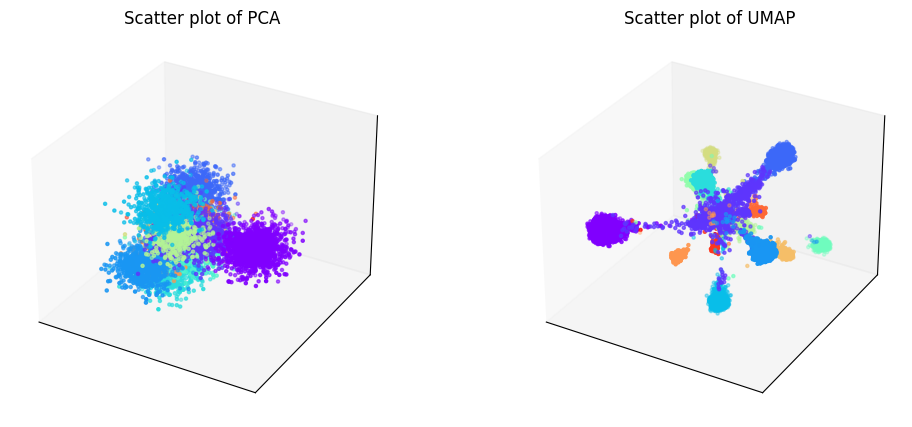

Phylogenetic tree in latent space will be shown below.


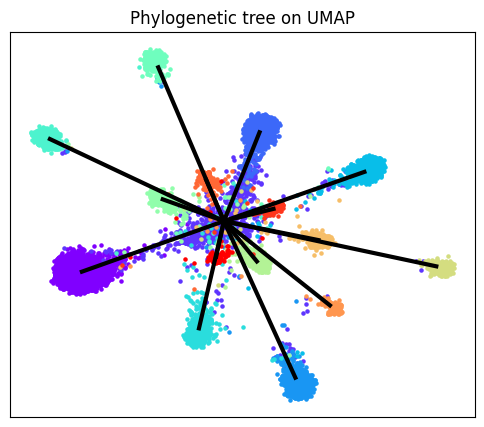

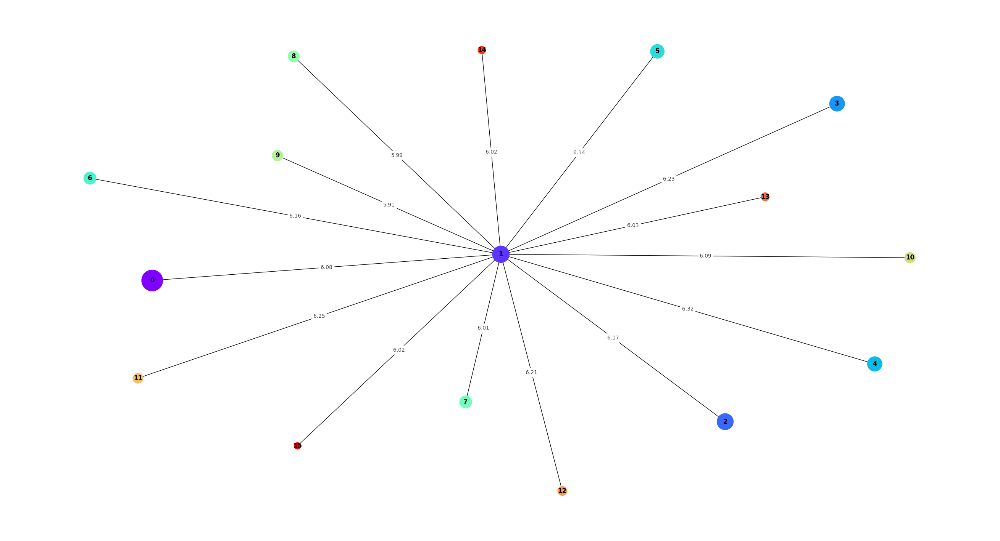

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


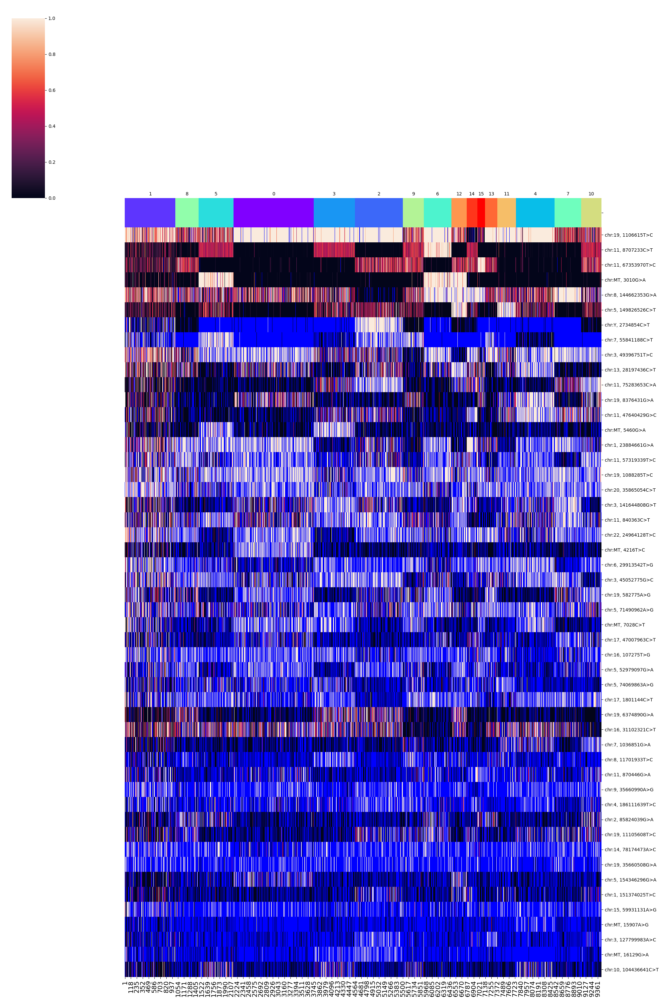

SNPs sorted by lowest p-value will be shown below


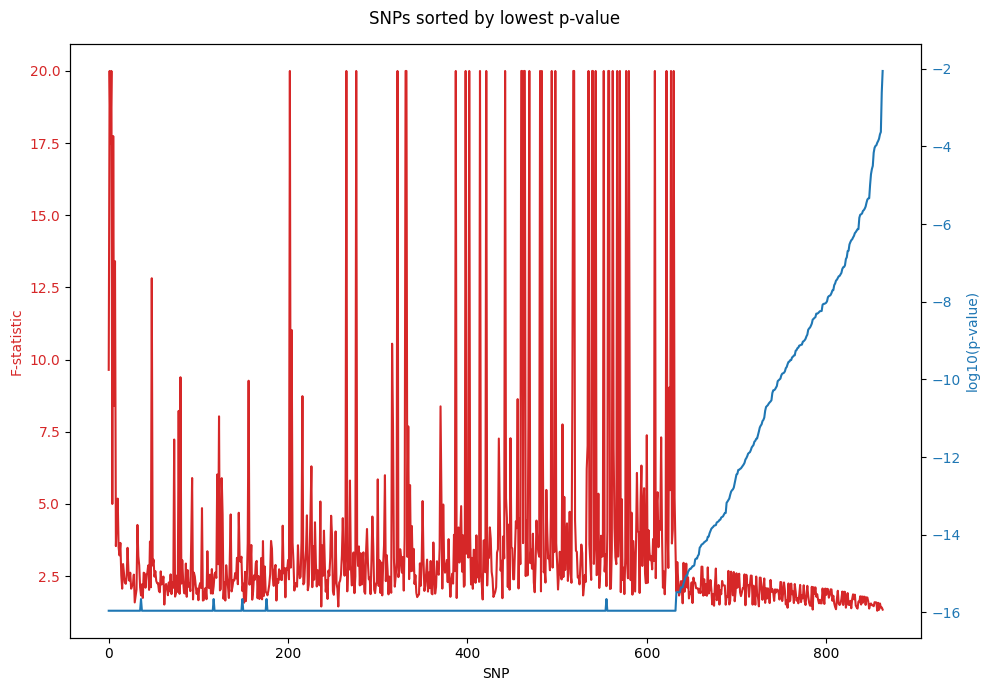

In [23]:
del b_20

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_10 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
D_10.filtering()
D_10.training(z_dim = np.ceil(864 / 10).astype(int))
D_10.clustering(algorithm = "leiden_full")
D_10.phylogeny()

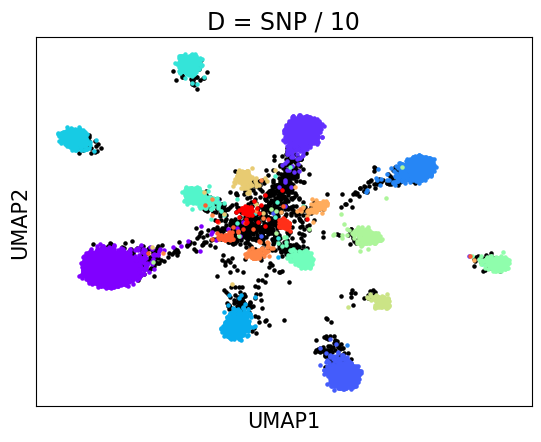

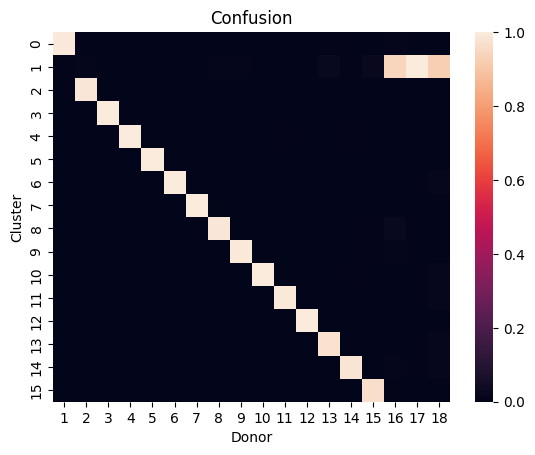

accuracy: 98.48111457679559
silhouette score: 0.8114025909339649


In [24]:
D_10_embedding_2d = D_10.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[D_10.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[D_10.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_10.embedding_2d[donors[18], 0], D_10.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(D_10.embedding_2d[donors[w], 0], D_10.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 10", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = D_10.assigned_label
    
matrix = np.zeros((18, D_10.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(D_10.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(D_10.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_10.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


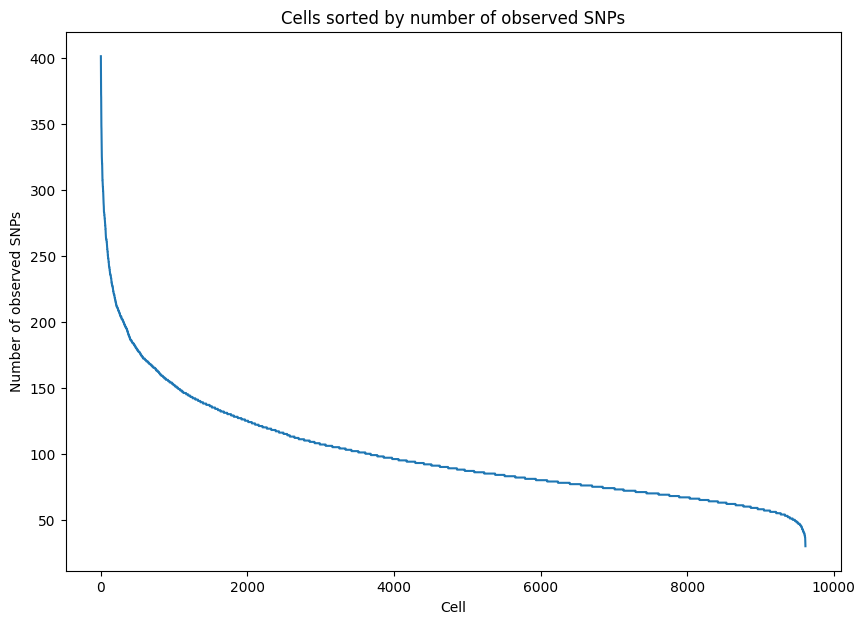

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


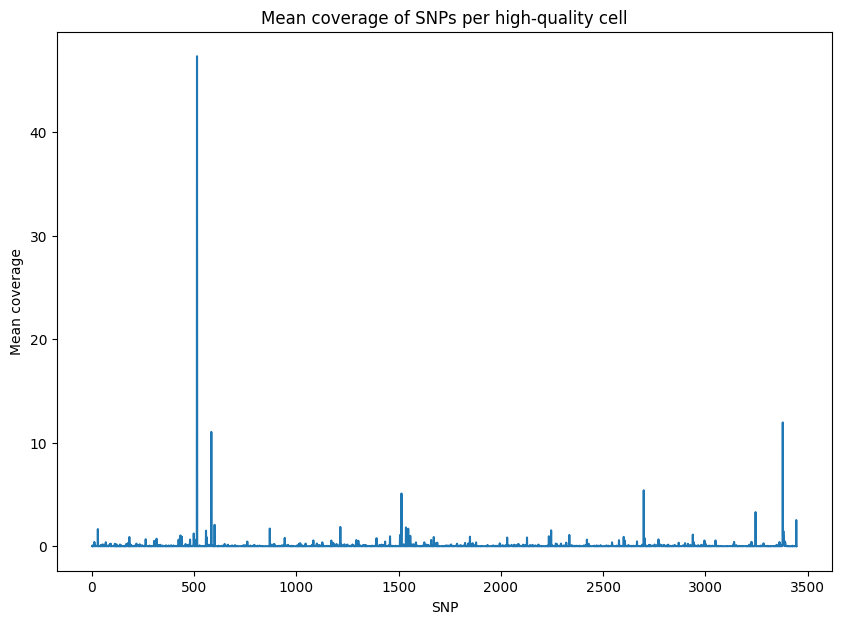

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


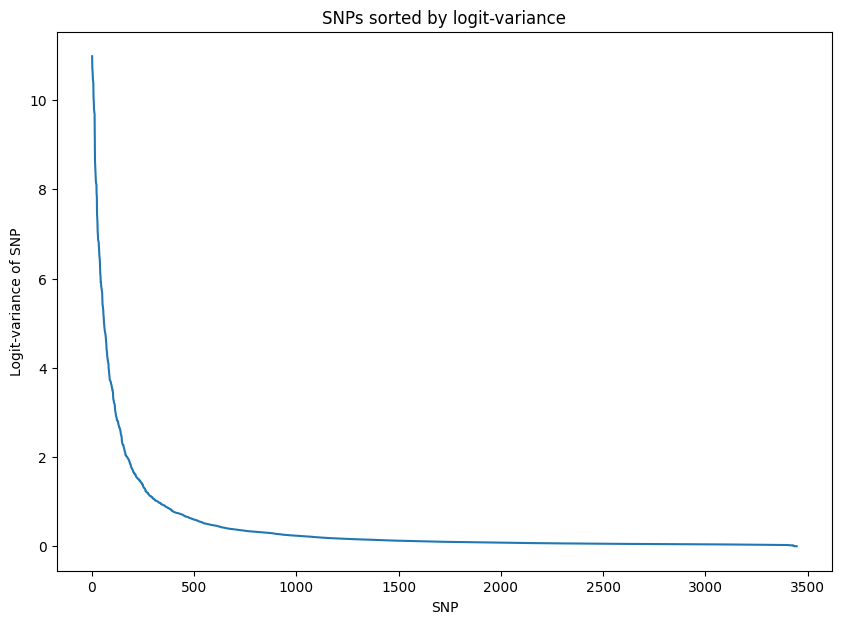

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.447868
Epoch[20/2000], Cost: 1.309032
Epoch[30/2000], Cost: 1.211746
Epoch[40/2000], Cost: 1.140989
Epoch[50/2000], Cost: 1.087098
Epoch[60/2000], Cost: 1.044959
Epoch[70/2000], Cost: 1.011157
Epoch[80/2000], Cost: 0.982599
Epoch[90/2000], Cost: 0.956190
Epoch[100/2000], Cost: 0.932727
Epoch[200/2000], Cost: 0.776751
Epoch[300/2000], Cost: 0.701363
Epoch[400/2000], Cost: 0.658383
Epoch[500/2000], Cost: 0.631170
Epoch[600/2000], Cost: 0.613363
Epoch[700/2000], Cost: 0.601392
Epoch[800/2000], Cost: 0.592983
Epoch[900/2000], Cost: 0.586925
Epoch[1000/2000], Cost: 0.582214
Epoch[1100/2000], Cost: 0.578492
Epoch[1200/2000], Cost: 0.575450
Epoch[1300/2000], Cost: 0.572883
Epoch[1400/2000], Cost: 0.570736
Epoch[1500/2000], Cost: 0.568833
Epoch[1600/200

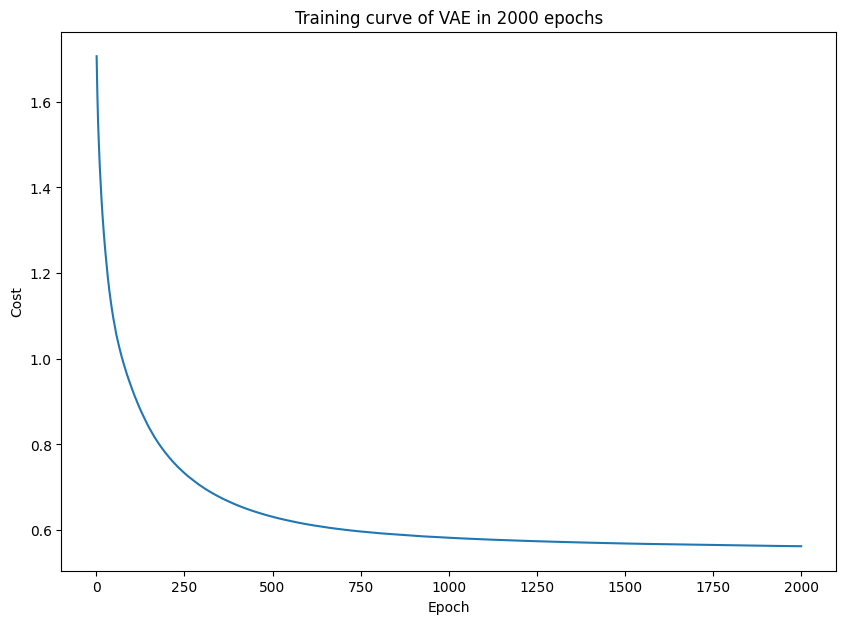

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


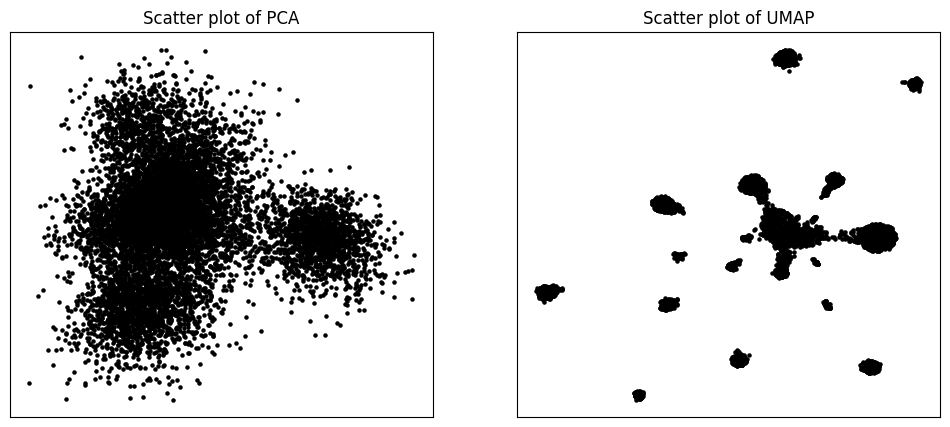

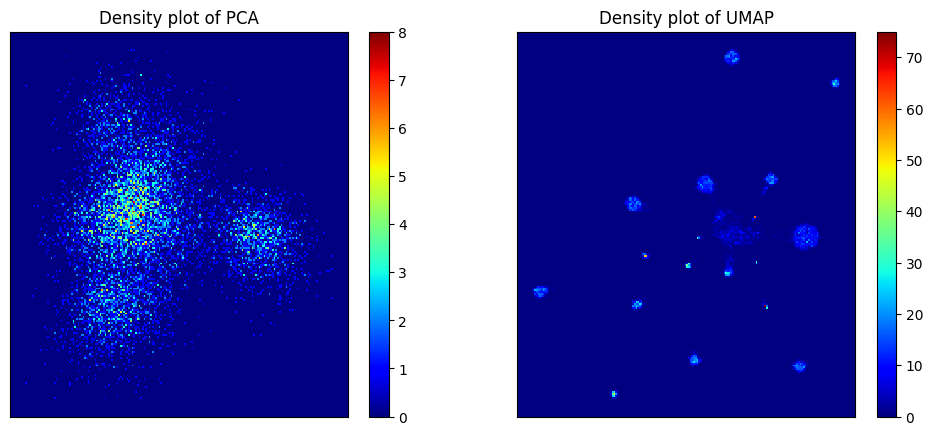

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


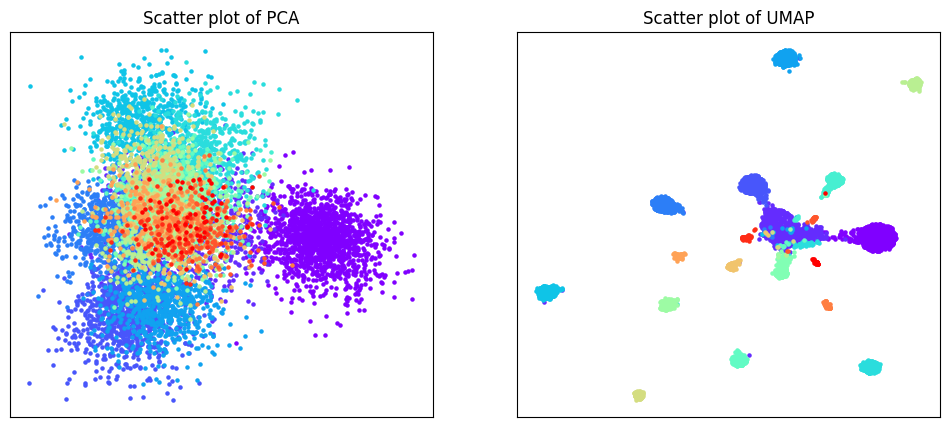

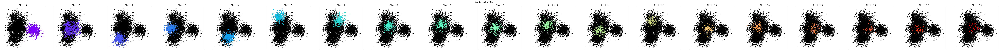

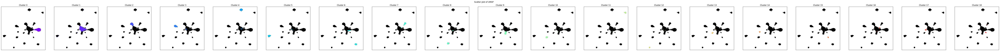

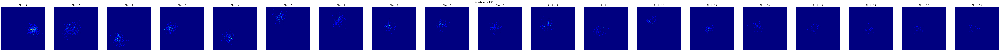

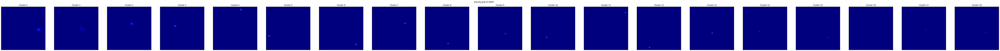

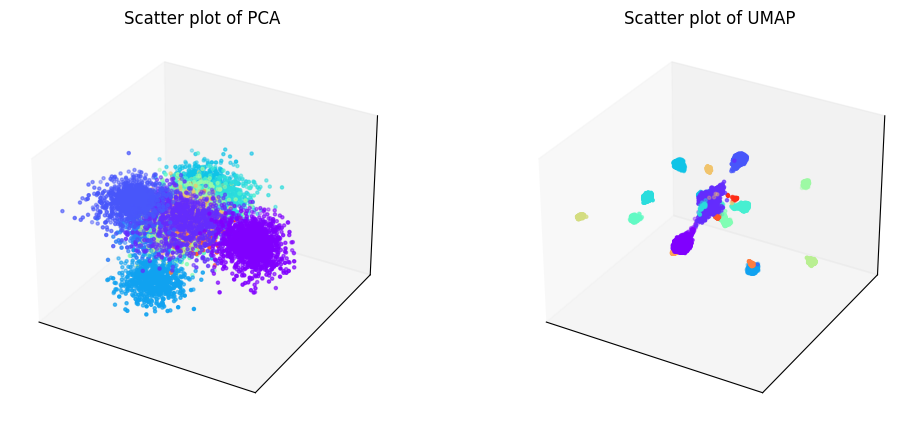

Phylogenetic tree in latent space will be shown below.


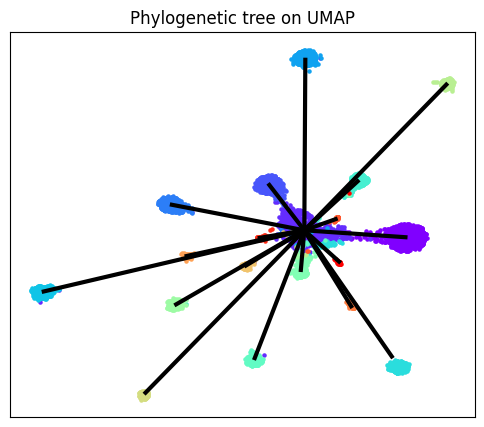

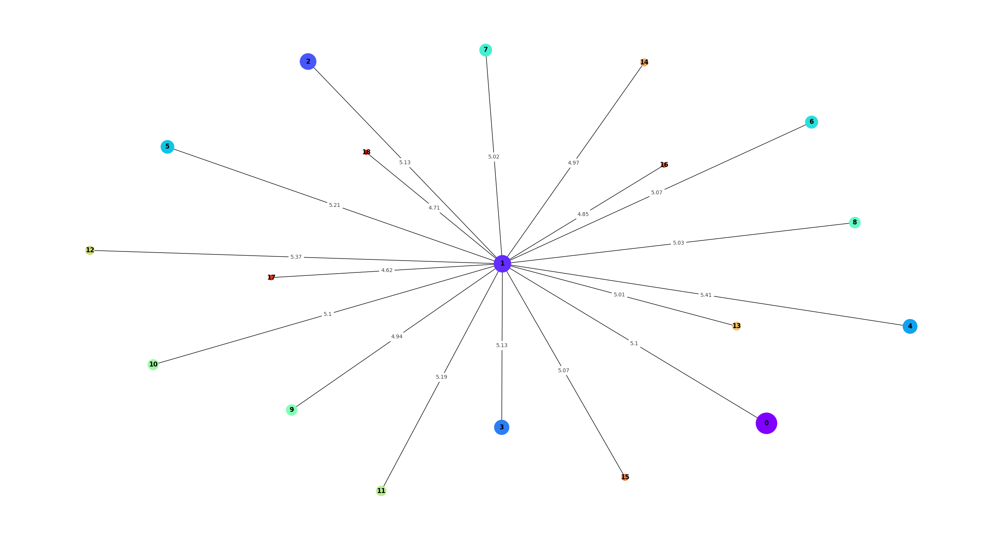

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


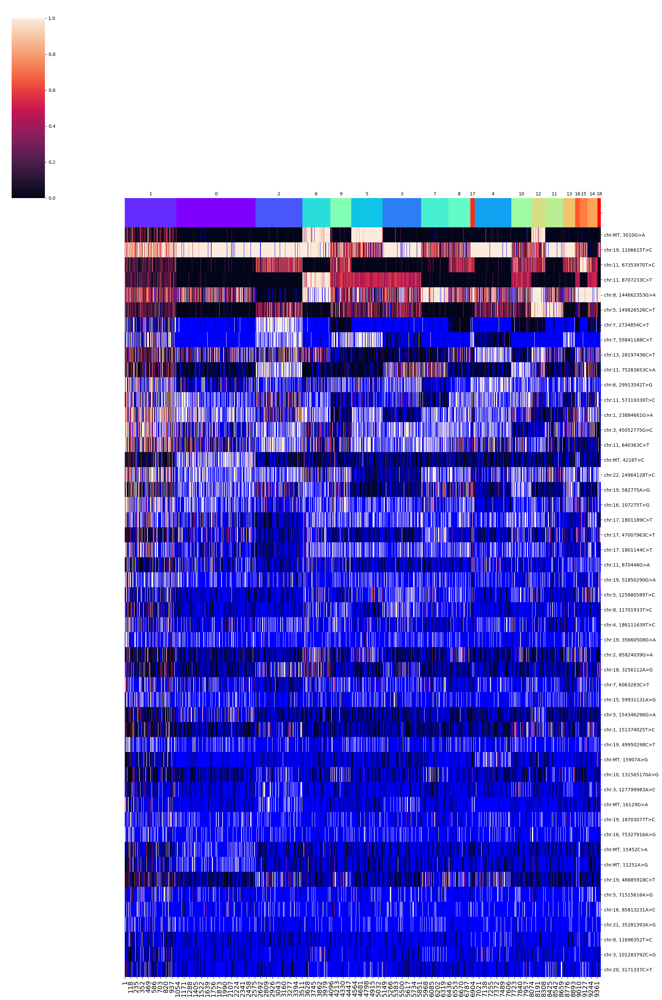

SNPs sorted by lowest p-value will be shown below


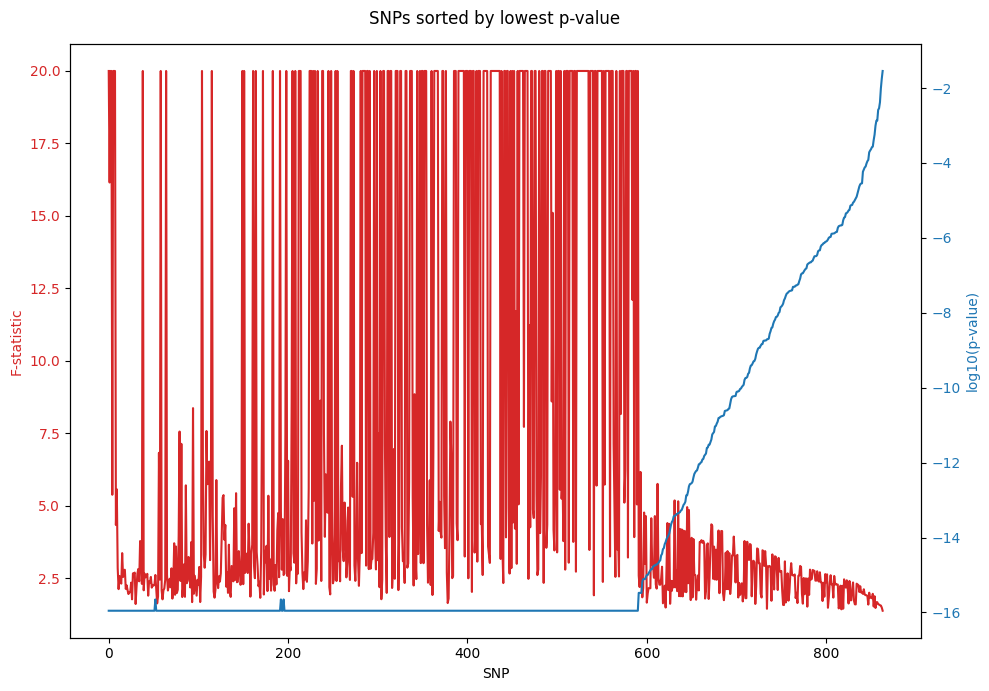

In [25]:
del D_10

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_30 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
D_30.filtering()
D_30.training(z_dim = np.ceil(864 / 30).astype(int))
D_30.clustering(algorithm = "leiden_full")
D_30.phylogeny()

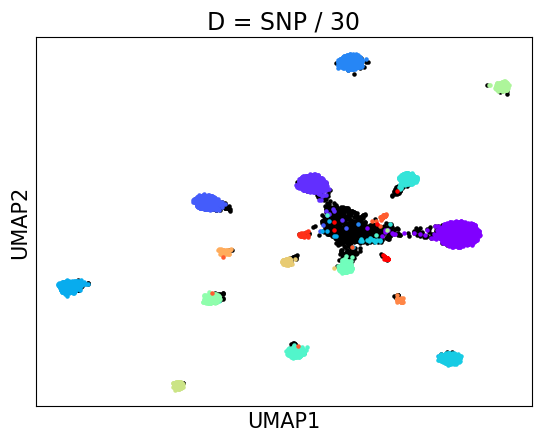

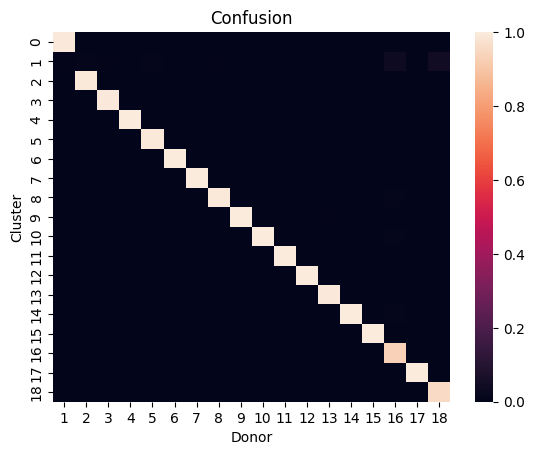

accuracy: 99.07334450219284
silhouette score: 0.8642295771061905


In [26]:
D_30_embedding_2d = D_30.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[D_30.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[D_30.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_30.embedding_2d[donors[18], 0], D_30.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(D_30.embedding_2d[donors[w], 0], D_30.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 30", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = D_30.assigned_label
    
matrix = np.zeros((18, D_30.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(D_30.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(D_30.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_30.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


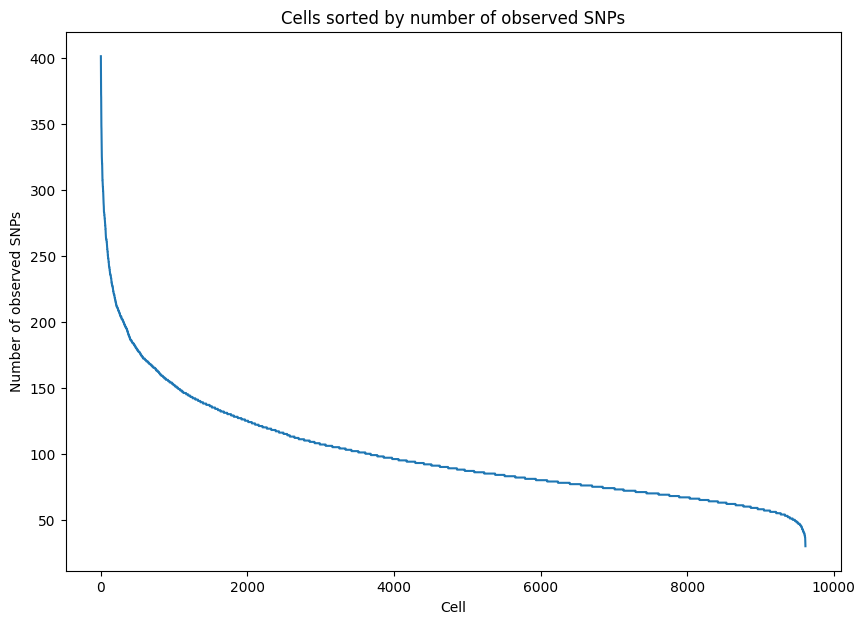

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


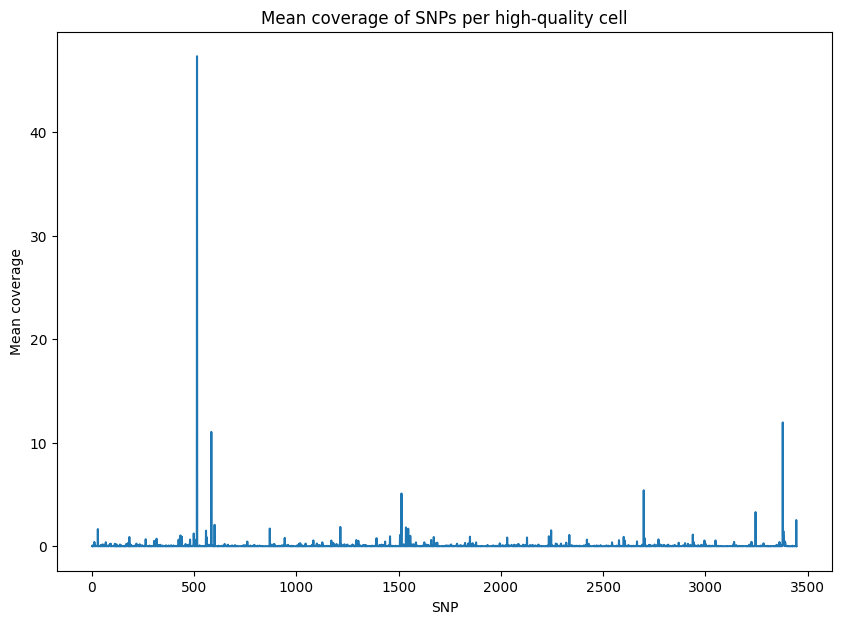

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


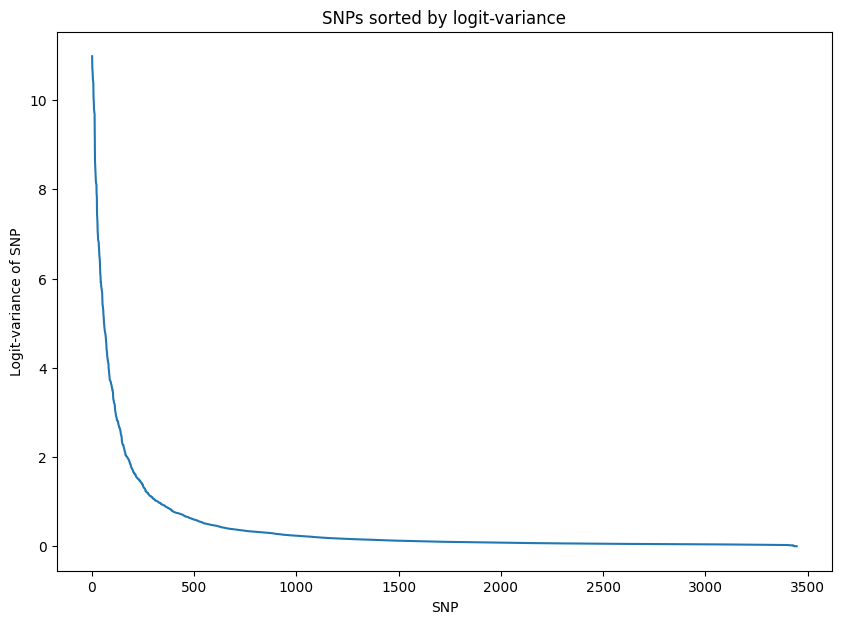

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.487162
Epoch[20/2000], Cost: 1.375852
Epoch[30/2000], Cost: 1.297902
Epoch[40/2000], Cost: 1.235299
Epoch[50/2000], Cost: 1.183400
Epoch[60/2000], Cost: 1.137368
Epoch[70/2000], Cost: 1.098256
Epoch[80/2000], Cost: 1.065259
Epoch[90/2000], Cost: 1.036883
Epoch[100/2000], Cost: 1.012595
Epoch[200/2000], Cost: 0.866817
Epoch[300/2000], Cost: 0.787579
Epoch[400/2000], Cost: 0.739628
Epoch[500/2000], Cost: 0.707400
Epoch[600/2000], Cost: 0.684668
Epoch[700/2000], Cost: 0.668577
Epoch[800/2000], Cost: 0.657174
Epoch[900/2000], Cost: 0.649009
Epoch[1000/2000], Cost: 0.643084
Epoch[1100/2000], Cost: 0.638734
Epoch[1200/2000], Cost: 0.635466
Epoch[1300/2000], Cost: 0.632930
Epoch[1400/2000], Cost: 0.630903
Epoch[1500/2000], Cost: 0.629248
Epoch[1600/200

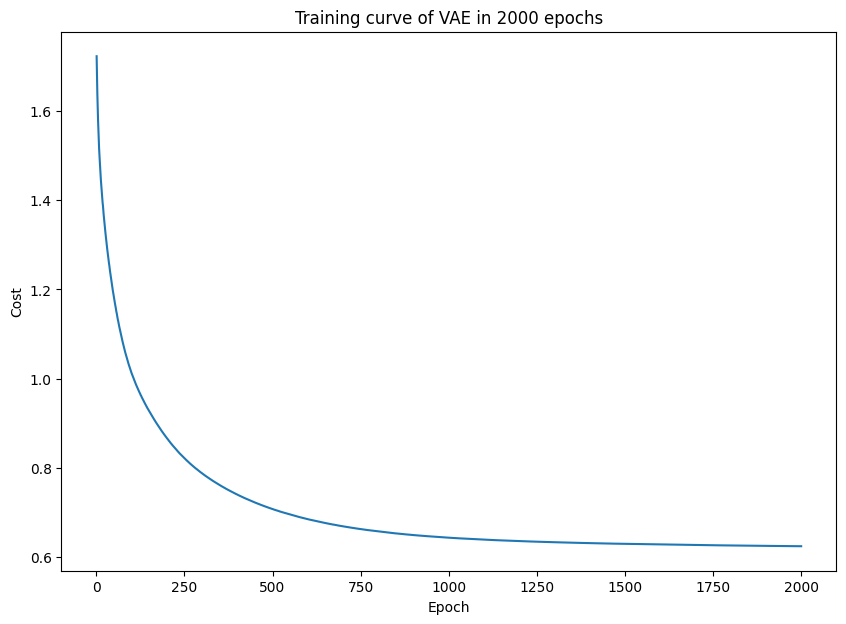

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


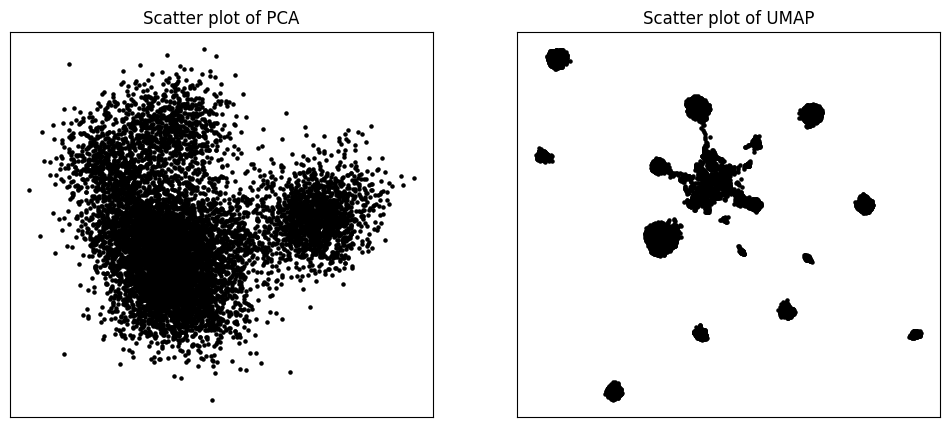

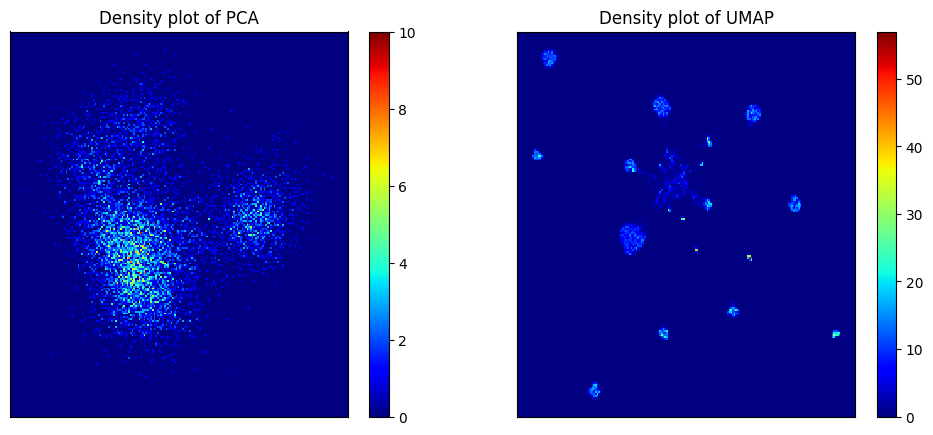

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


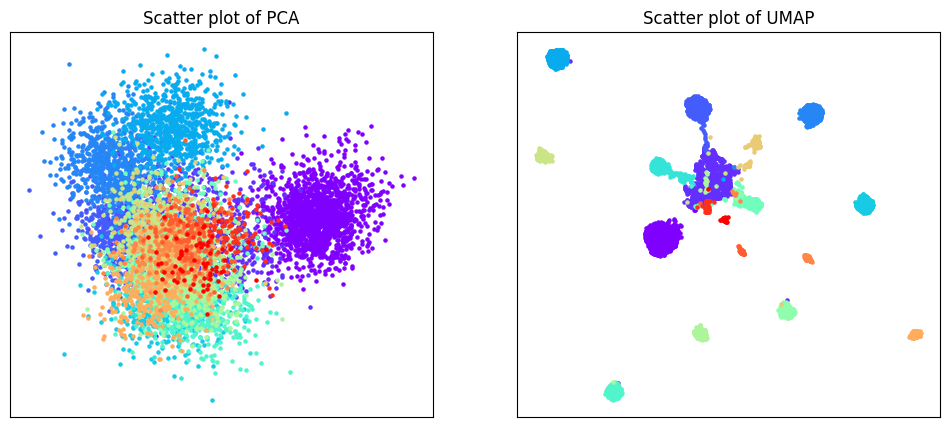

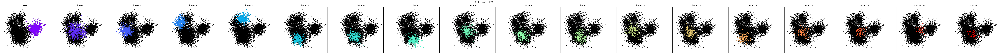

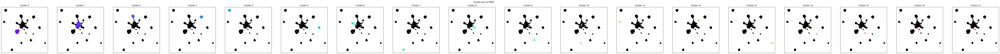

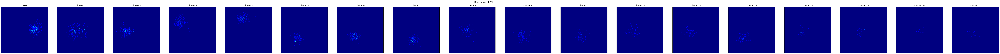

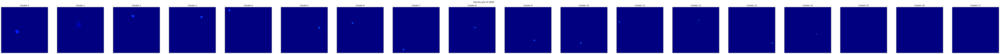

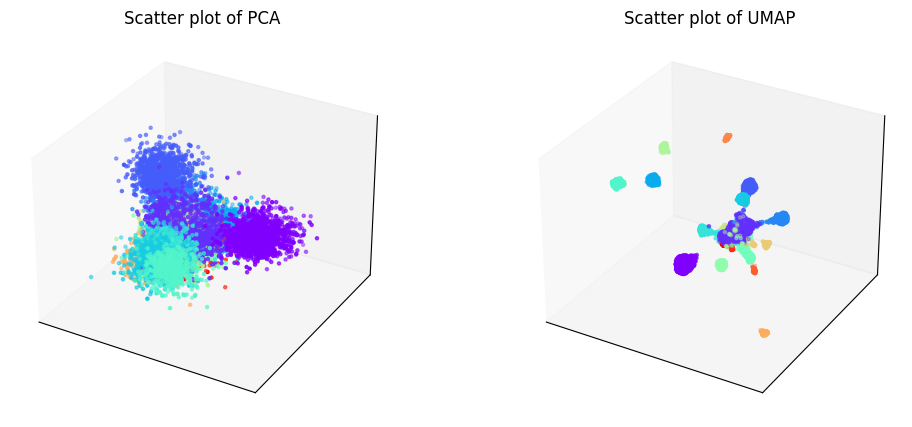

Phylogenetic tree in latent space will be shown below.


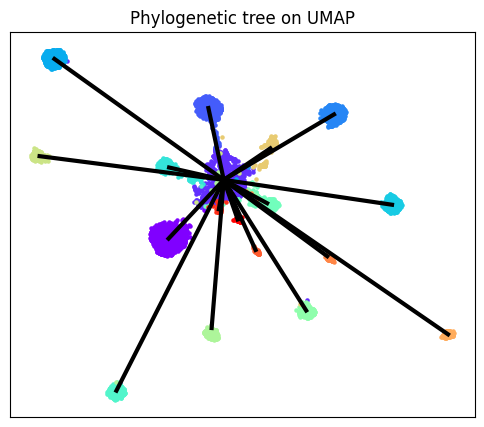

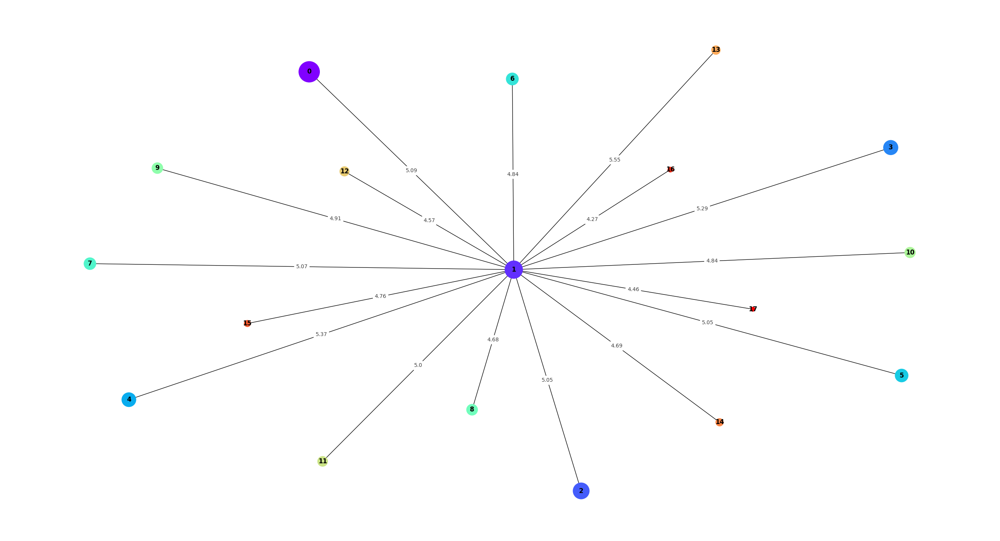

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


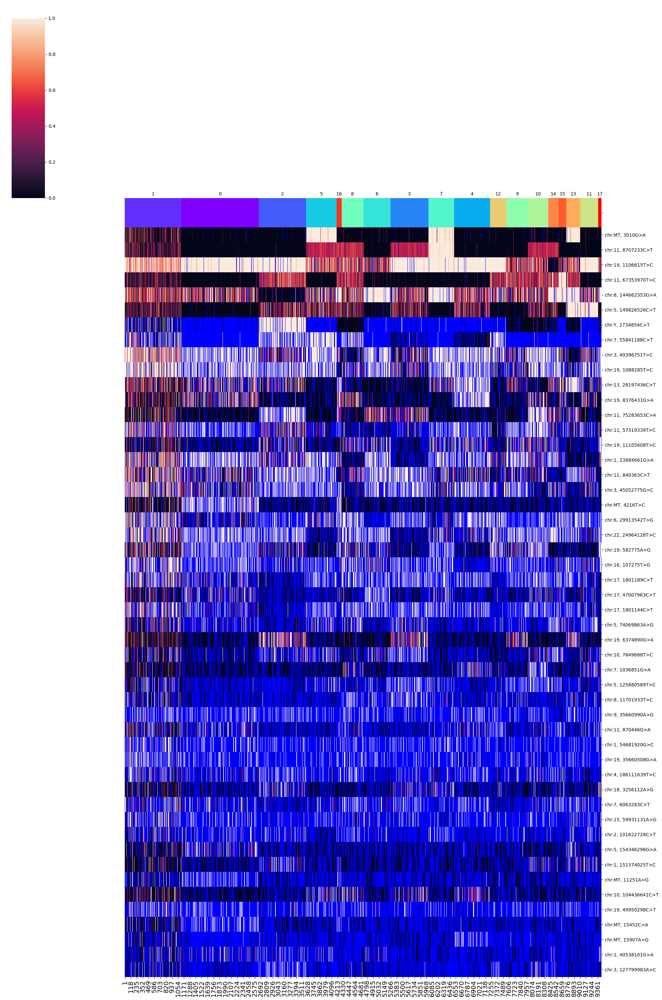

SNPs sorted by lowest p-value will be shown below


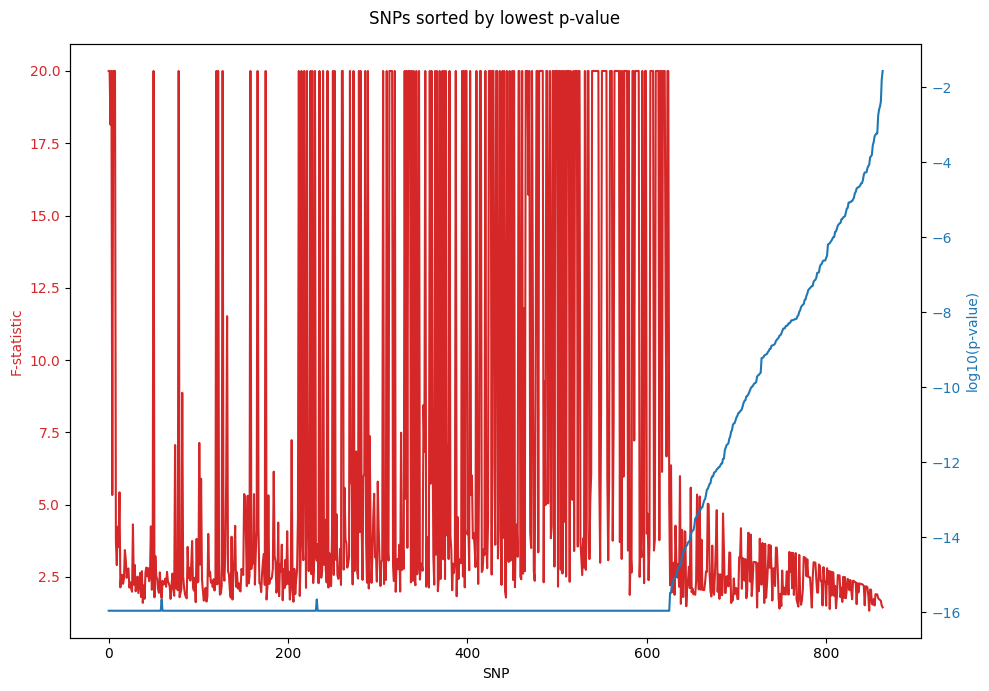

In [27]:
del D_30

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_50 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
D_50.filtering()
D_50.training(z_dim = np.ceil(864 / 50).astype(int))
D_50.clustering(algorithm = "leiden_full")
D_50.phylogeny()

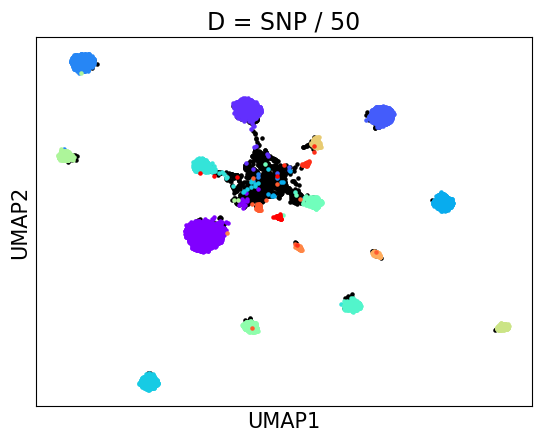

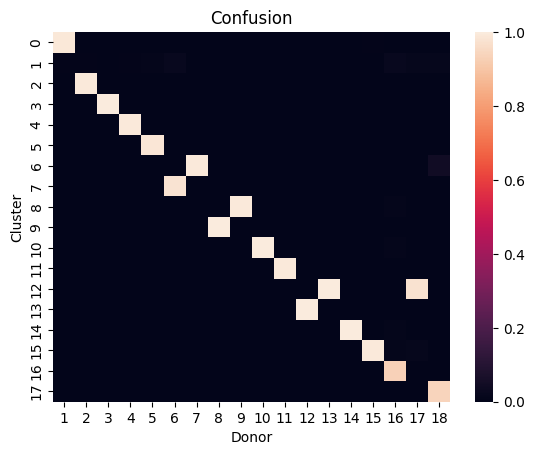

accuracy: 98.69597158536335
silhouette score: 0.8567676373199082


In [28]:
D_50_embedding_2d = D_50.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[D_50.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[D_50.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_50.embedding_2d[donors[18], 0], D_50.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(D_50.embedding_2d[donors[w], 0], D_50.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 50", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = D_50.assigned_label
    
matrix = np.zeros((18, D_50.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(D_50.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(D_50.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_50.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


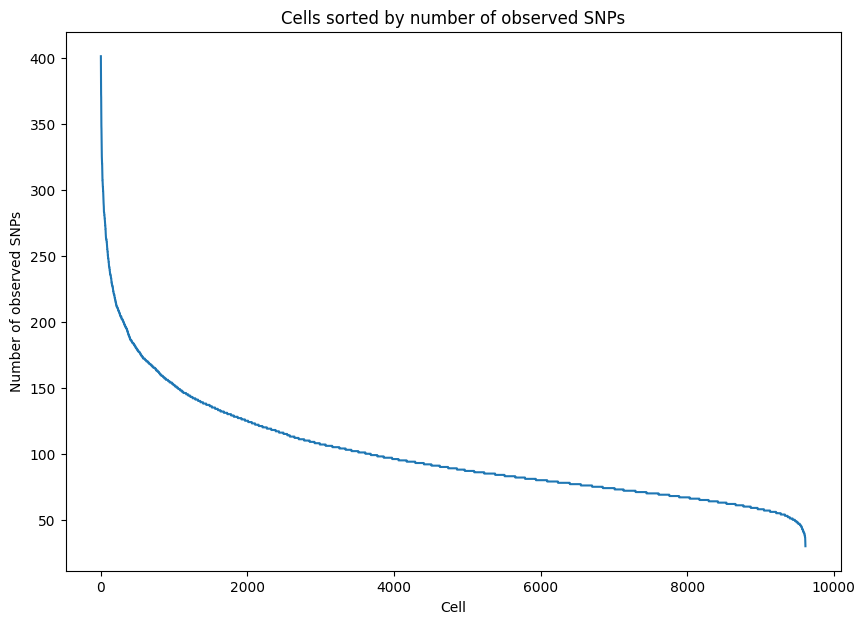

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


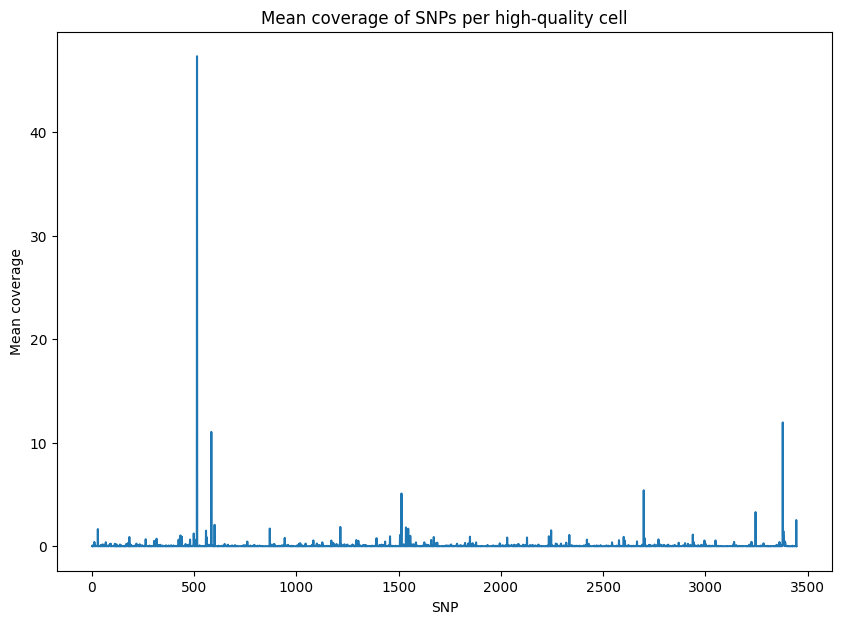

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


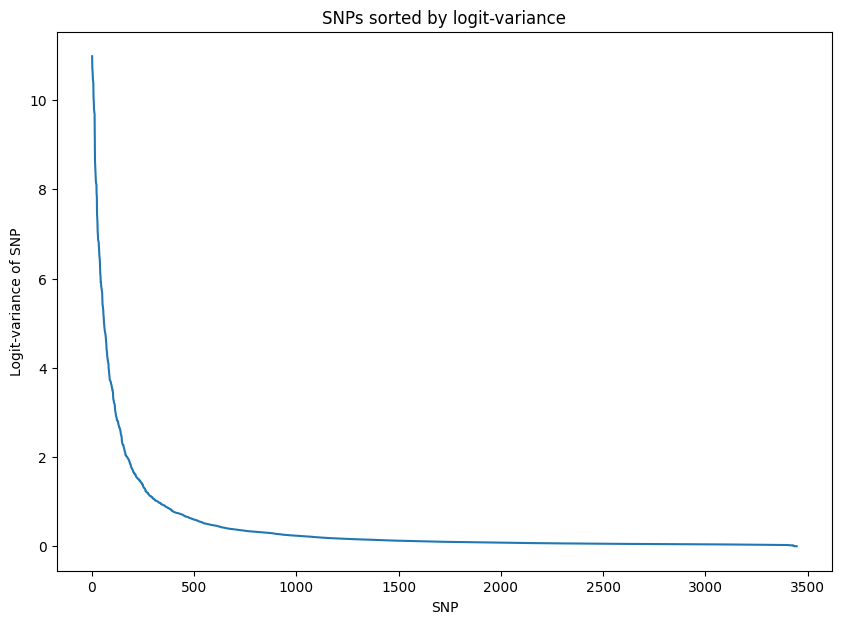

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.514419
Epoch[20/2000], Cost: 1.425817
Epoch[30/2000], Cost: 1.368447
Epoch[40/2000], Cost: 1.322714
Epoch[50/2000], Cost: 1.285397
Epoch[60/2000], Cost: 1.253497
Epoch[70/2000], Cost: 1.225529
Epoch[80/2000], Cost: 1.199514
Epoch[90/2000], Cost: 1.176502
Epoch[100/2000], Cost: 1.155489
Epoch[200/2000], Cost: 1.018128
Epoch[300/2000], Cost: 0.938614
Epoch[400/2000], Cost: 0.883958
Epoch[500/2000], Cost: 0.843918
Epoch[600/2000], Cost: 0.812513
Epoch[700/2000], Cost: 0.787681
Epoch[800/2000], Cost: 0.769166
Epoch[900/2000], Cost: 0.755591
Epoch[1000/2000], Cost: 0.745987
Epoch[1100/2000], Cost: 0.739187
Epoch[1200/2000], Cost: 0.734416
Epoch[1300/2000], Cost: 0.730955
Epoch[1400/2000], Cost: 0.728417
Epoch[1500/2000], Cost: 0.726532
Epoch[1600/200

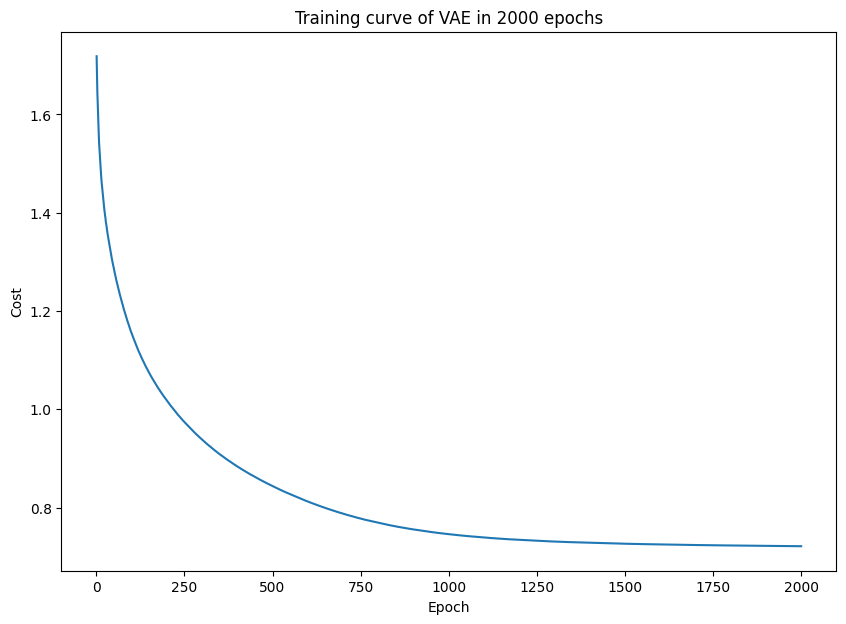

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


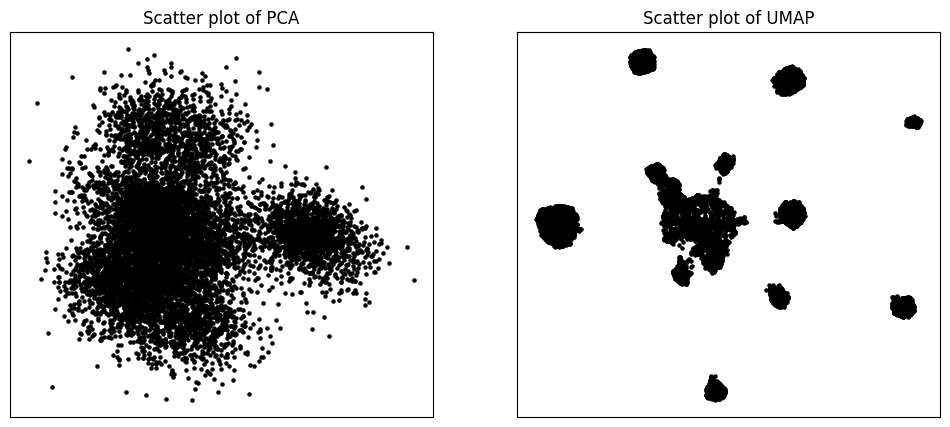

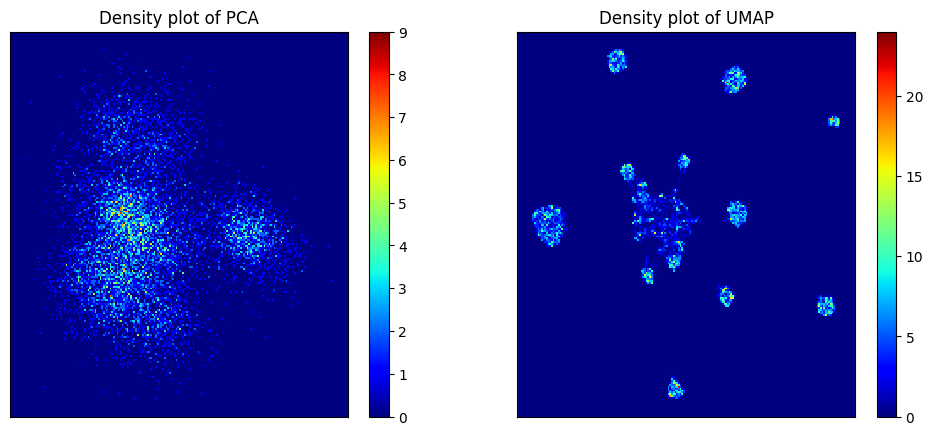

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


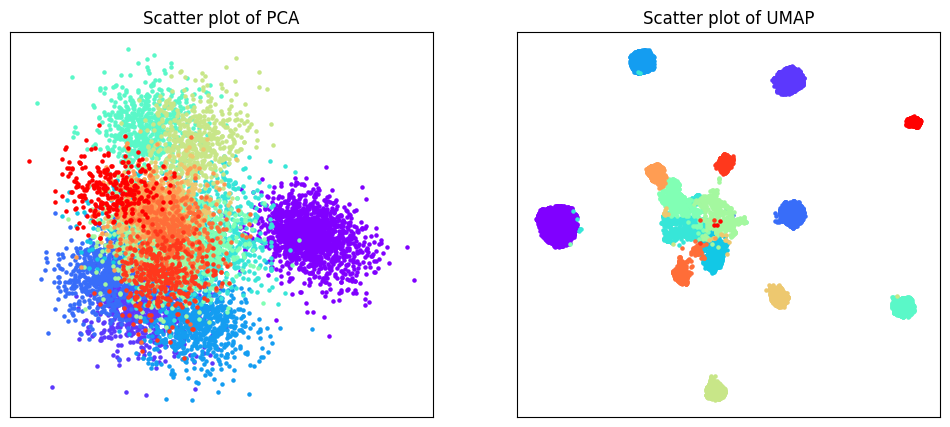

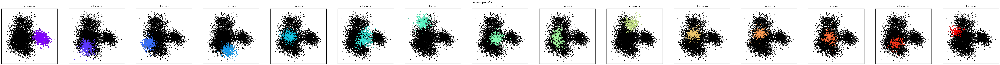

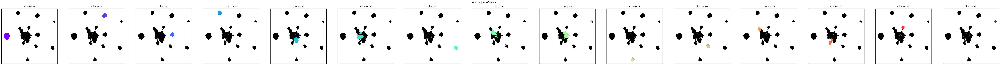

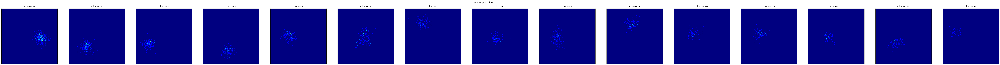

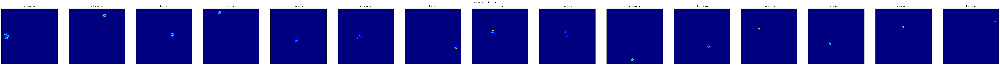

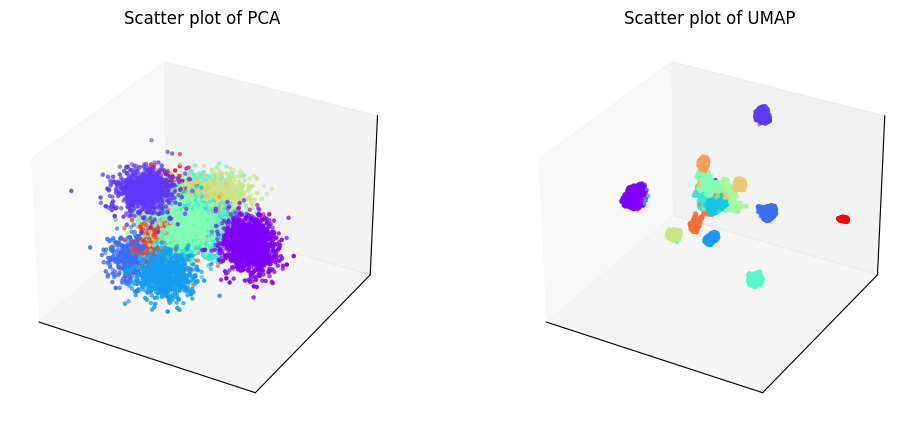

Phylogenetic tree in latent space will be shown below.


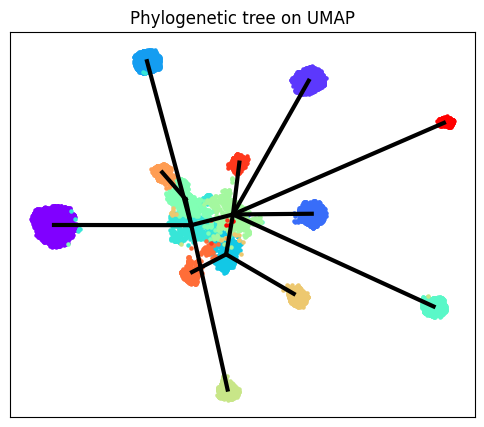

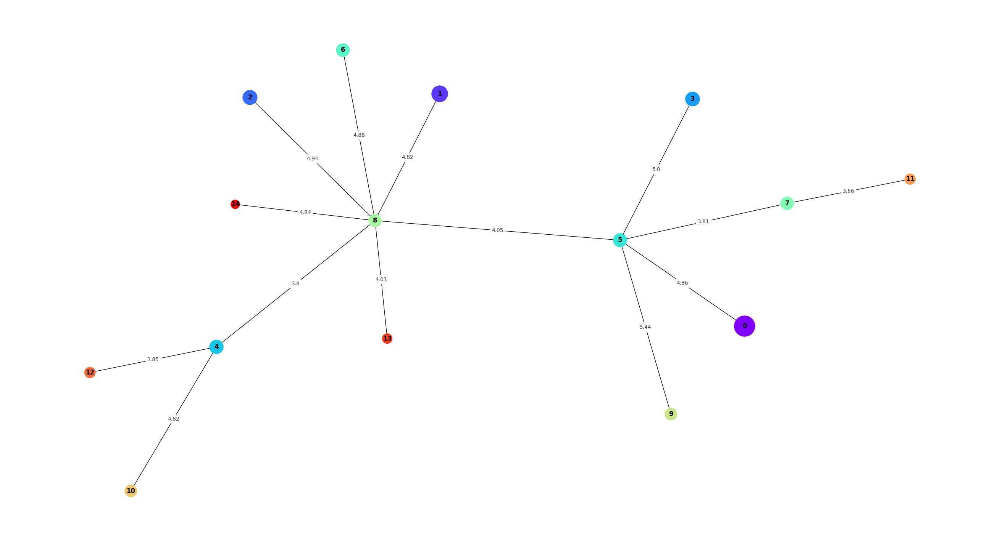

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


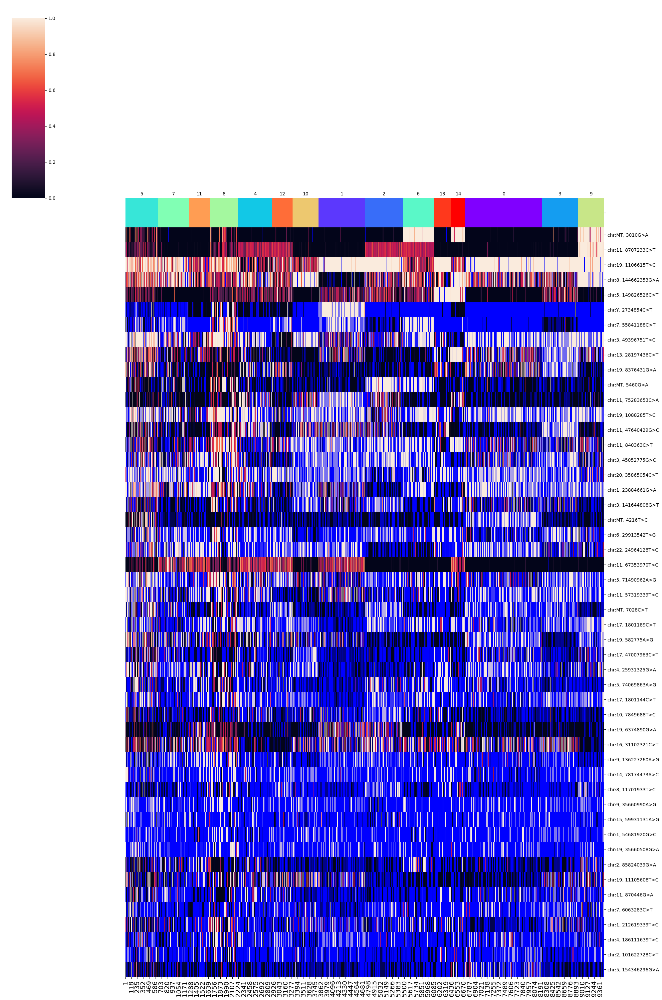

SNPs sorted by lowest p-value will be shown below


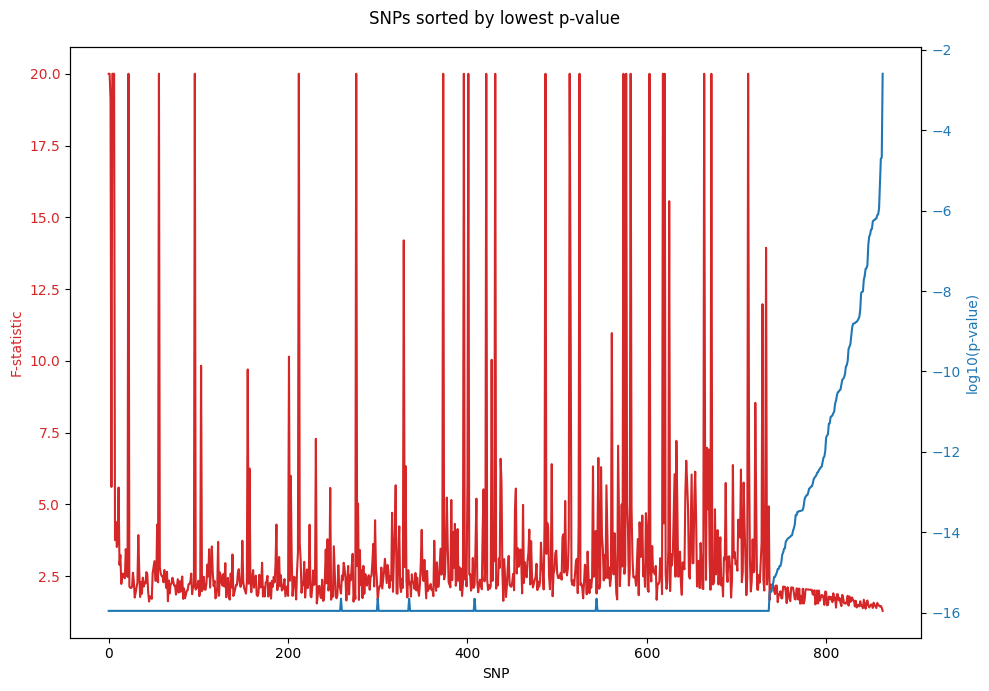

In [29]:
del D_50

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_100 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18")
D_100.filtering()
D_100.training(z_dim = np.ceil(864 / 100).astype(int))
D_100.clustering(algorithm = "leiden_full")
D_100.phylogeny()

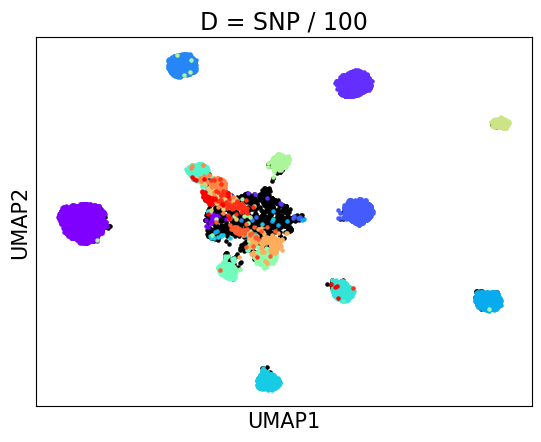

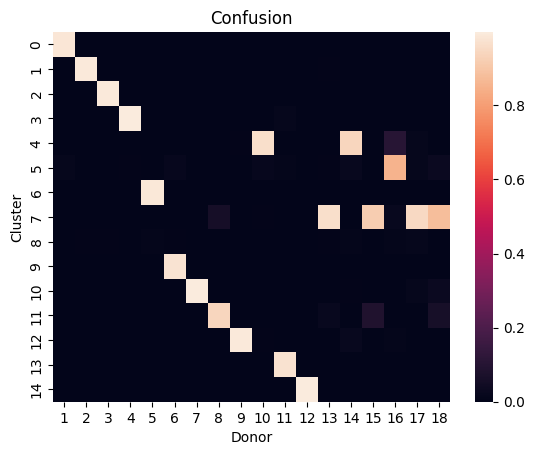

accuracy: 96.10123362238502
silhouette score: 0.7523801328156181


In [30]:
D_100_embedding_2d = D_100.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[D_100.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[D_100.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_100.embedding_2d[donors[18], 0], D_100.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(D_100.embedding_2d[donors[w], 0], D_100.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 100", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = D_100.assigned_label
    
matrix = np.zeros((18, D_100.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(D_100.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(D_100.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_100.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


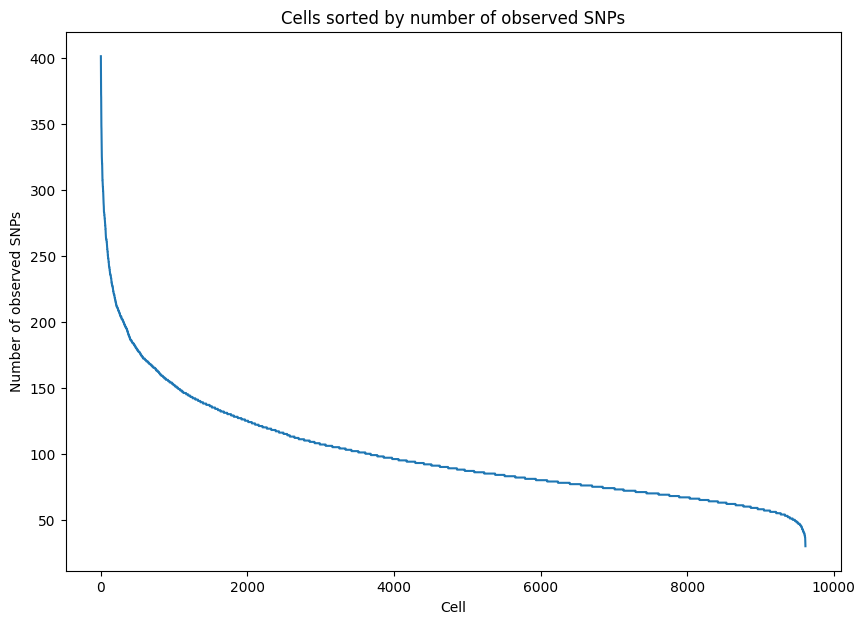

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


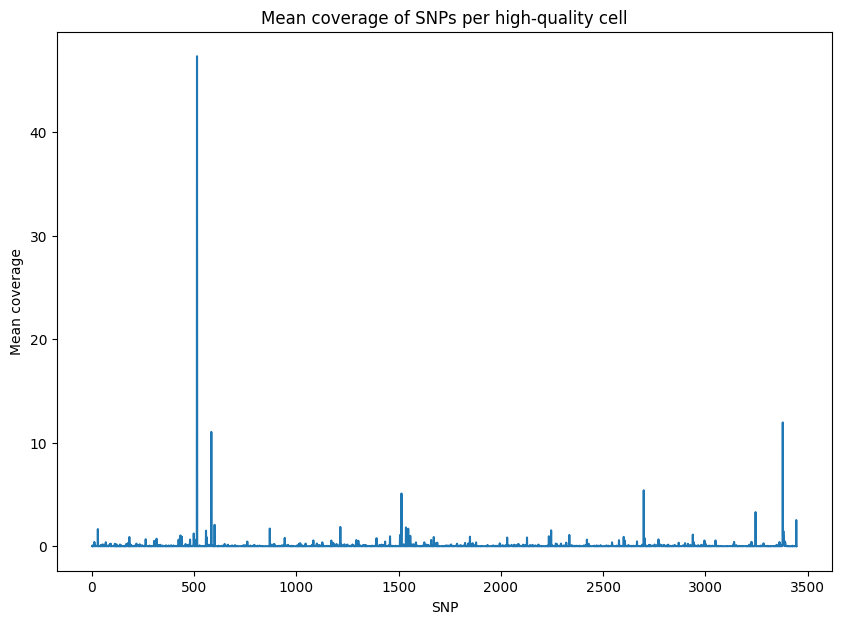

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


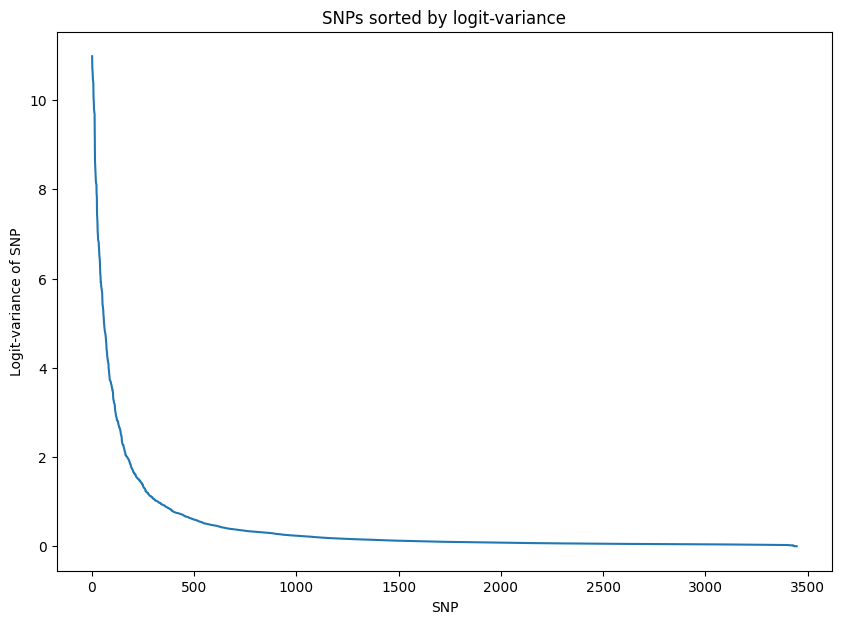

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.117833
Epoch[20/2000], Cost: 0.938285
Epoch[30/2000], Cost: 0.828399
Epoch[40/2000], Cost: 0.749382
Epoch[50/2000], Cost: 0.689599
Epoch[60/2000], Cost: 0.642904
Epoch[70/2000], Cost: 0.604794
Epoch[80/2000], Cost: 0.572914
Epoch[90/2000], Cost: 0.546149
Epoch[100/2000], Cost: 0.522600
Epoch[200/2000], Cost: 0.398453
Epoch[300/2000], Cost: 0.359614
Epoch[400/2000], Cost: 0.345484
Epoch[500/2000], Cost: 0.339384
Epoch[600/2000], Cost: 0.336421
Epoch[700/2000], Cost: 0.334807
Epoch[800/2000], Cost: 0.333827
Epoch[900/2000], Cost: 0.333224
Epoch[1000/2000], Cost: 0.332911
Epoch[1100/2000], Cost: 0.332594
Epoch[1200/2000], Cost: 0.332393
Epoch[1300/2000], Cost: 0.332262
Epoch[1400/2000], Cost: 0.332179
Epoch[1500/2000], Cost: 0.332056
Epoch[1600/200

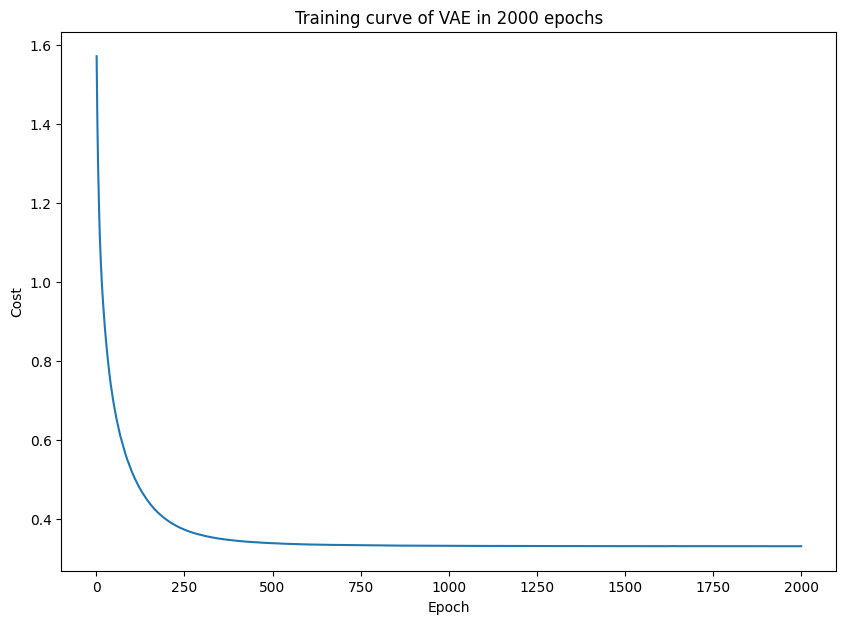

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


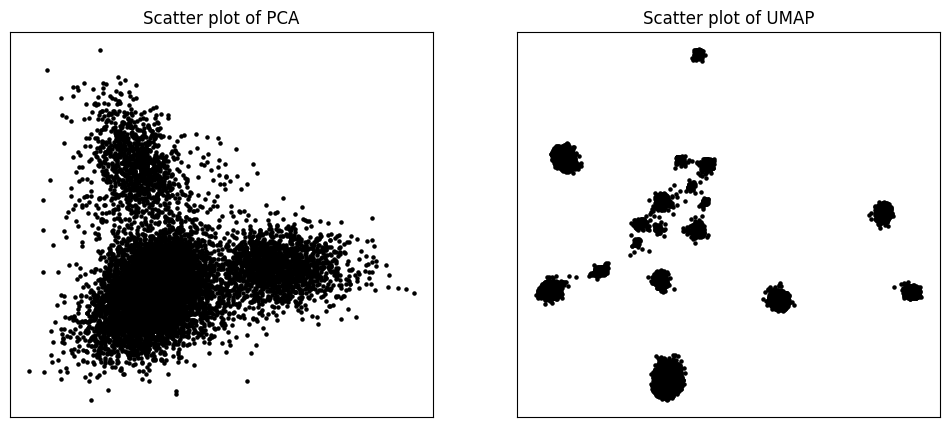

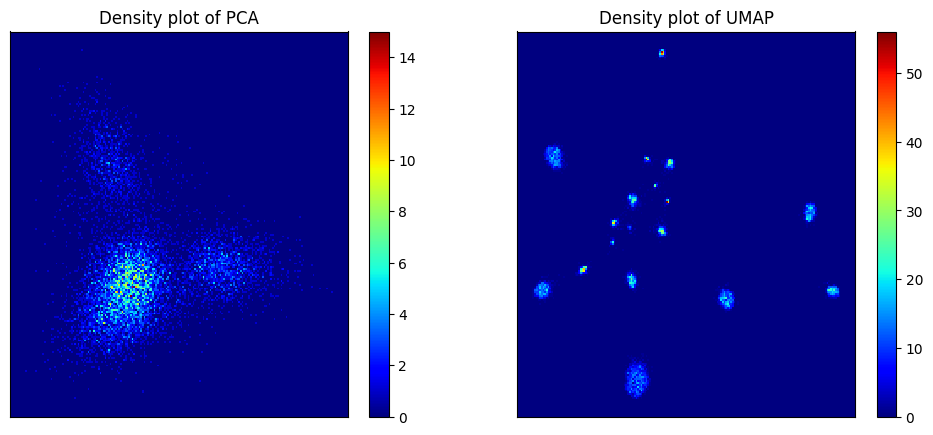

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


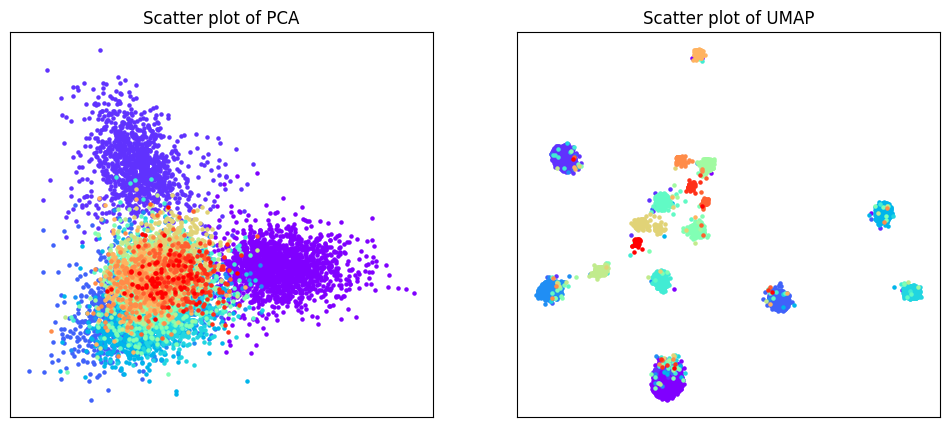

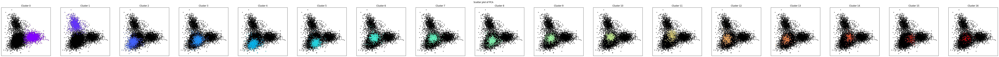

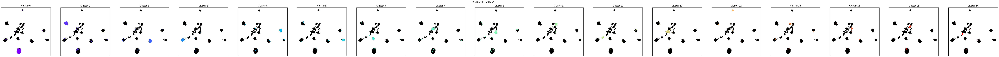

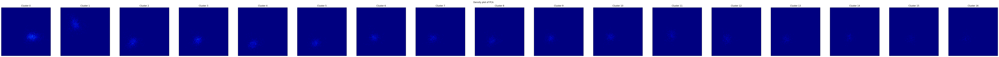

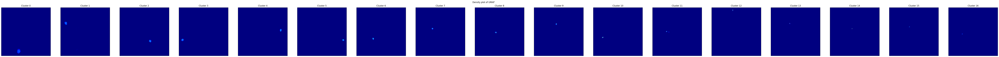

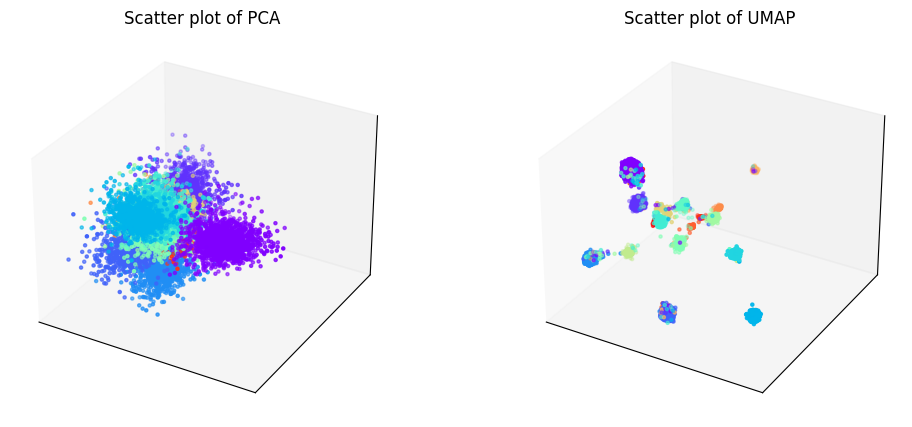

Phylogenetic tree in latent space will be shown below.


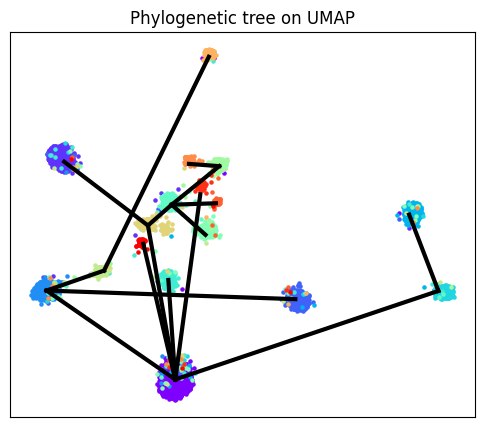

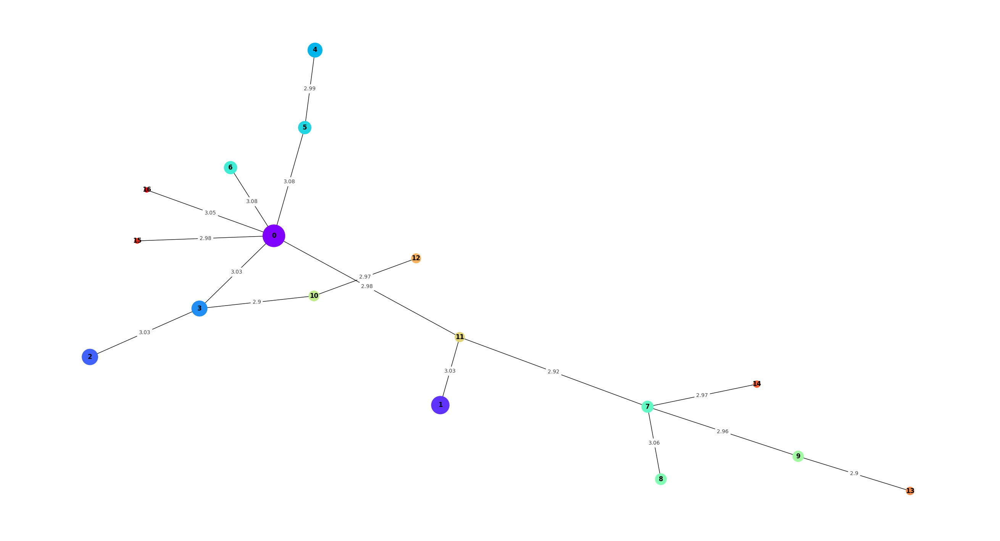

/tmp/ipykernel_1811049/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


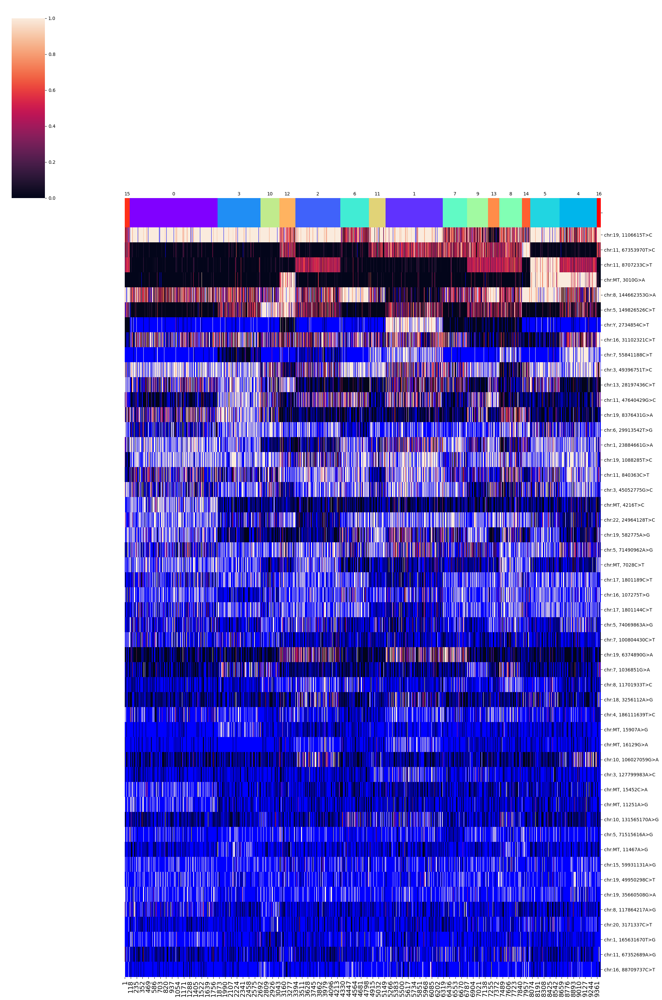

SNPs sorted by lowest p-value will be shown below


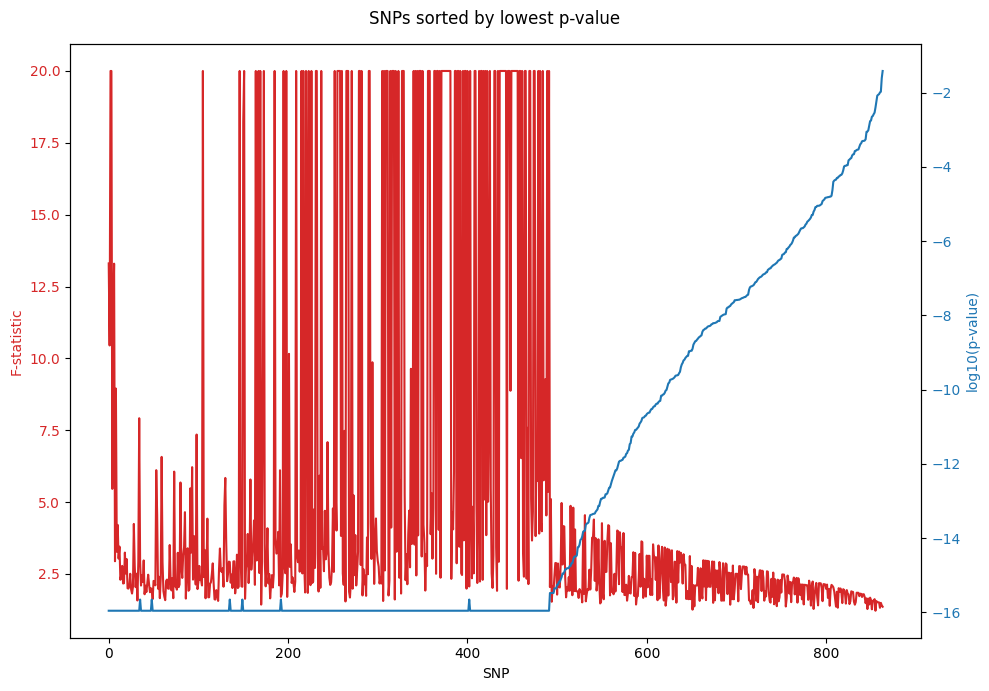

In [31]:
del D_100

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

unnormalized = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18", SNPread = 'unnormalized')
unnormalized.filtering()
unnormalized.training()
unnormalized.clustering(algorithm = "leiden_full")
unnormalized.phylogeny()

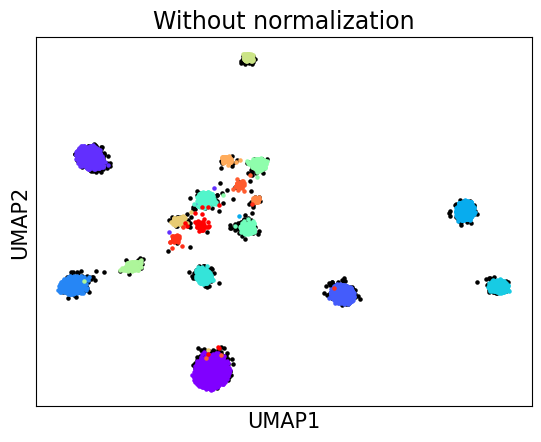

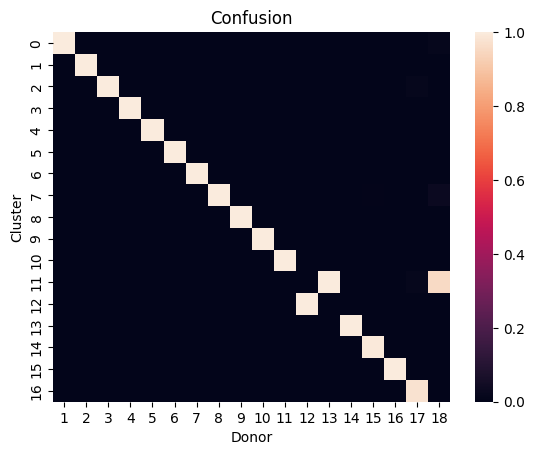

accuracy: 99.5057014941922
silhouette score: 0.8518958873696246


In [32]:
unnormalized_embedding_2d = unnormalized.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[unnormalized.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[unnormalized.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(unnormalized.embedding_2d[donors[18], 0], unnormalized.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(unnormalized.embedding_2d[donors[w], 0], unnormalized.embedding_2d[donors[w], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("Without normalization", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = unnormalized.assigned_label
    
matrix = np.zeros((18, unnormalized.cluster_no))
ref_sum = np.zeros(18)

for q in range(sum(unnormalized.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = np.arange(unnormalized.cluster_no))
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

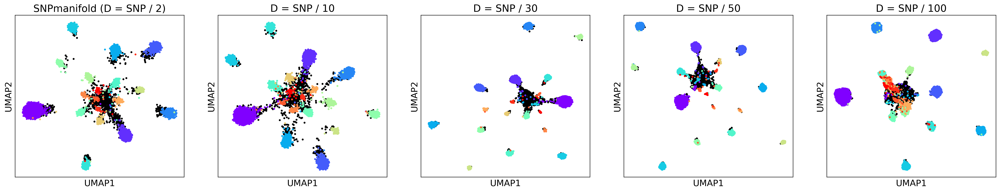

In [33]:
fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[18], 0], normalized_layer1_embedding_2d[donors[18], 1], s = 5, color = "black")
    
for t in range(18):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (D = SNP / 2)", fontsize = 17)

axs[1].scatter(D_10_embedding_2d[donors[18], 0], D_10_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[1].scatter(D_10_embedding_2d[donors[t], 0], D_10_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("D = SNP / 10", fontsize = 17)

axs[2].scatter(D_30_embedding_2d[donors[18], 0], D_30_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[2].scatter(D_30_embedding_2d[donors[t], 0], D_30_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("D = SNP / 30", fontsize = 17)

axs[3].scatter(D_50_embedding_2d[donors[18], 0], D_50_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[3].scatter(D_50_embedding_2d[donors[t], 0], D_50_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("D = SNP / 50", fontsize = 17)

axs[4].scatter(D_100_embedding_2d[donors[18], 0], D_100_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[4].scatter(D_100_embedding_2d[donors[t], 0], D_100_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)
axs[4].set_title("D = SNP / 100", fontsize = 17)
    
plt.show()

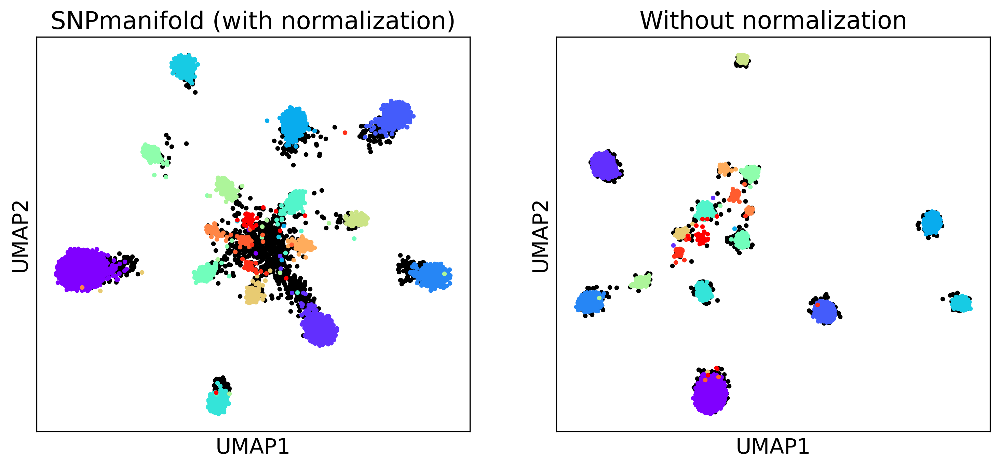

In [34]:
fig, axs = plt.subplots(1, 2, dpi = 300)
fig.set_size_inches(12, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[18], 0], normalized_layer1_embedding_2d[donors[18], 1], s = 5, color = "black")
    
for t in range(18):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (with normalization)", fontsize = 17)

axs[1].scatter(unnormalized_embedding_2d[donors[18], 0], unnormalized_embedding_2d[donors[18], 1], s = 5, color = "black")

for t in range(18):
    
    axs[1].scatter(unnormalized_embedding_2d[donors[t], 0], unnormalized_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 18))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("Without normalization", fontsize = 17)
    
plt.show()

/ssd/users/kevin/conda/test_SNPmanifold/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


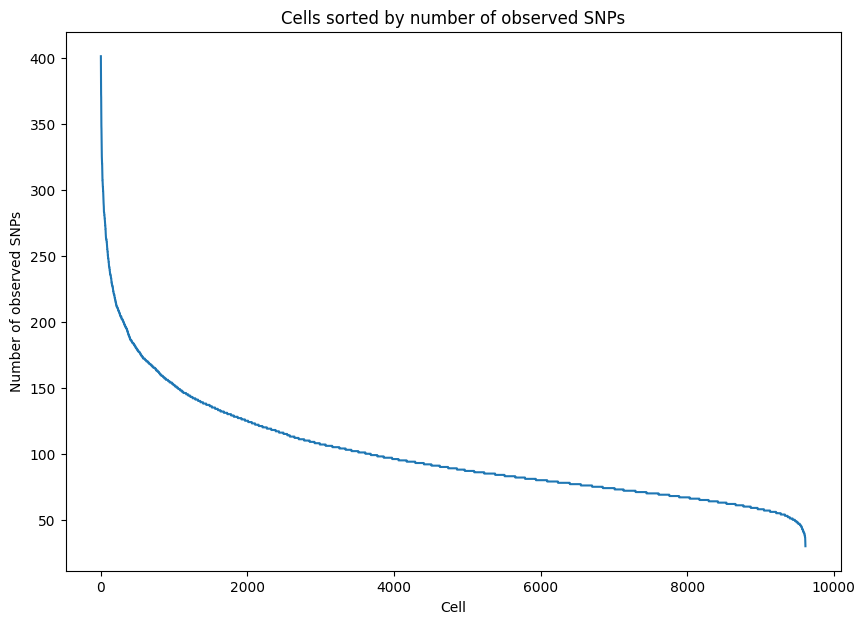

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


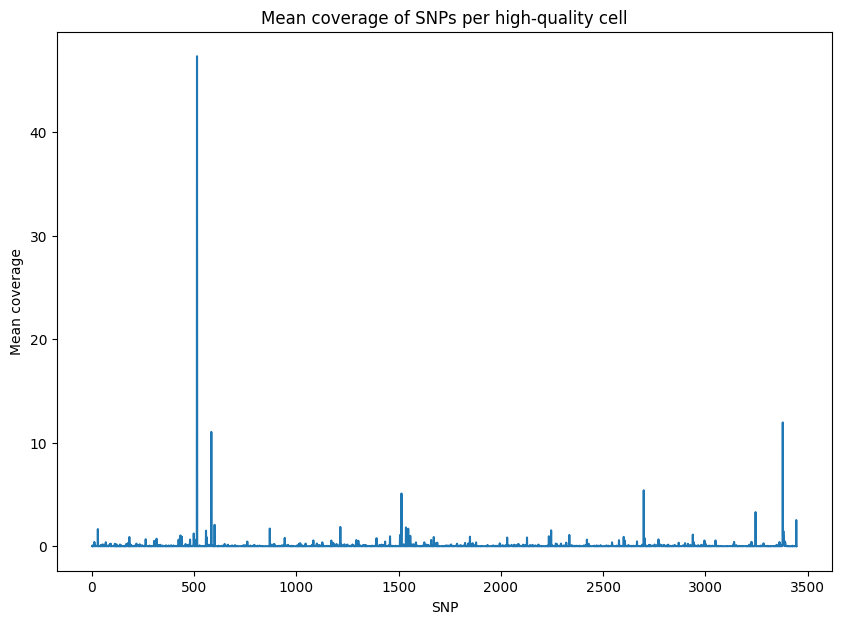

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


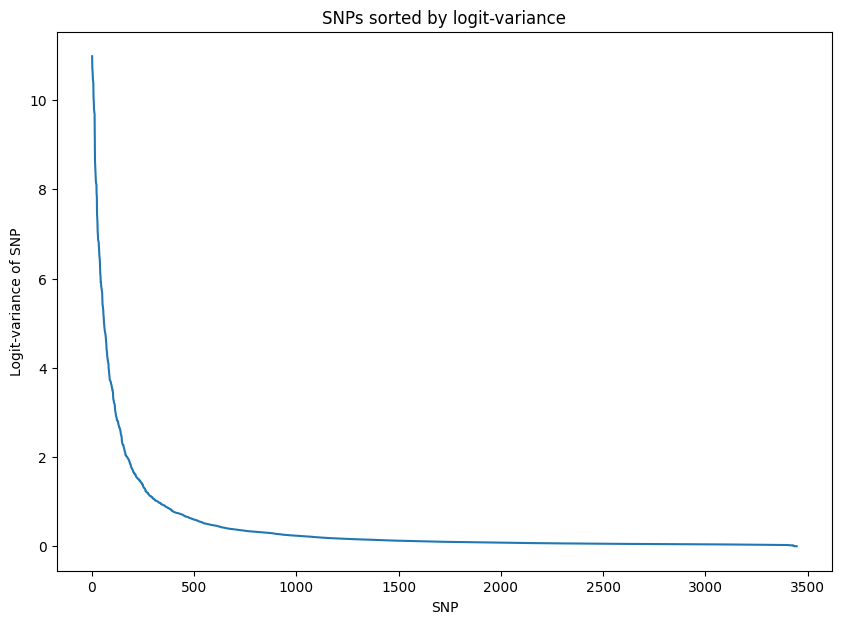

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 9436 cells and 864 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.102322
Epoch[20/2000], Cost: 0.912674
Epoch[30/2000], Cost: 0.806191
Epoch[40/2000], Cost: 0.730411
Epoch[50/2000], Cost: 0.674796
Epoch[60/2000], Cost: 0.633045
Epoch[70/2000], Cost: 0.599187
Epoch[80/2000], Cost: 0.571385
Epoch[90/2000], Cost: 0.548163
Epoch[100/2000], Cost: 0.527341
Epoch[200/2000], Cost: 0.415383
Epoch[300/2000], Cost: 0.373807
Epoch[400/2000], Cost: 0.356137
Epoch[500/2000], Cost: 0.347645
Epoch[600/2000], Cost: 0.343135
Epoch[700/2000], Cost: 0.340517
Epoch[800/2000], Cost: 0.339007
Epoch[900/2000], Cost: 0.338013
Epoch[1000/2000], Cost: 0.337379
Epoch[1100/2000], Cost: 0.336950
Epoch[1200/2000], Cost: 0.336637
Epoch[1300/2000], Cost: 0.336405
Epoch[1400/2000], Cost: 0.336242
Epoch[1500/2000], Cost: 0.336135
Epoch[1600/200

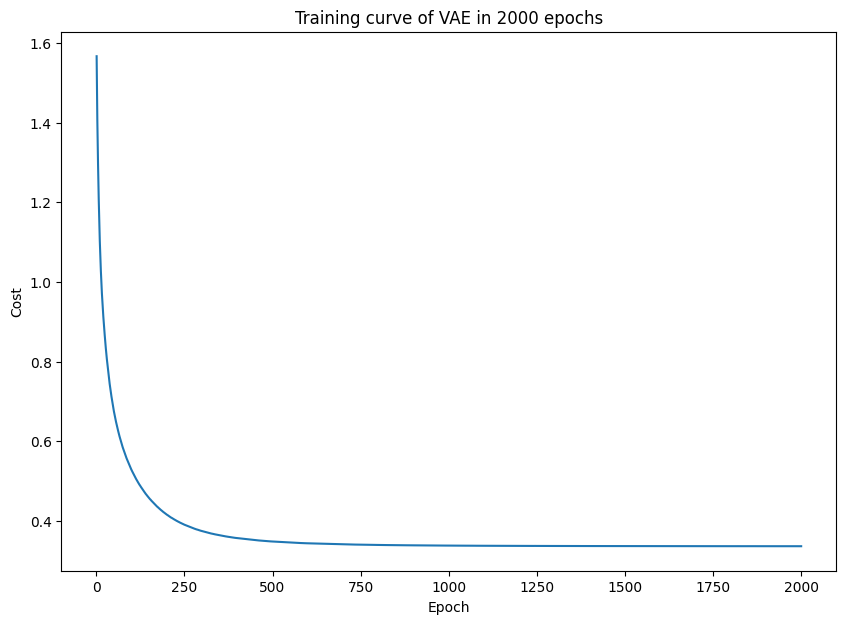

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


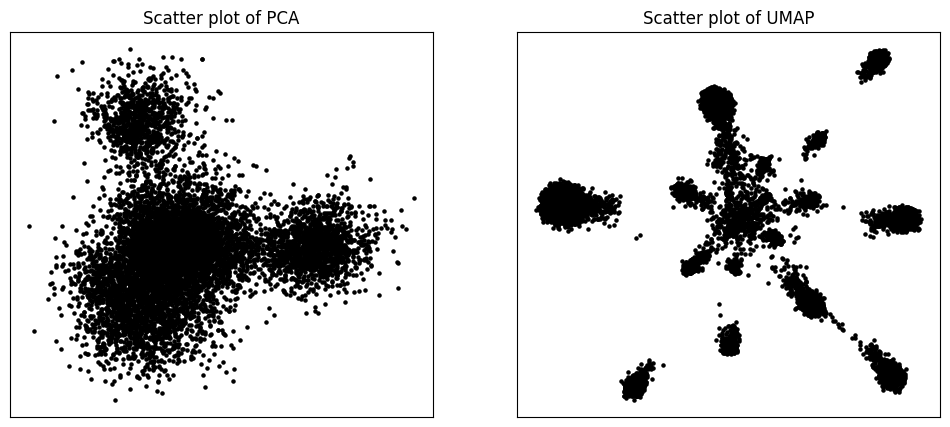

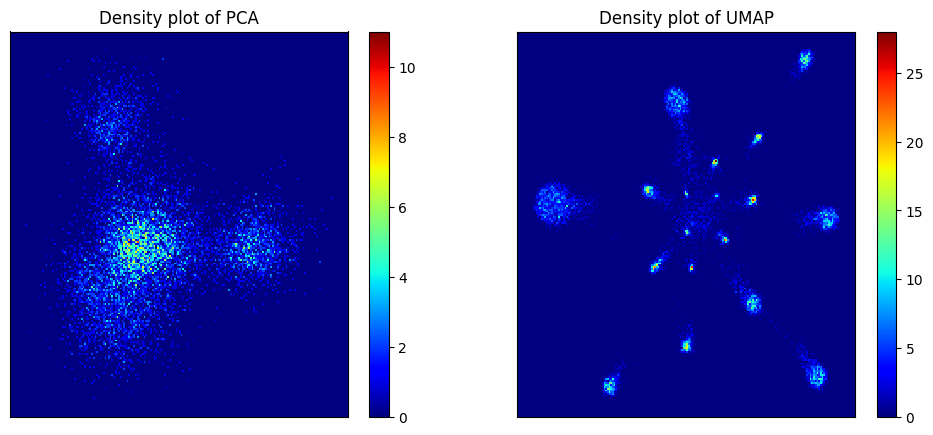

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


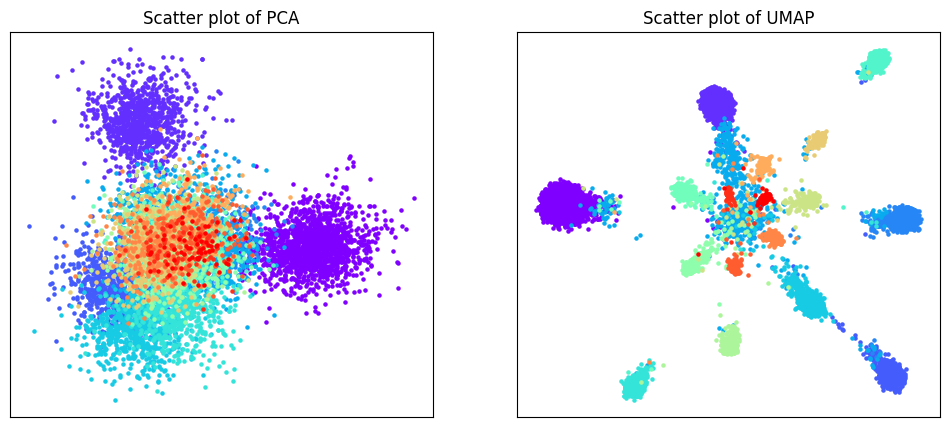

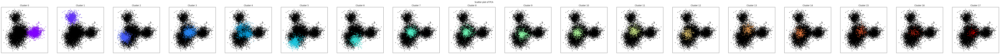

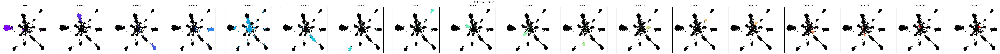

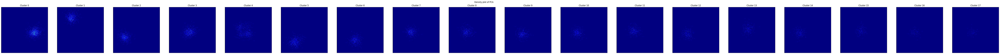

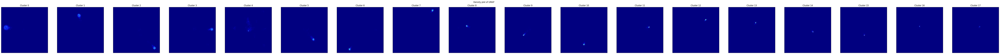

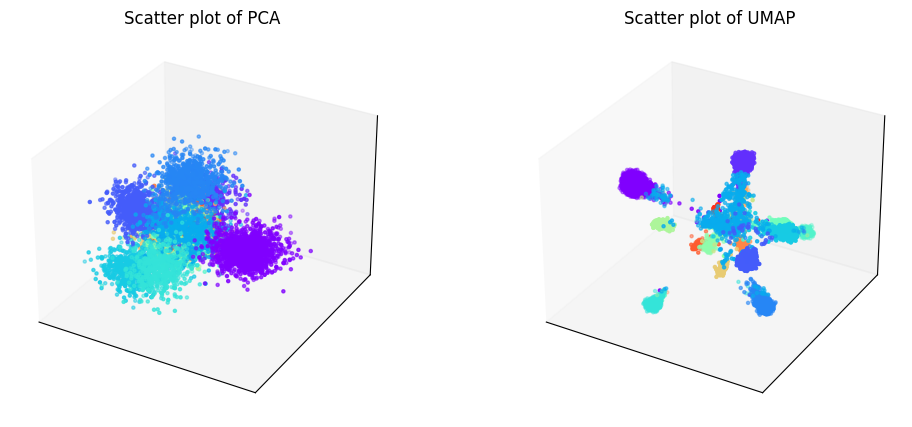

Phylogenetic tree in latent space will be shown below.


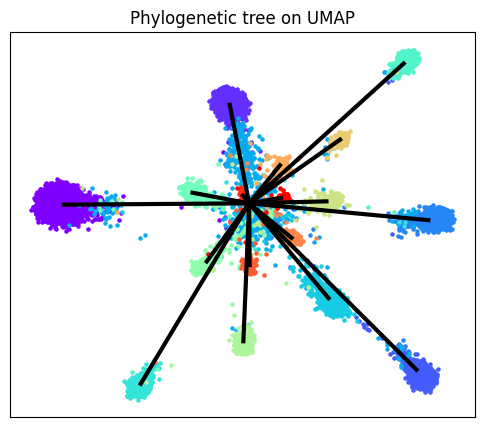

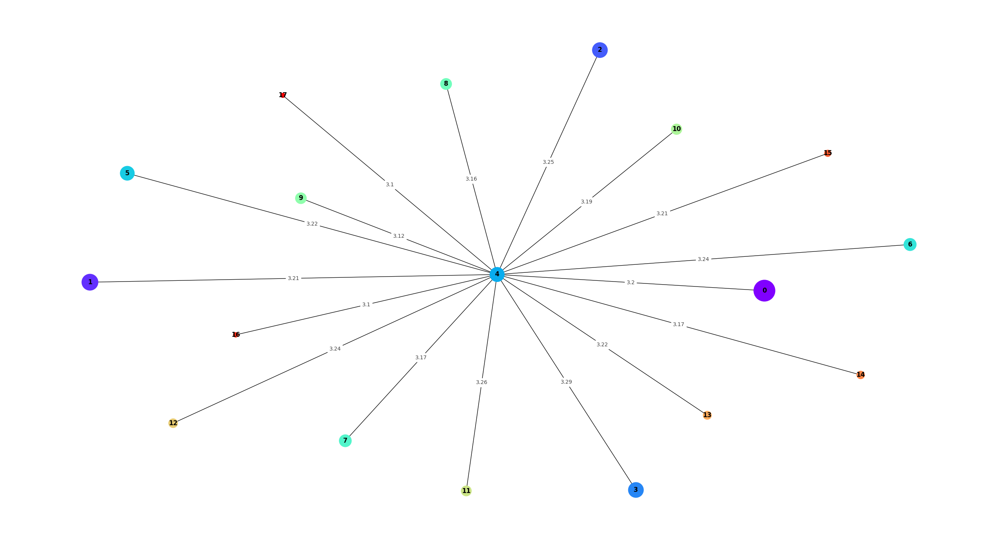

/tmp/ipykernel_167876/2299804736.py:261: RuntimeWarning: divide by zero encountered in true_divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 9436 cells and 50 SNPs will be shown below.


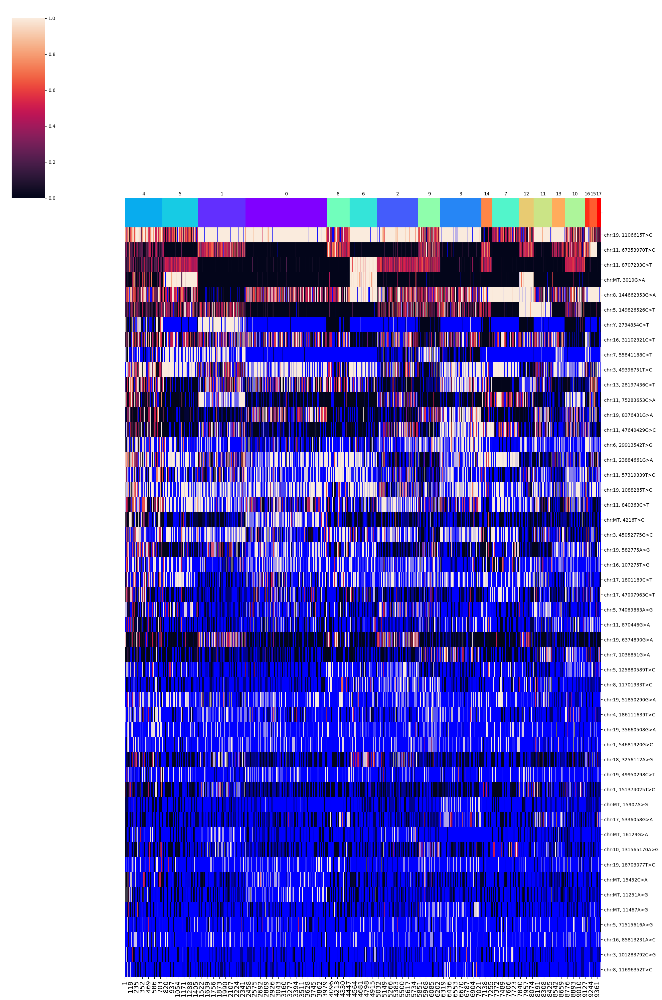

SNPs sorted by lowest p-value will be shown below


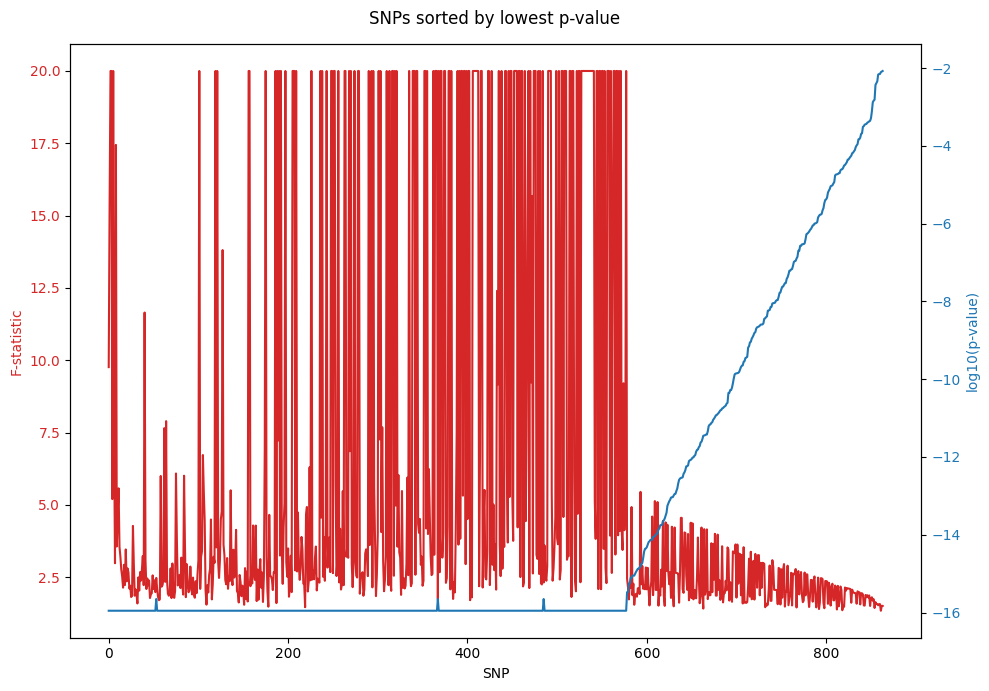

In [1]:
import torch
torch.set_default_device('cuda')
torch.cuda.set_device('cuda:6')

%run /home/kevin/storage_kevin/past_figures/figures_final7/notebook/SNPmanifold.ipynb

normalized_layer1 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18")
normalized_layer1.filtering()
normalized_layer1.training()
normalized_layer1.clustering(algorithm = "leiden_full")
normalized_layer1.phylogeny()

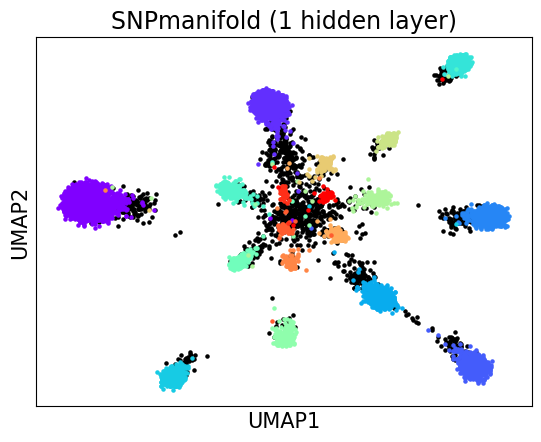

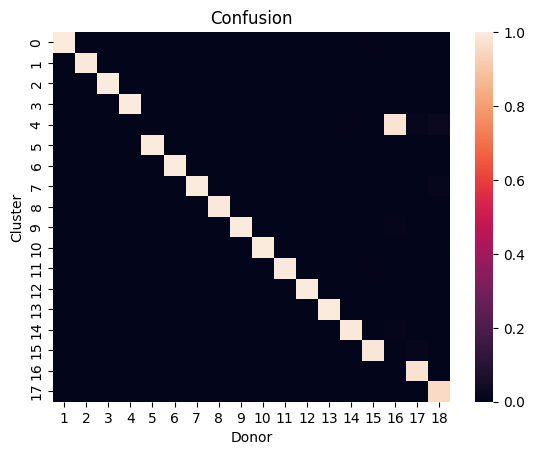

accuracy: 99.18681488026738
silhouette score: 0.8384226358079296


In [2]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(normalized_layer1.embedding_2d[donors[18], 0], normalized_layer1.embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(normalized_layer1.embedding_2d[donors[w], 0], normalized_layer1.embedding_2d[donors[w], 1], s = 5, color = normalized_layer1.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = normalized_layer1.assigned_label
    
matrix = np.zeros((18, 18))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(normalized_layer1.pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

In [3]:
binary_mutation = np.zeros(normalized_layer1.AF_filtered.cpu().numpy().astype(int).shape).astype(int)
binary_mutation[normalized_layer1.AF_filtered.cpu().numpy().astype(int) >= 0.5] = 1
binary_mutation[normalized_layer1.DP_filtered.astype(int) == 0] = 3
binary_mutation

array([[3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 0, 3],
       ...,
       [3, 3, 3, ..., 3, 1, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3]])

In [5]:
pd.DataFrame(binary_mutation).to_csv(('bmvae/binary_mutation_donor18.tsv'), sep = '\t', header = False, index = None)

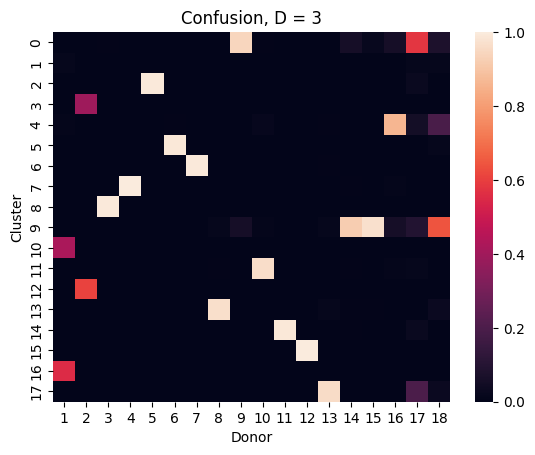

accuracy: 88.5063654300692


In [22]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

reference = df_vireo_yes.astype(int)
predict = pd.read_csv('bmvae/D_3/labels.txt', header = None).to_numpy()[0].astype(int)
    
matrix = np.zeros((18, 18))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion, D = 3")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

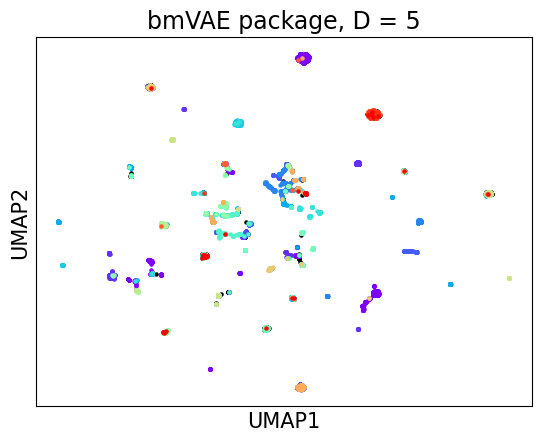

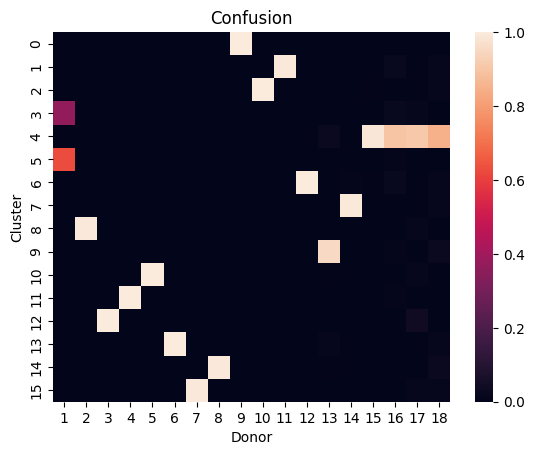

accuracy: 95.44439423348341
silhouette score: 0.15196502894882832


In [27]:
embedding_full = np.genfromtxt('bmvae/D_5/embedding.txt', delimiter = ',')

reducer_2d = umap.UMAP(n_components = 2)
embedding_2d = reducer_2d.fit_transform(embedding_full)
pair_embedding_full = squareform(pdist(embedding_full))

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(embedding_2d[donors[18], 0], embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(embedding_2d[donors[w], 0], embedding_2d[donors[w], 1], s = 5, color = normalized_layer1.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("bmVAE package, D = 5", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = pd.read_csv('bmvae/D_5/labels.txt', header = None).to_numpy()[0].astype(int)
    
matrix = np.zeros((18, 16))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(pair_embedding_full[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

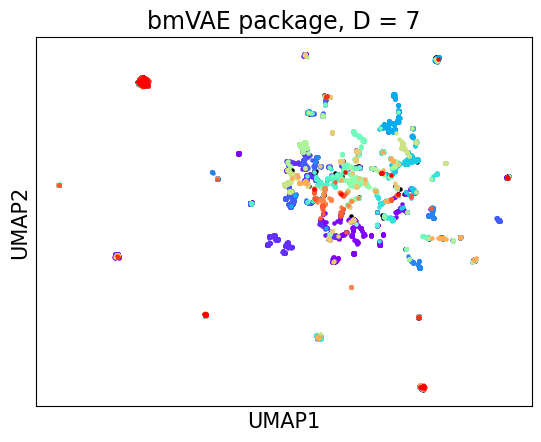

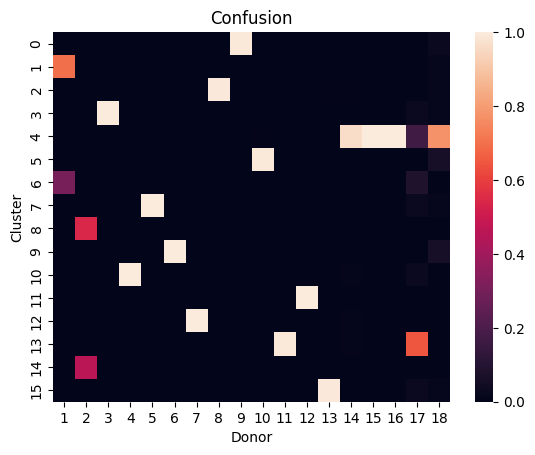

accuracy: 92.11026968454432
silhouette score: 0.026918767600525445


In [28]:
embedding_full = np.genfromtxt('bmvae/D_7/embedding.txt', delimiter = ',')

reducer_2d = umap.UMAP(n_components = 2)
embedding_2d = reducer_2d.fit_transform(embedding_full)
pair_embedding_full = squareform(pdist(embedding_full))

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(embedding_2d[donors[18], 0], embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(embedding_2d[donors[w], 0], embedding_2d[donors[w], 1], s = 5, color = normalized_layer1.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("bmVAE package, D = 7", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = pd.read_csv('bmvae/D_7/labels.txt', header = None).to_numpy()[0].astype(int)
    
matrix = np.zeros((18, 16))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(pair_embedding_full[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')

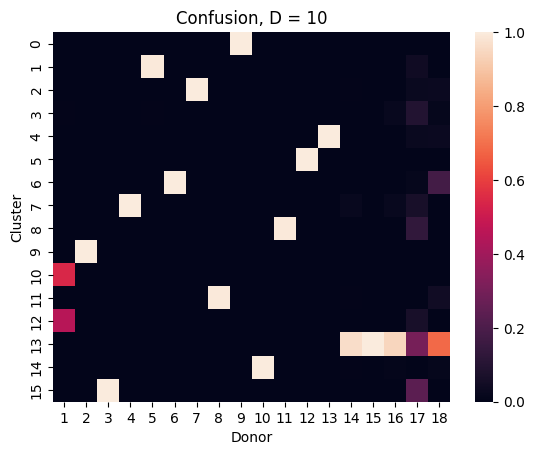

accuracy: 91.14560778631271


In [21]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

reference = df_vireo_yes.astype(int)
predict = pd.read_csv('bmvae/D_10/labels.txt', header = None).to_numpy()[0].astype(int)
    
matrix = np.zeros((18, 16))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion, D = 10")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

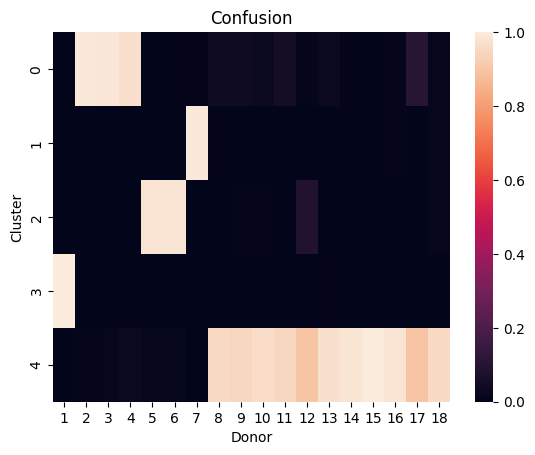

accuracy: 96.61353337970941


In [10]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

reference = df_vireo_yes.astype(int)
predict = pd.read_csv('bmvae/D_50/labels.txt', header = None).to_numpy()[0].astype(int)
    
matrix = np.zeros((18, 5))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

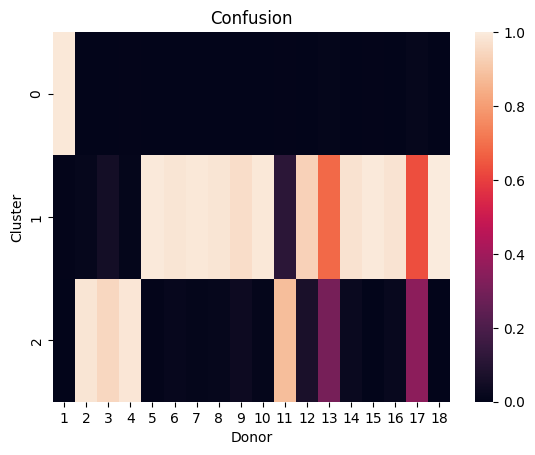

accuracy: 93.81011175852623


In [12]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final7/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

reference = df_vireo_yes.astype(int)
predict = pd.read_csv('bmvae/D_87/labels.txt', header = None).to_numpy()[0].astype(int)
    
matrix = np.zeros((18, 3))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

In [14]:
import copy

SNPmanifold_umap = copy.deepcopy(normalized_layer1)

reducer_2d = umap.UMAP(n_components = 2)
embedding_2d = reducer_2d.fit_transform(SNPmanifold_umap.AF_filtered.cpu().numpy())
pair_embedding_2d = squareform(pdist(embedding_2d))

reducer_3d = umap.UMAP(n_components = 3)
embedding_3d = reducer_3d.fit_transform(SNPmanifold_umap.AF_filtered.cpu().numpy())
pair_embedding_3d = squareform(pdist(embedding_3d))

adata_latent = ad.AnnData(embedding_3d)
        
sc.tl.pca(adata_latent, svd_solver = "arpack")
sc.pp.neighbors(adata_latent)
sc.tl.leiden(adata_latent, resolution = 1)

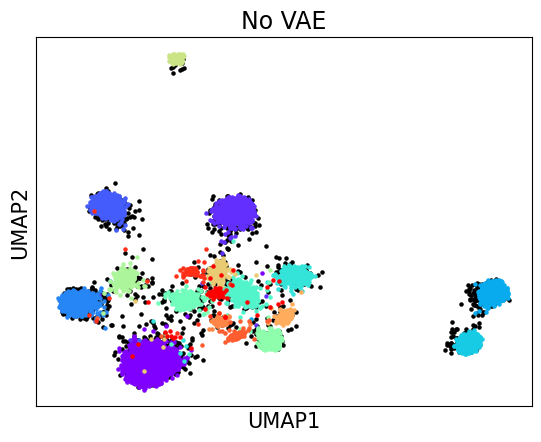

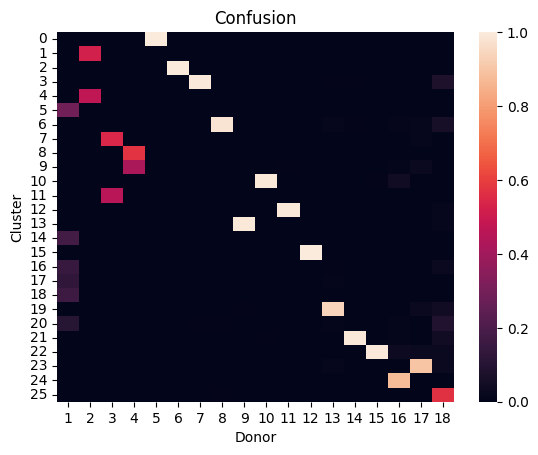

accuracy: 84.02429925081627
silhouette score: 0.7286875146816314


In [20]:
df_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/id_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet_vireo_yes = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor18/doublet_vireo_yes.csv', delimiter = ',')[normalized_layer1.cell_filter]
df_vireo_yes[doublet_vireo_yes == 1] = 18

donors = []

for h in range(19):
    
    donors.append(np.where(df_vireo_yes == h)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(embedding_2d[donors[18], 0], embedding_2d[donors[18], 1], s = 5, color = "black")

for w in range(18):
    
    axs.scatter(embedding_2d[donors[w], 0], embedding_2d[donors[w], 1], s = 5, color = normalized_layer1.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("No VAE", fontsize = 17)

plt.show()

reference = df_vireo_yes.astype(int)
predict = np.array(adata_latent.obs["leiden"].to_numpy(), dtype = int)
    
matrix = np.zeros((18, 26))
ref_sum = np.zeros(18)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 17:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop[:, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]].T, xticklabels = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(pair_embedding_3d[reference <= 17, :][:, reference <= 17], reference[reference <= 17], metric = "precomputed")}')